# Notebook to analyse porous clots

## Initiation

In [1]:
import copy
import os
import random
import contextlib
import matplotlib.colors
import sys
from vtk.util.numpy_support import vtk_to_numpy
import vtk
from scipy.interpolate import griddata
import pandas as pd
from matplotlib import cm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.ticker as mticker
import networkx as nx
import numpy as np
import pathos.multiprocessing
import pyacvd
import pyvista
import scipy.spatial
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
sys.path.append("/home/raymond/Desktop/1d-blood-flow/")
from Blood_Flow_1D import *
from scipy import integrate,interpolate
from IPython.display import Image

## Folder creation

In [2]:
# input folder
mainfolder = ""

Folder = mainfolder + "Simulations/"

# store figures in results folder
OutputFolder = mainfolder+"results/"
try:
    os.mkdir(OutputFolder)
except OSError:
    print("Creation of the directory %s failed" % OutputFolder)
else:
    print("Successfully created the directory %s " % OutputFolder)

Creation of the directory results/ failed


# Simulations

## import simulation data

### Find folders and load data

In [3]:
Simulations = [Folder+f for f in os.listdir(Folder) if os.path.isdir(os.path.join(Folder,f)) and ".ipynb_checkpoints" not in f and "results" not in f]
Simulations

['Simulations/longMCA-R. MCA (24mm)-Collaterals(0.25)',
 'Simulations/longMCA-R. MCA (21mm)-Collaterals(0.25)',
 'Simulations/longMCA-R. MCA (15mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (9mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (18mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (12mm)-Collaterals(0.65)',
 'Simulations/longMCA-R. MCA (28mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (21mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (12mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (21mm)-Collaterals(0.65)',
 'Simulations/longMCA-R. MCA (12mm)-Collaterals(0.05)',
 'Simulations/longMCA-R. MCA (28mm)-Collaterals(0.25)',
 'Simulations/longMCA-R. MCA (6mm)-Collaterals(0.65)',
 'Simulations/longMCA-R. MCA (24mm)-Collaterals(0.5)',
 'Simulations/longMCA-R. MCA (15mm)-Collaterals(0.05)',
 'Simulations/longMCA-R. MCA (6mm)-Collaterals(0.05)',
 'Simulations/longMCA-R. MCA (18mm)-Collaterals(0.65)',
 'Simulations/longMCA-R. MCA (15mm)-Collaterals(0.25)',
 '

In [4]:
frames = []
patientobjects = []

for sim in Simulations:
    path = sim + "/bf_sim/Clot_Permeability.csv"
    df = pd.read_csv(path, sep=',',header=0)
    df = df.replace([np.inf, -np.inf], np.nan)
    
    df["Folder"] = sim.split("/")[-1]
    df["Clot Length"] = float(sim.split("(")[-2].split("mm")[0])
    df["Collaterals"] = float(sim.split("(")[-1].split(")")[0])
    
    frames.append(df)    
result = pd.concat(frames)
display(result)

,Time [s],Pressure drop [pa],Time delay [s],Time delay bifurcation [s],Permeability [mm^2],Flow rate [mL/s],Velocity inside clot [m/s],Cerebral flow rate [mL/s],Infarct volume[mL],Folder,Clot Length,Collaterals
0,-1.0,317.355097,0,0,0.000000e+00,2.263408e+00,3.515496e-01,"1.1147113347588613,2.3713775106880886,2.161134...","0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (24mm)-Collaterals(0.25),24.0,0.25
1,0.0,9271.099102,0,0,0.000000e+00,1.892061e-24,1.472595e-24,"1.114629975729493,1.6516885737199771,2.1611319...","0.0,128.11297098663016,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (24mm)-Collaterals(0.25),24.0,0.25
2,1.0,9270.942325,0,0,1.000000e-07,7.090324e-05,5.518412e-05,"1.1146763433929663,1.65172195791803,2.16114637...","0.0,128.11297098663016,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (24mm)-Collaterals(0.25),24.0,0.25
3,2.0,9270.862415,0,0,1.496236e-07,1.060870e-04,8.256769e-05,"1.1146980101235204,1.6517385446637292,2.161153...","0.0,128.11297098663016,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (24mm)-Collaterals(0.25),24.0,0.25
4,3.0,9270.736350,0,0,2.238721e-07,1.587288e-04,1.235389e-04,"1.1147087729418332,1.651773557843994,2.1611569...","0.0,128.11297098663016,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (24mm)-Collaterals(0.25),24.0,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...
38,37.0,347.759436,0,0,1.995262e-01,2.248636e+00,1.750117e+00,"1.1147953464793032,2.371521017310603,2.1611776...","0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (18mm)-Collaterals(0.25),18.0,0.25
39,38.0,312.065410,0,0,2.985383e-01,2.255577e+00,1.755520e+00,"1.1148078533288555,2.3715464129210457,2.161181...","0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (18mm)-Collaterals(0.25),18.0,0.25
40,39.0,288.081303,0,0,4.466836e-01,2.260200e+00,1.759118e+00,"1.1147912235029531,2.3715152019999226,2.161174...","0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (18mm)-Collaterals(0.25),18.0,0.25
41,40.0,272.001512,0,0,6.683439e-01,2.263340e+00,1.761561e+00,"1.1148025689931362,2.37154126237552,2.16117793...","0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0",longMCA-R. MCA (18mm)-Collaterals(0.25),18.0,0.25


In [5]:
result["Type"]="Stroke"
result.loc[result['Time [s]']==-1.0,"Type"]="Healthy"

### Detect flow direction

In [6]:
# # retro grade flow
# # flow reversal after the clot
# data = []
# for sim in Simulations:
#     path = sim + "/bf_sim/mean_results/"
#     resfiles = [path+f for f in os.listdir(path)]
#     flow_direction = []
#     for file in resfiles:
#         file_number = float(file.split("PerVessel_")[-1].split(".csv")[0])
        
#         df = pd.read_csv(file, sep=',',header=0)
#         f0 = df.loc[df['VesselName']=="R. MCA"]["VolumeFlowrate(mL/s)"].item()
#         f1 = df.loc[df['VesselName']=="R. MCA, gen:1,1"]["VolumeFlowrate(mL/s)"].item()
#         f2 = df.loc[df['VesselName']=="R. MCA, gen:1,0"]["VolumeFlowrate(mL/s)"].item()

#         if abs(abs(f0)-(abs(f1)+abs(f2)))<1e-4:
#             flow_direction.append((file_number,"Antero"))
#             data.append((sim.split("/")[-1],file_number,"Antero"))
#         else:
#             flow_direction.append((file_number,"Retro"))
#             data.append((sim.split("/")[-1],file_number,"Retro"))

# dataframe = pd.DataFrame(data, columns=['Simulation', 'FileNumber', 'Direction'])
# display(dataframe)

# # find max retro grade simulation
# df_max = dataframe.loc[dataframe['Direction']=="Retro"].groupby('Simulation').max()
# df_max
# # note:if fileNumber is 1 or max, no reversal in graph

# # note: collaterals do not seem to matter much.
# # double the clot length-> double the permeability needed
# # likely cause is therefore the resistance of the clot (more specifically, the pressure drop caused by it)

## Calculate time delay: dt

In [7]:
result['Time delay [s]']=result['Clot Length']*1e-3/result["Velocity inside clot [m/s]"]
# set time delay to nan for complete blockages
result.loc[result['Time [s]']==0.0,"Time delay [s]"]=np.nan

## Calculate clot resistance: R

In [8]:
result['Clot resistance']= result['Pressure drop [pa]']/(result['Flow rate [mL/s]']*1e-6)
# result['Clot resistance Calculation']= result['Pressure drop [pa]']/(result['Flow rate [mL/s]']*1e-6)
# calculate based on permeability!
# length, radius, permeability etc
# bloodvisc= 0.0035
# area = 3.14*1.43*1.43
# radius=1.43
# R=(22 * bloodvisc * result['Clot Length'])/(1e-9 * (np.pi * np.power(radius, 4)))

# result['Clot resistance']= R+(bloodvisc * result['Clot Length'])/ (1e-9 * result["Permeability [mm^2]"] * area)
# result['Clot resistance Calculation']= R+(bloodvisc * result['Clot Length'])/ (1e-9 * result["Permeability [mm^2]"] * area)

## Calculate Power

In [9]:
result['Power']= result['Pressure drop [pa]']*(result['Flow rate [mL/s]']*1e-6)
# print(result['Clot resistance'][(result['Power']).idxmax()])

## Calculate collateral flow and split regions

In [10]:
regions = ["R. ACA","R. MCA","L. MCA", "L. ACA","R. PCA","L. PCA","Cerebellum","Brainstem"]

split_regions = result['Cerebral flow rate [mL/s]'].str.split(',', expand=True)
for index, region in enumerate(regions):
    result[region] = split_regions[index].astype(float)

In [11]:
result['Collateral flow'] = result['R. MCA'] - result['Flow rate [mL/s]']

## Infarct volume estimations

In [12]:
# import data first
brain_volume = 1390409  # mm^3
brain_volume_ml = brain_volume/1000
thresholds = np.linspace(0, 1.0, num=21)
infarcts = []

permeability_values = np.sort(result['Permeability [mm^2]'].unique())
    
for sim in Simulations:
    path = sim + "/bf_sim/Infarct.csv"
    myFile = np.genfromtxt(path, delimiter=',',skip_header=0)
    col = float(sim.split("(")[-1].split(")")[0])
#     length = float(sim.split("(")[-2].split("mm")[0])
  
    for t in thresholds:
        array_bool = np.where(myFile>t, 1, 0)
        
        # infarcted fraction        
        infarcted_fraction = np.sum(array_bool,axis = 1)/myFile.shape[1]
        
        # infarcted volume 
        infarcted_volume = brain_volume_ml * infarcted_fraction

        # add length as well?
        for index, perm in enumerate(permeability_values):
            infarcts.append((col,t,perm,infarcted_volume[index],sim.split("/")[-1]))              

In [13]:
infarct_df = pd.DataFrame(infarcts, columns =['Collaterals', 'Threshold', "Perm", 'Infarct',"Sim"])
infarct_df.to_csv(OutputFolder+"result_infarct.csv")
infarct_df

,Collaterals,Threshold,Perm,Infarct,Sim
0,0.25,0.0,0.000000e+00,1107.378934,longMCA-R. MCA (24mm)-Collaterals(0.25)
1,0.25,0.0,1.000000e-07,277.281094,longMCA-R. MCA (24mm)-Collaterals(0.25)
2,0.25,0.0,1.496236e-07,238.759320,longMCA-R. MCA (24mm)-Collaterals(0.25)
3,0.25,0.0,2.238721e-07,238.759320,longMCA-R. MCA (24mm)-Collaterals(0.25)
4,0.25,0.0,3.349654e-07,238.759320,longMCA-R. MCA (24mm)-Collaterals(0.25)
...,...,...,...,...,...
31747,0.25,1.0,1.995262e-01,0.000000,longMCA-R. MCA (18mm)-Collaterals(0.25)
31748,0.25,1.0,2.985383e-01,0.000000,longMCA-R. MCA (18mm)-Collaterals(0.25)
31749,0.25,1.0,4.466836e-01,0.000000,longMCA-R. MCA (18mm)-Collaterals(0.25)
31750,0.25,1.0,6.683439e-01,0.000000,longMCA-R. MCA (18mm)-Collaterals(0.25)


In [14]:
thresholds

array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ,
       0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  ])

In [15]:
# add infarct volume estimate to results (pick threshold to define infarct volume)
# infarct at 0.4?
infarct_threshold =thresholds[8] # 0.4
estimated_infract = infarct_df[infarct_df["Threshold"] == infarct_threshold]
estimated_infract.to_csv(OutputFolder+"result_infarct_estimate.csv")

# merge infarct volume with results
result["Infarct"] = result.apply(lambda row: estimated_infract.loc[(estimated_infract['Sim']==row['Folder'])&(estimated_infract['Perm']==row['Permeability [mm^2]'])]["Infarct"].values[0], axis=1)


## Export result.csv

In [16]:
del result['Time delay bifurcation [s]']   
del result['Cerebral flow rate [mL/s]']   

result.to_csv(OutputFolder+"result.csv")

## Plotting results

In [17]:
lengthoptions = np.sort(result['Clot Length'].unique())
display(lengthoptions)
collateraloptions = np.sort(result['Collaterals'].unique())
display(collateraloptions)

array([ 3.,  6.,  9., 12., 15., 18., 21., 24., 28.])

array([0.05, 0.25, 0.5 , 0.65])

### Plot Q as function of k

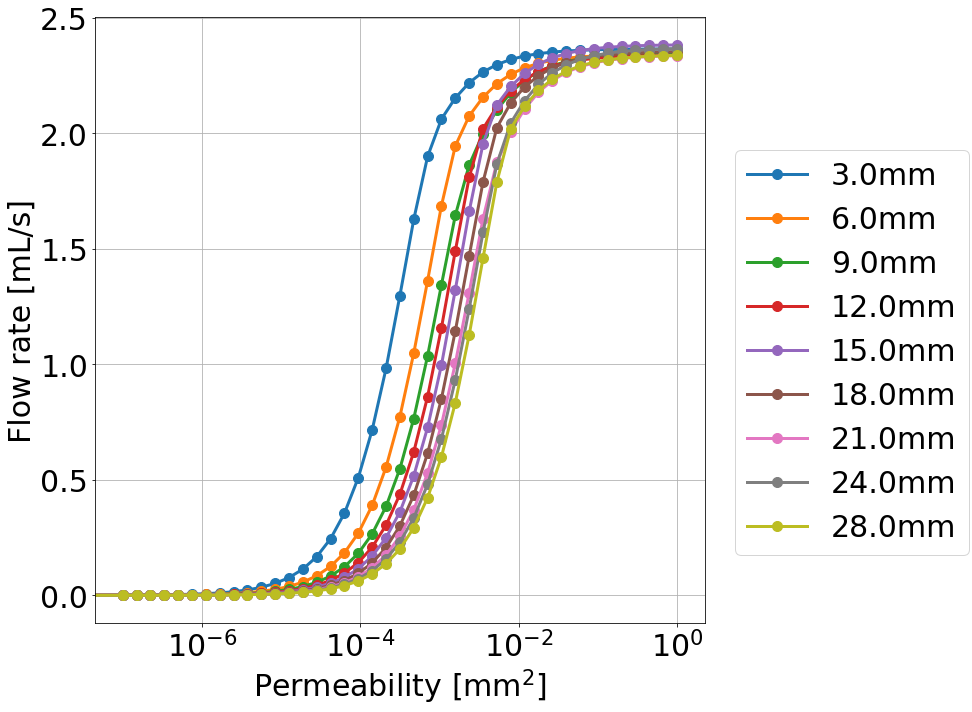

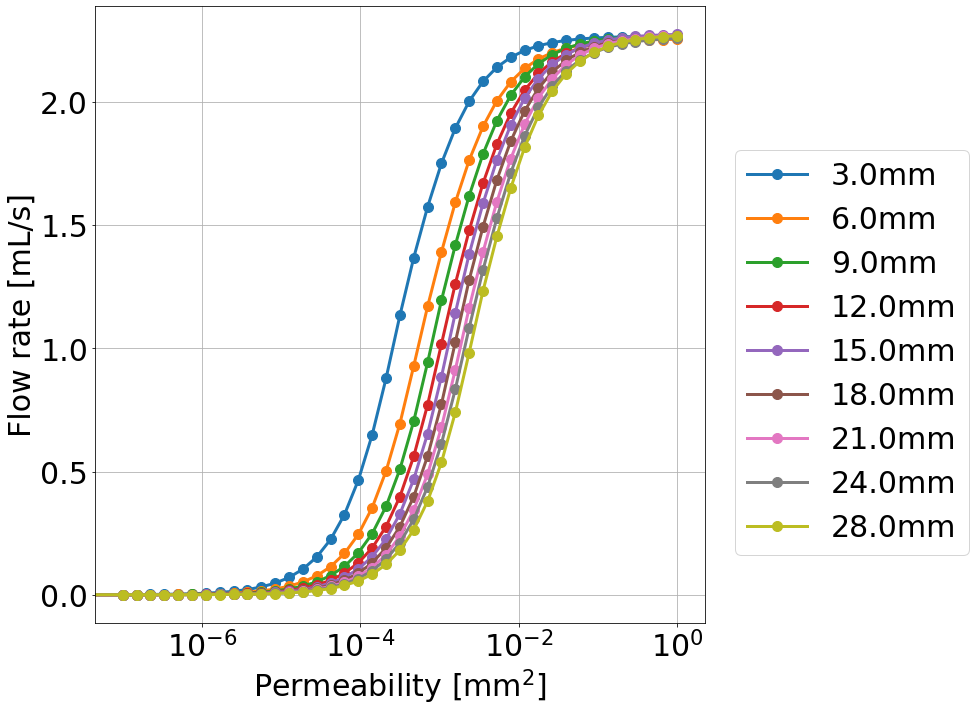

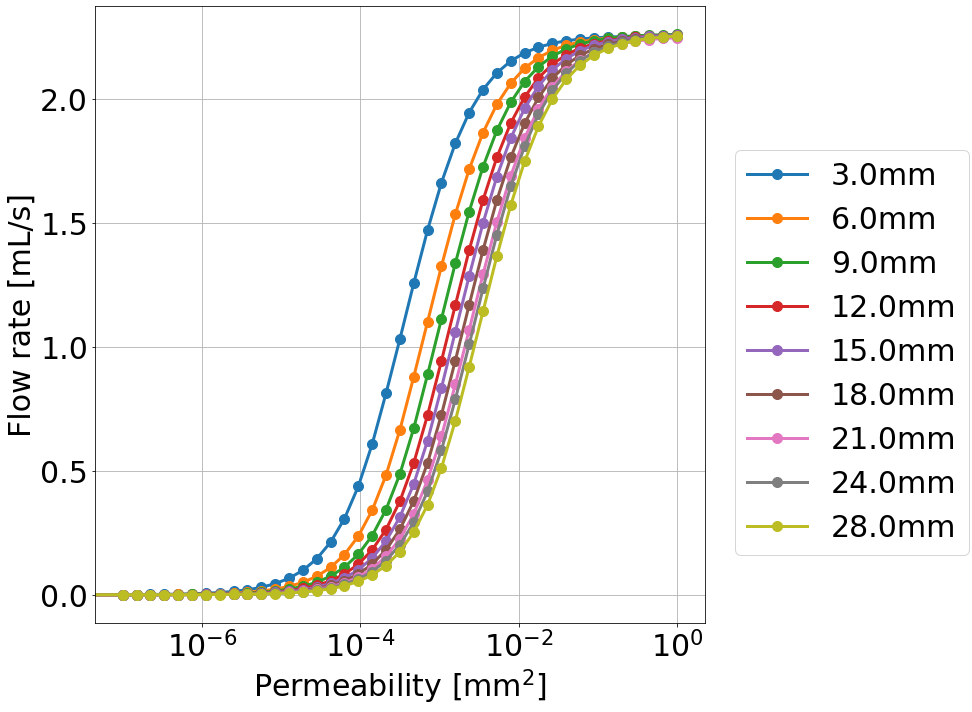

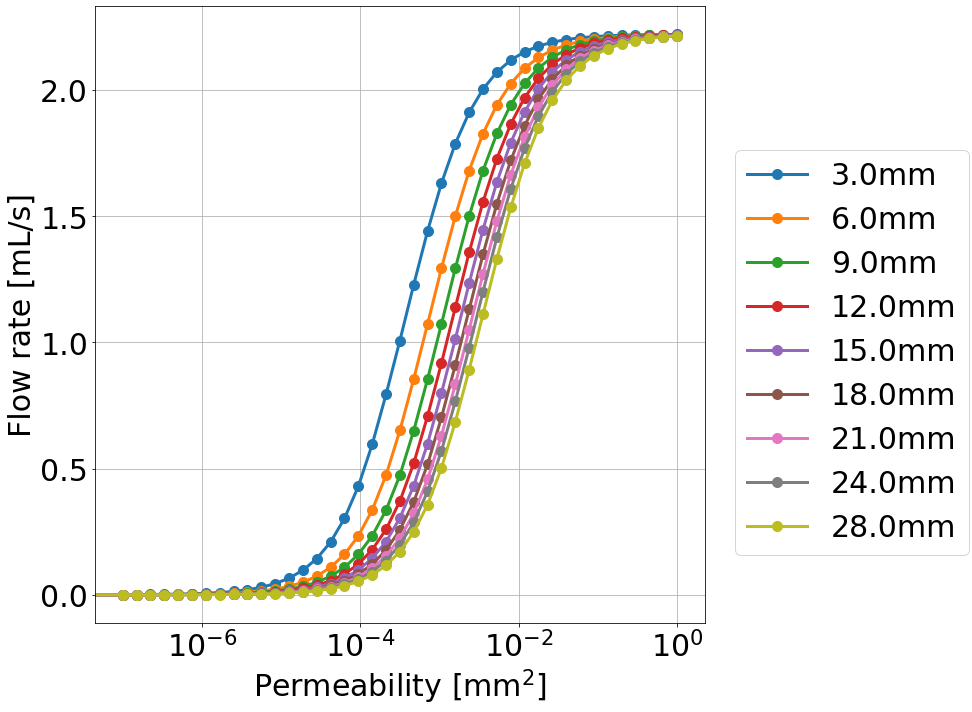

In [18]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][1:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][1:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][1:]

        #     ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm", marker='x', linewidth=3, markersize=10)
        ax.plot(Permeability, flowrate, label=str(length)+"mm", marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Permeability [mm$^2$]", fontsize=30)
    ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
    # ax.set_position([0.1,0.1,0.5,0.8])

    # ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    # ax2.tick_params(labelsize=20)

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sPermeability_Q_Collateral%s" % (OutputFolder,index), bbox_inches='tight')  

### Plot dp as function of k

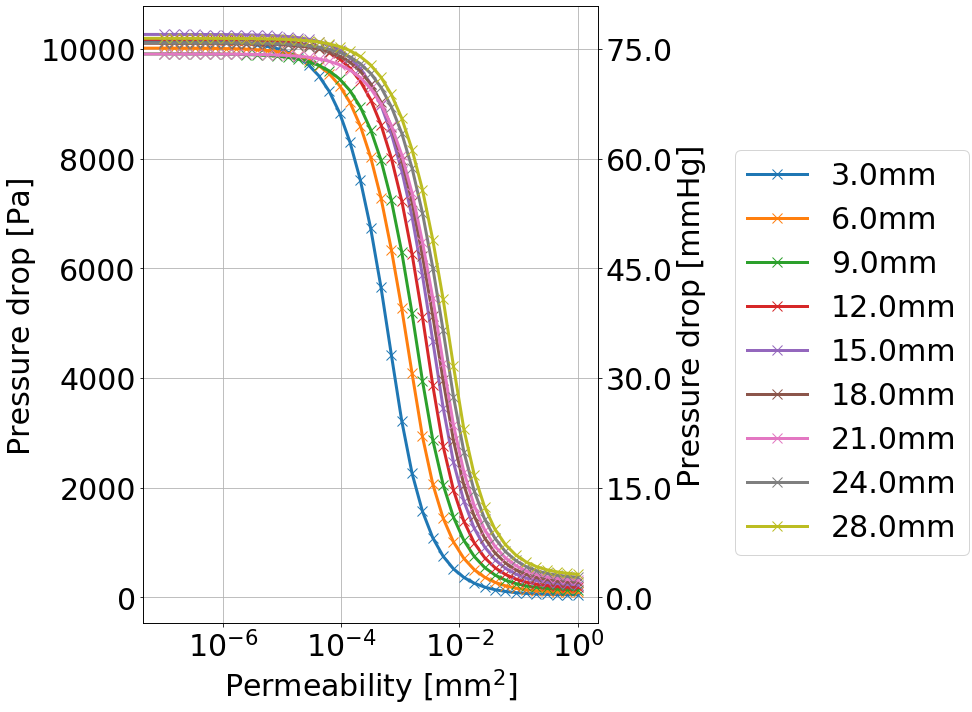

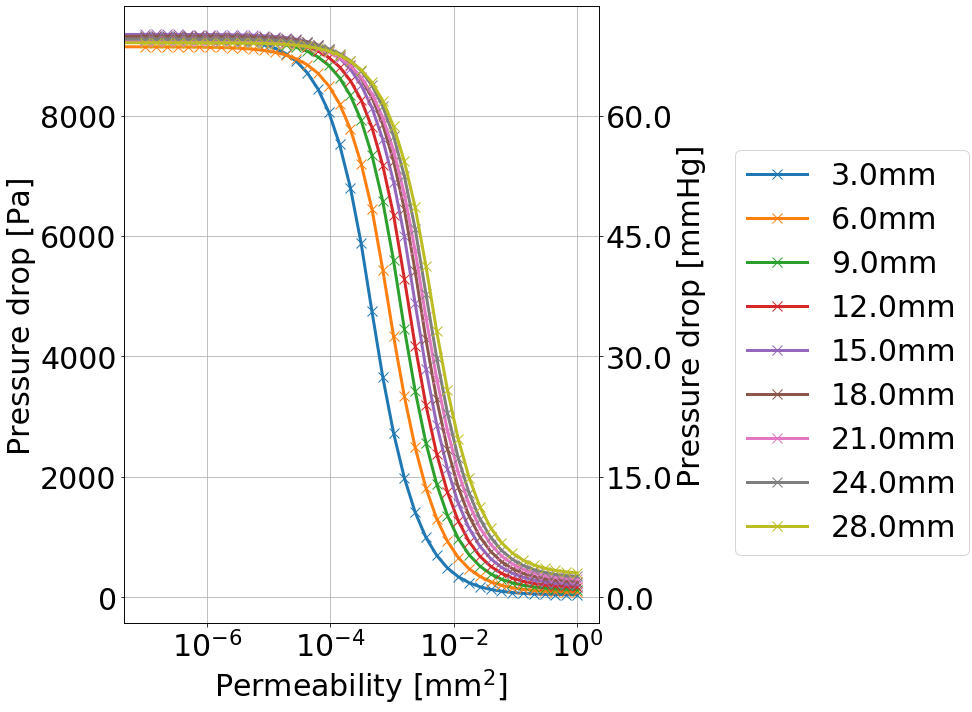

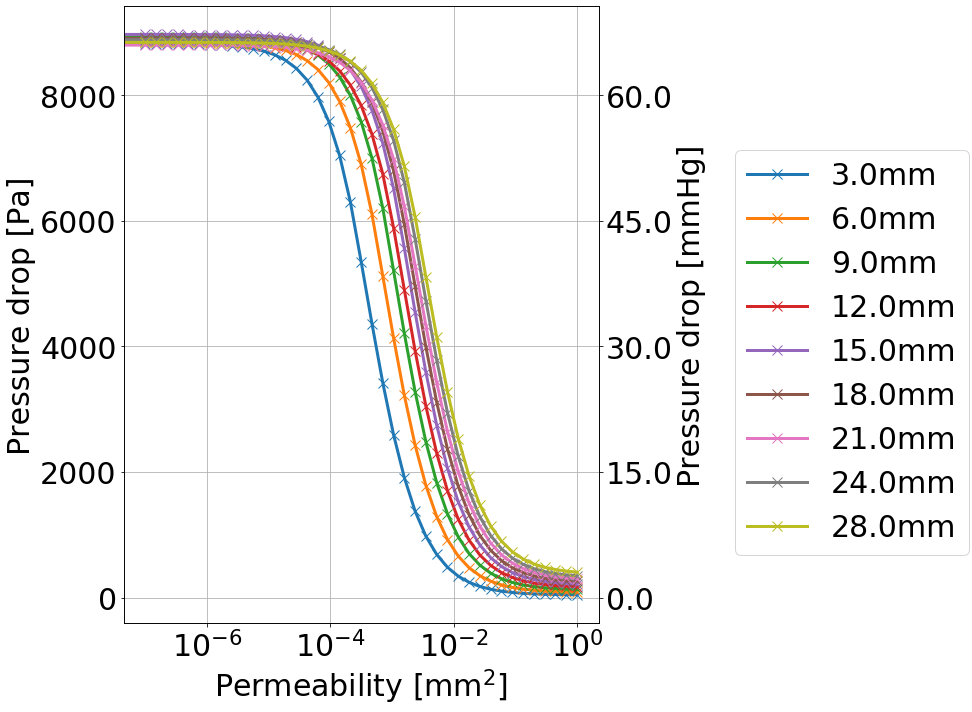

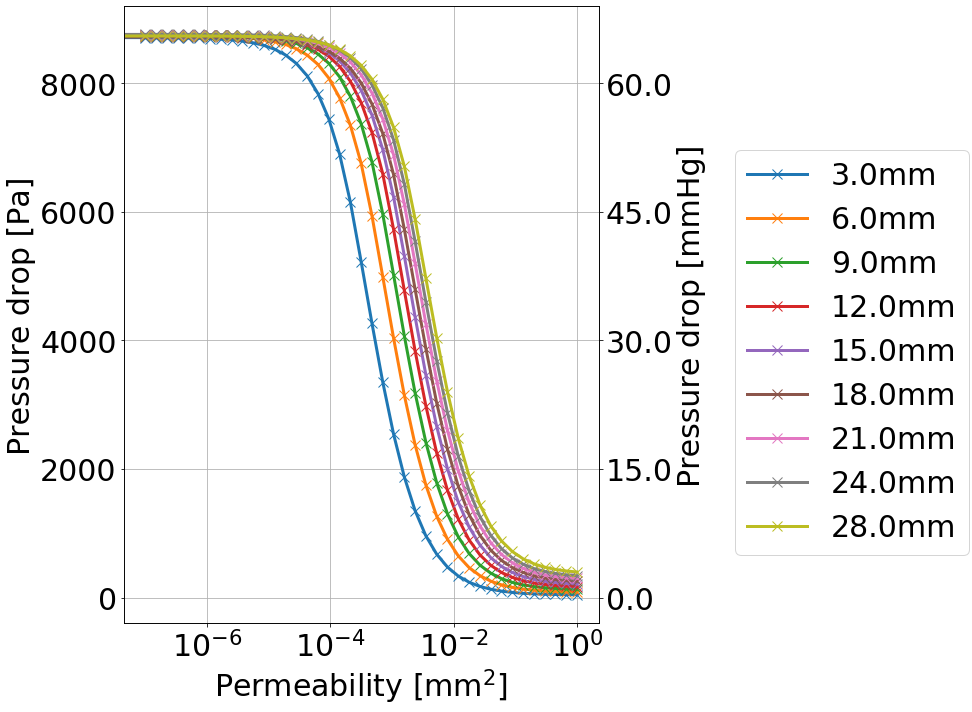

In [19]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][1:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][1:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][1:]

        ax.plot(Permeability, pressuredrop, label=str(length)+"mm", marker='x', linewidth=3, markersize=10)
        #     ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm", marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Permeability [mm$^2$]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')

    # ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    # ax2.tick_params(labelsize=20)

    # add a twin axes and set its limits so it matches the first
    ax2 = ax.twinx()
    ax2.set_ylabel('Pressure drop [mmHg]', fontsize=30)
    ax2.set_ylim(ax.get_ylim())

    # apply a function formatter
    formatter = mticker.FuncFormatter(lambda x, pos: '{:.1f}'.format(x/133.322))
    ax2.yaxis.set_major_formatter(formatter)   
    ax2.tick_params(labelsize=30)
    
    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sPermeability_dp_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

###  Plot Q, dp as function of k

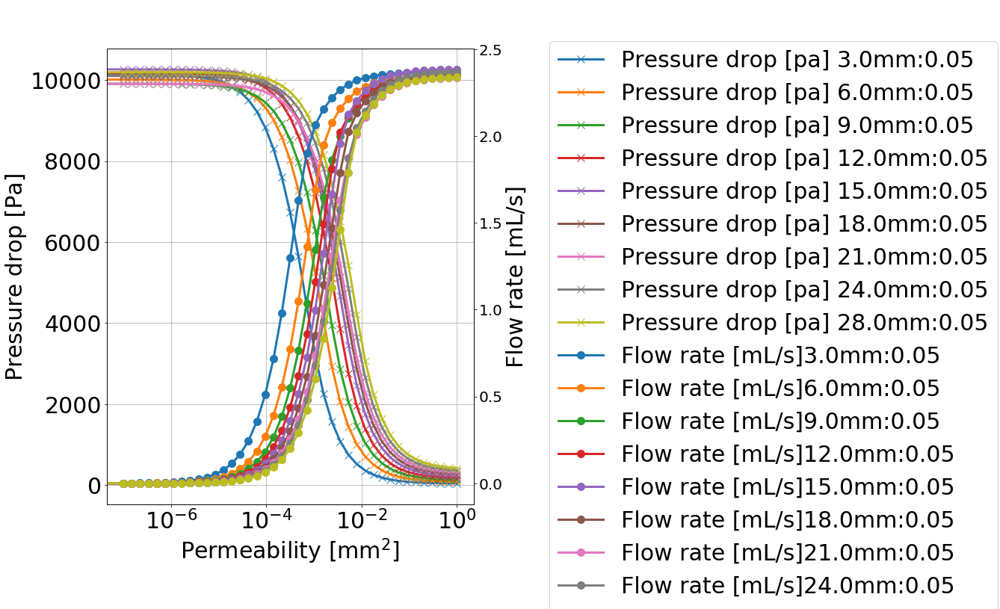

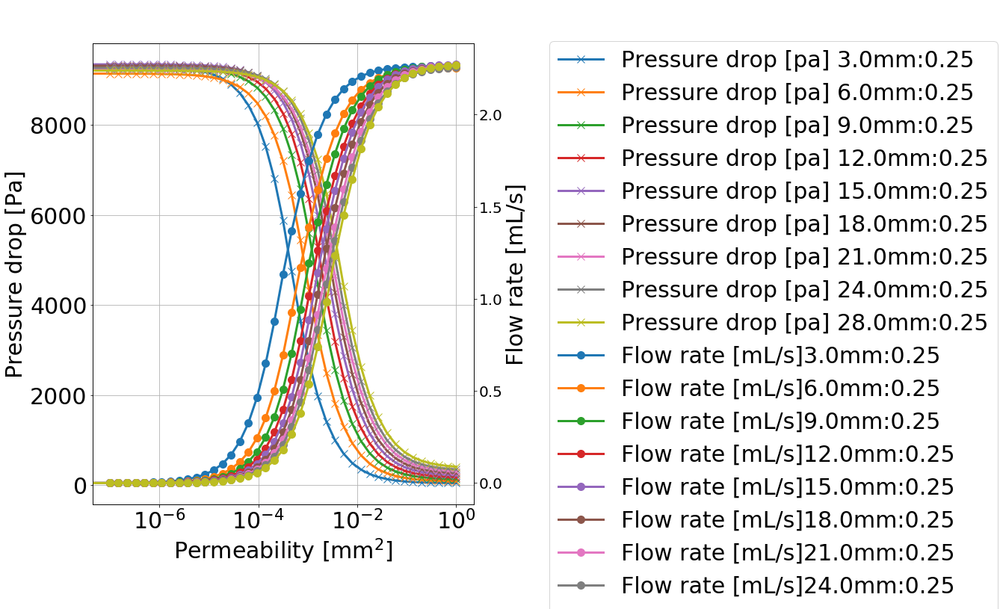

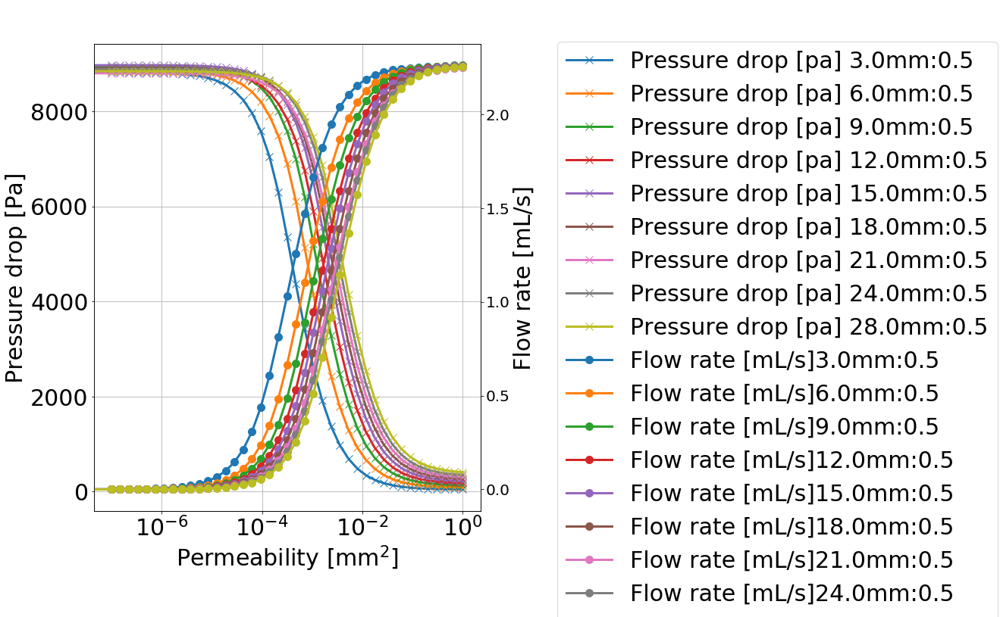

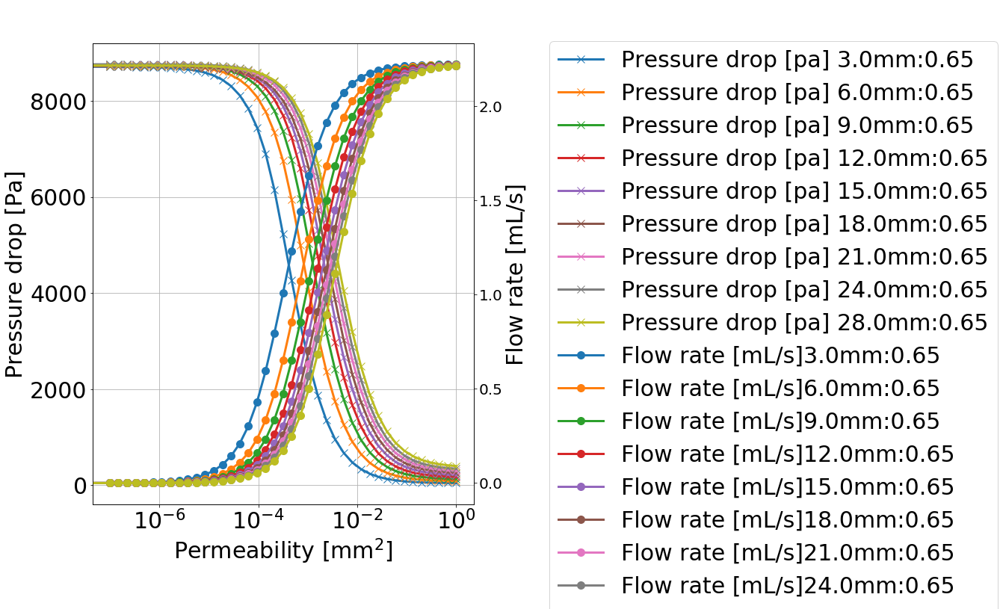

In [20]:
for index, collateral in enumerate(collateraloptions):
    
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()
    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][1:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][1:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][1:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Permeability [mm$^2$]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')

    ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax2.tick_params(labelsize=20)
#     ax2.grid()

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sPermeability_dp_Q_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot Q as function of R

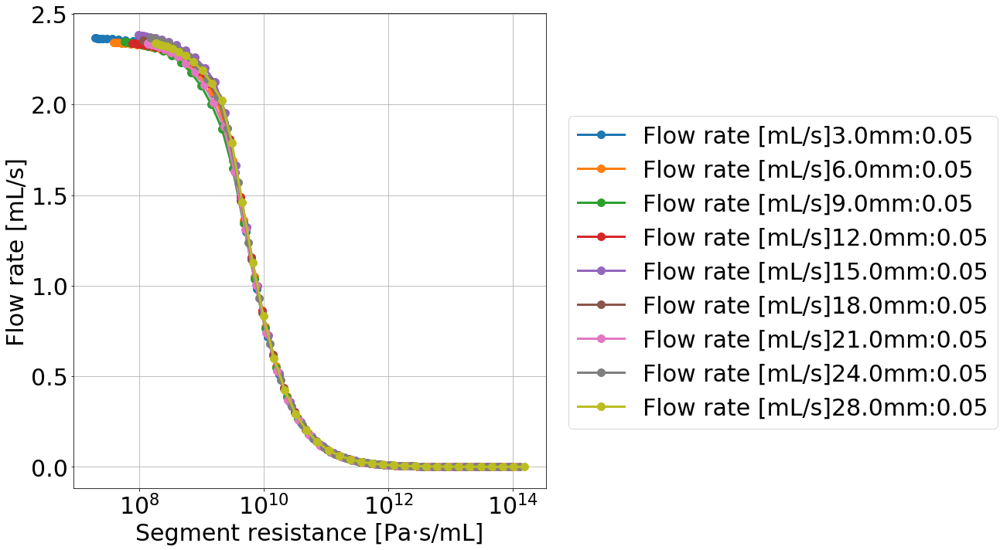

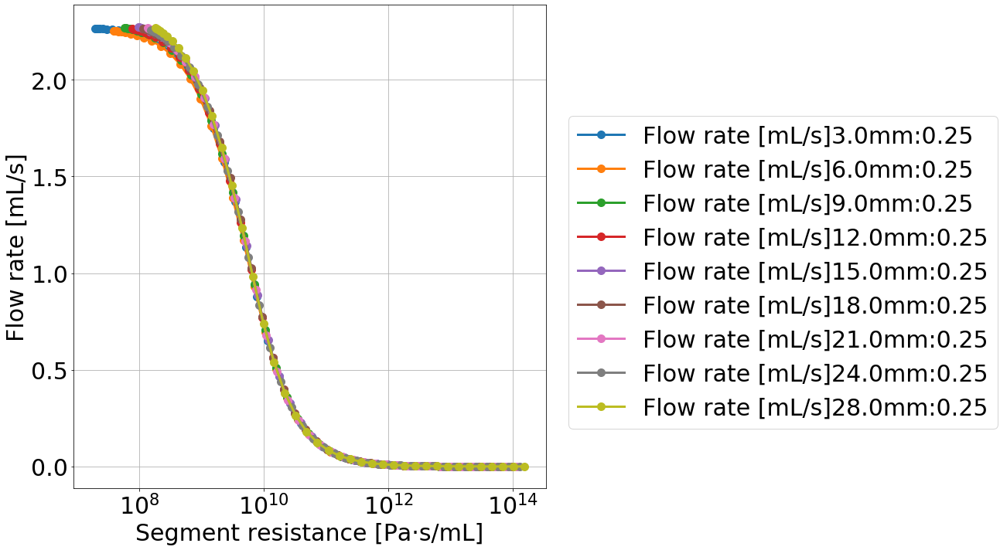

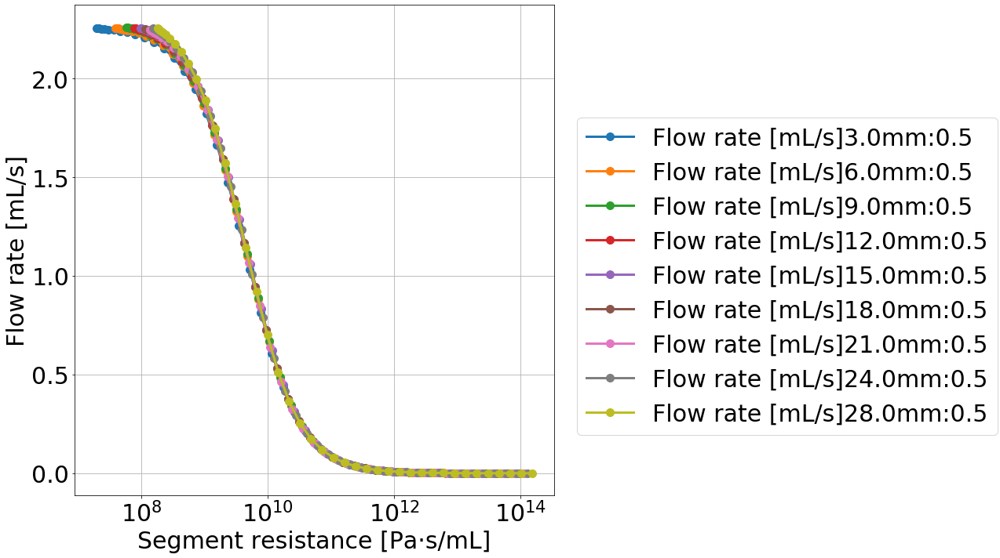

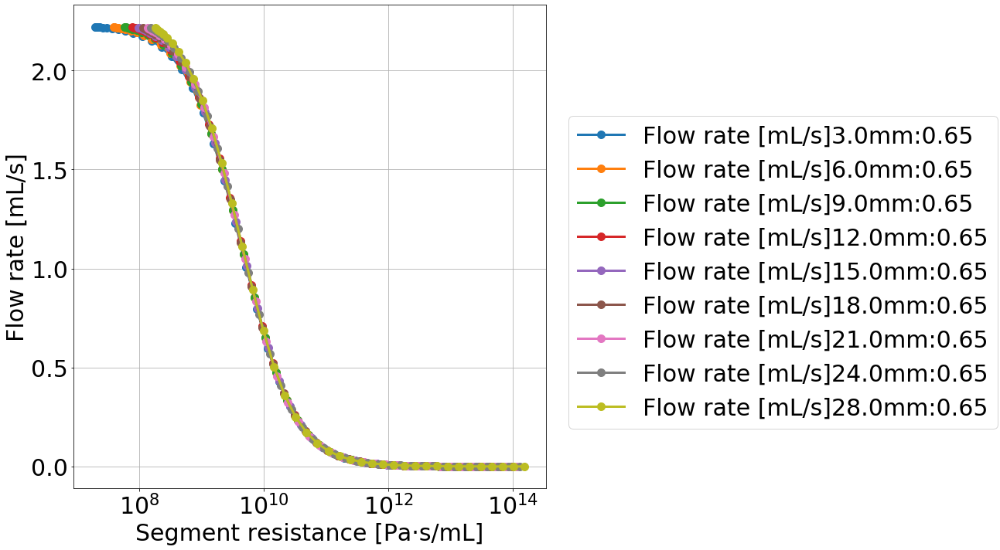

In [21]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

    #     ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm", marker='x', linewidth=3, markersize=10)
        ax.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')

    # ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    # ax2.tick_params(labelsize=20)

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_Q_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()


### Plot dp as function of R

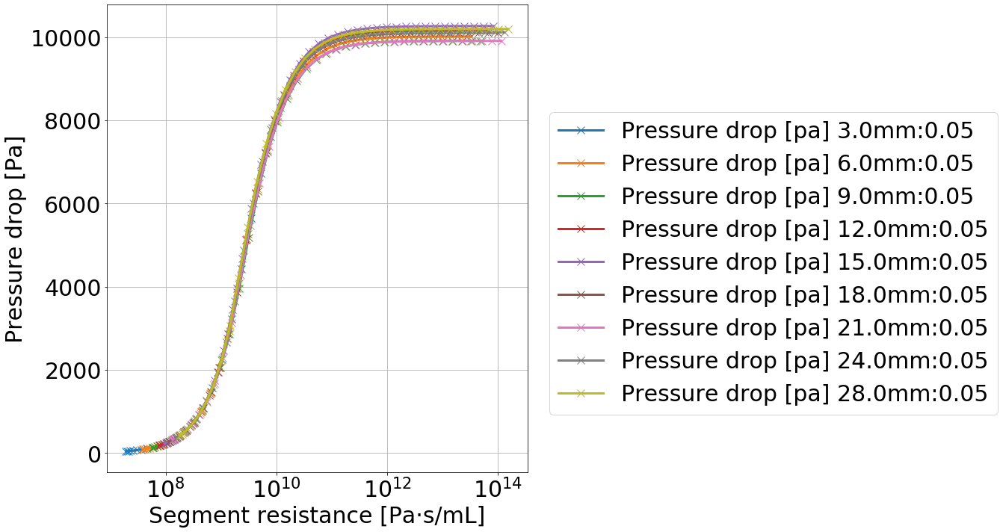

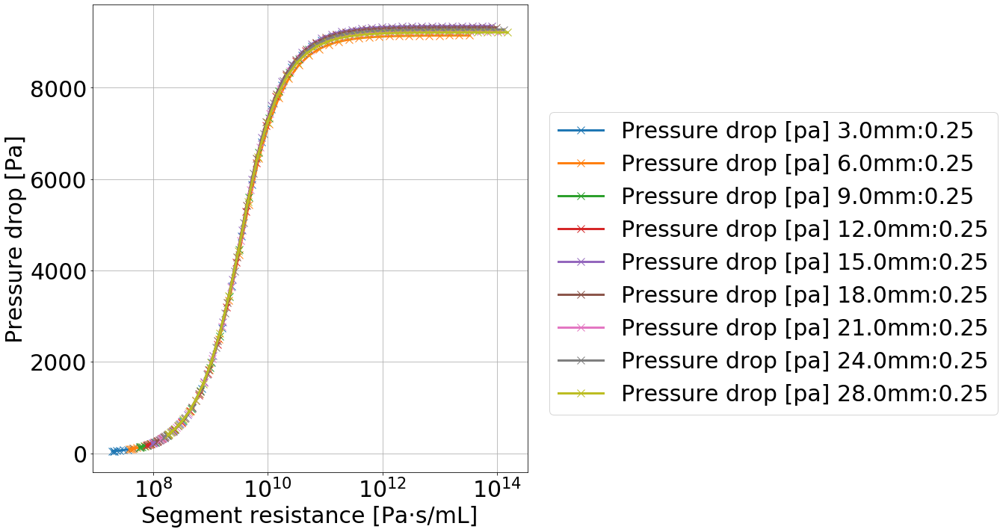

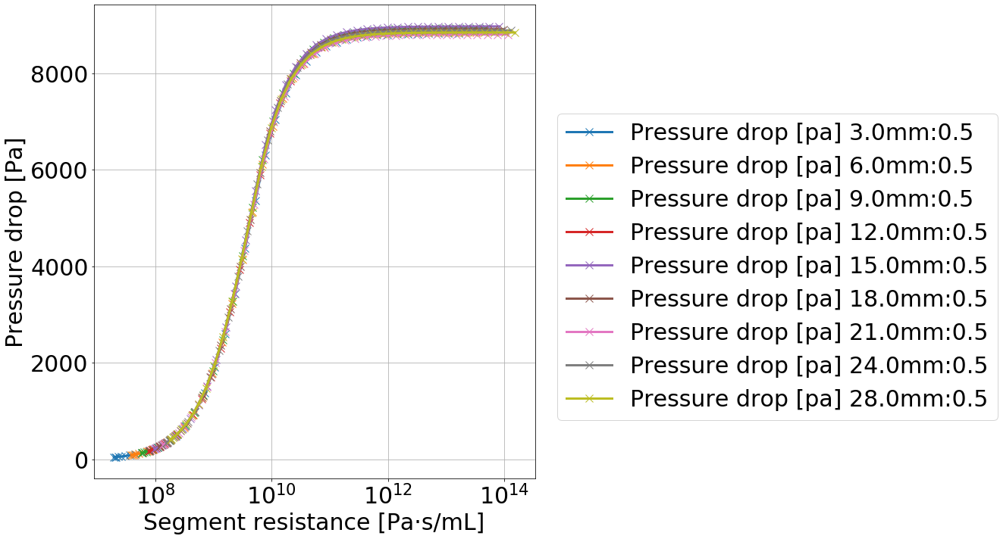

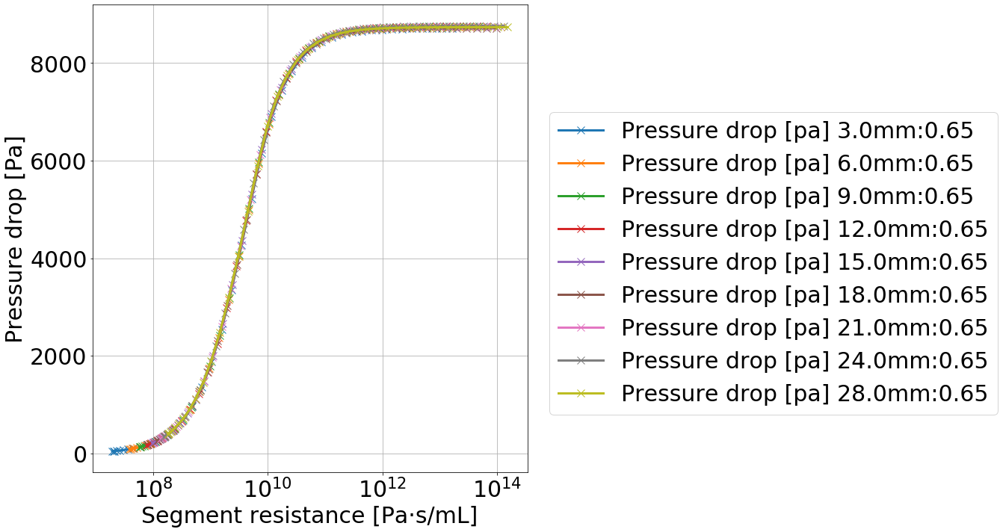

In [22]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
    #     ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm", marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')

    # ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    # ax2.tick_params(labelsize=20)

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5)) 
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_dp_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

###  Plot Q, dp as function of R

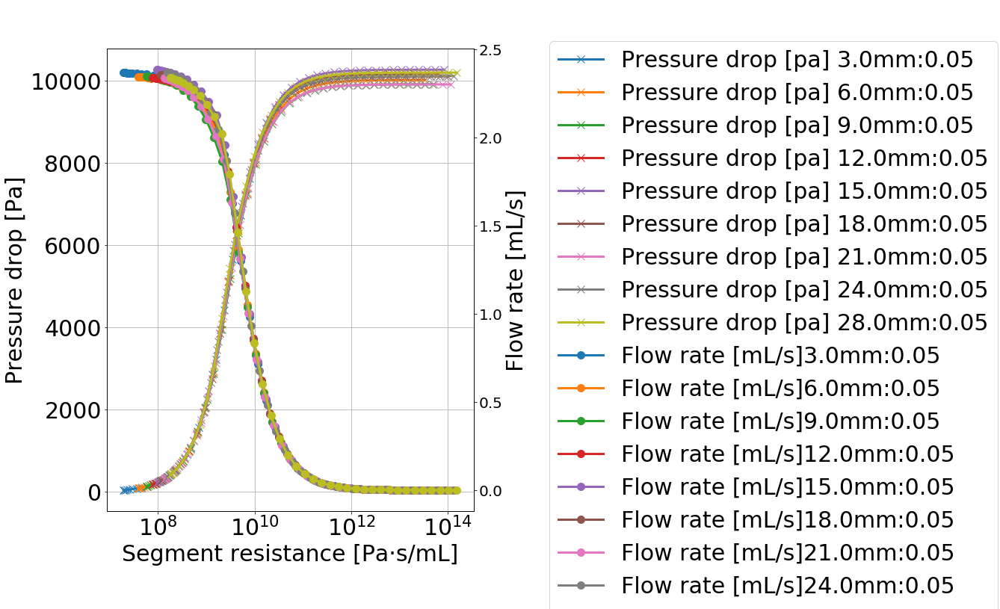

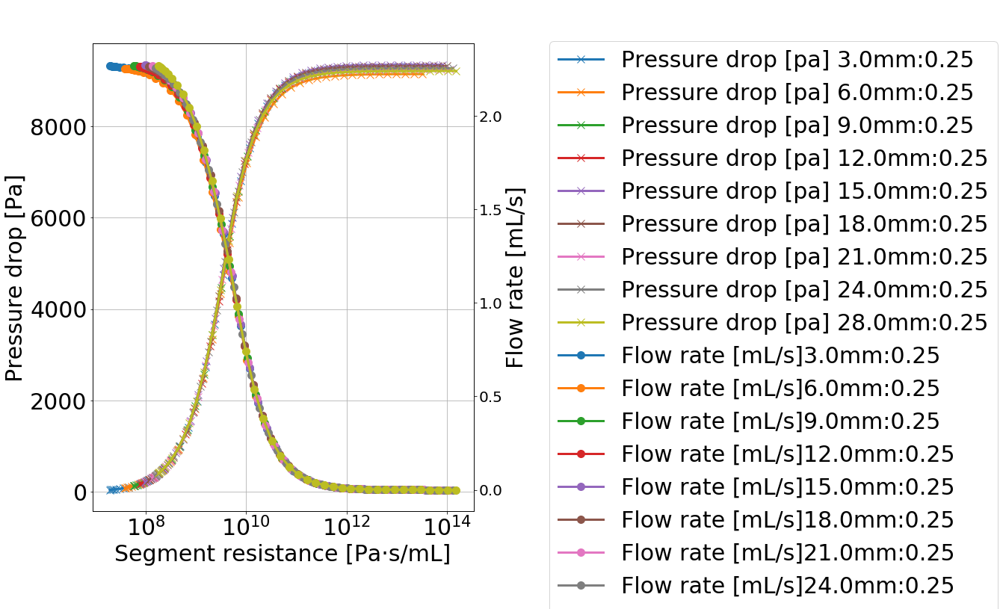

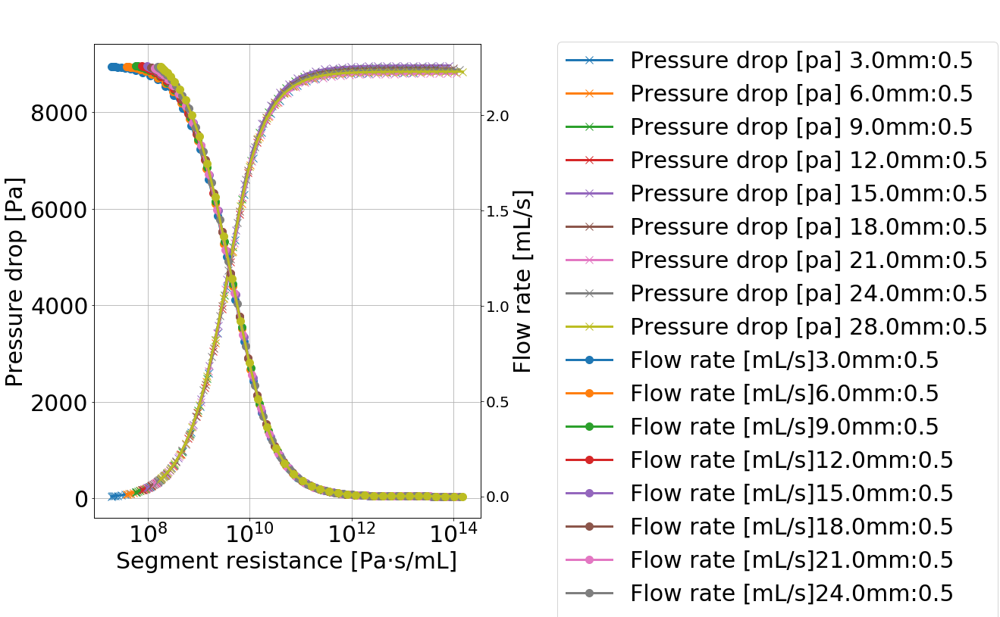

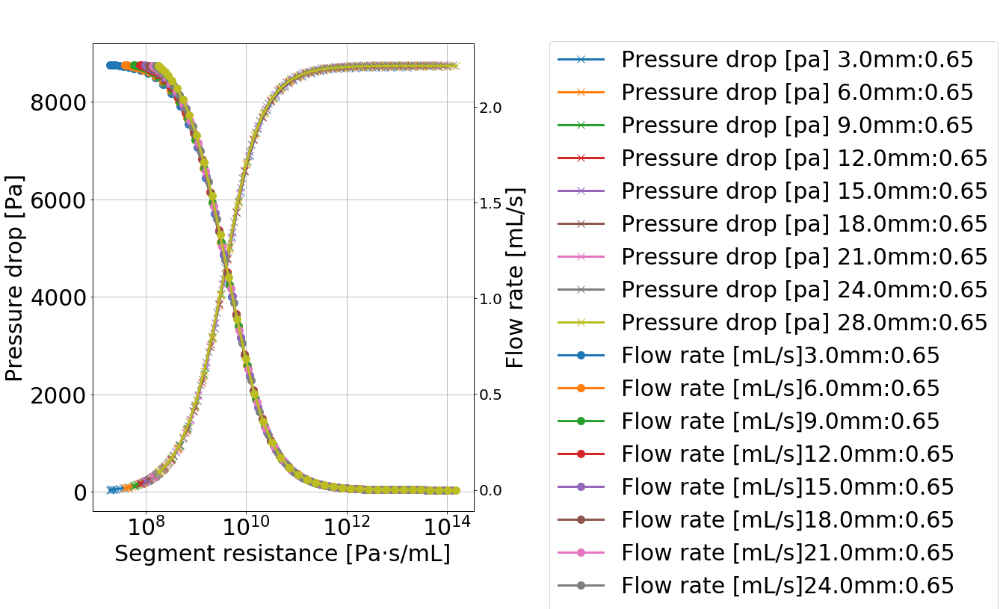

In [23]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
#     ax.set_yscale('log')

    ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax2.tick_params(labelsize=20)
#     ax2.set_yscale('log')

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_dp_Q_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot Q, dP as function of R (length view)

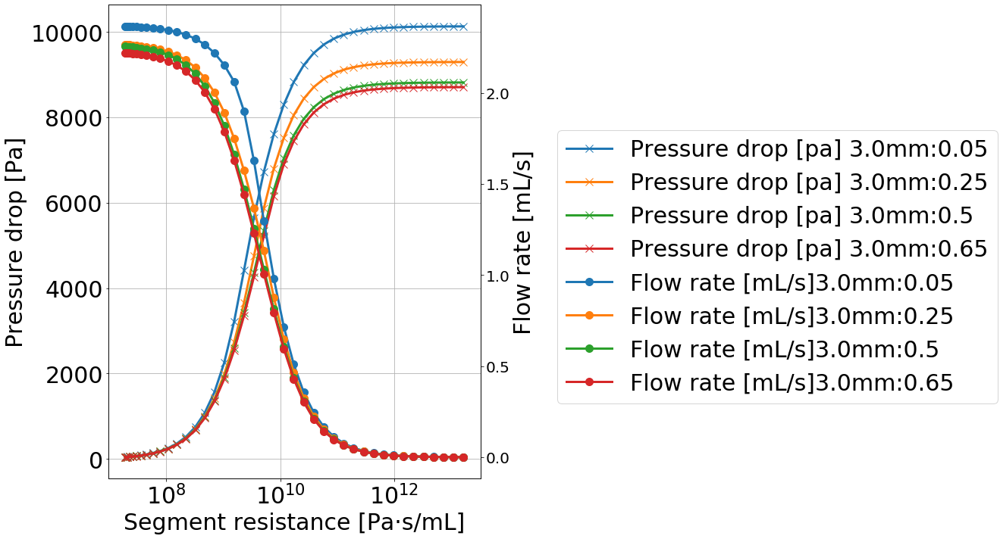

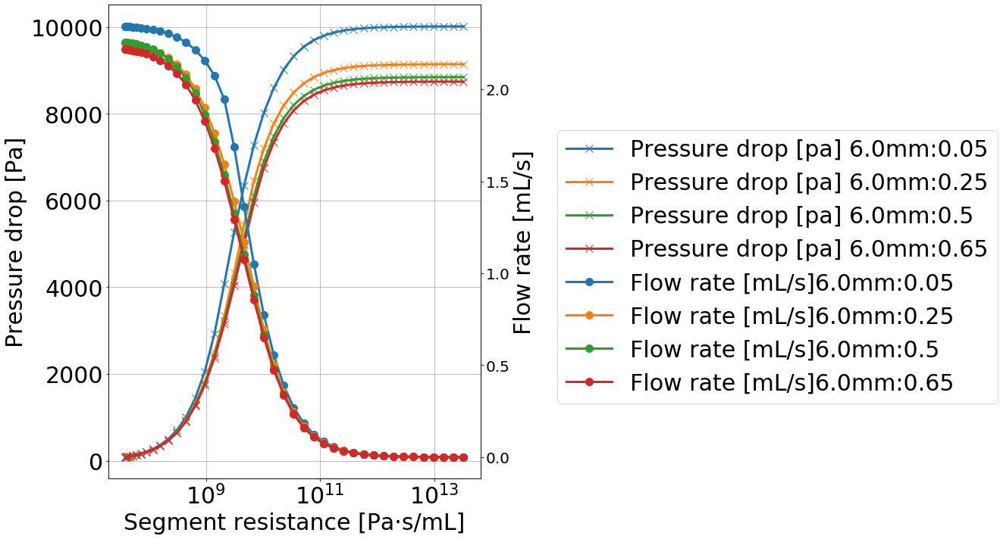

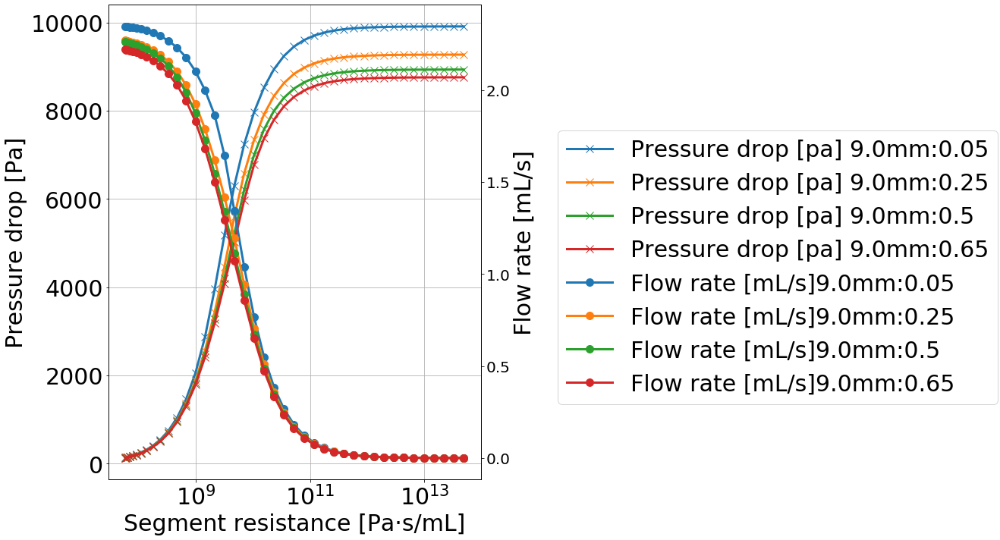

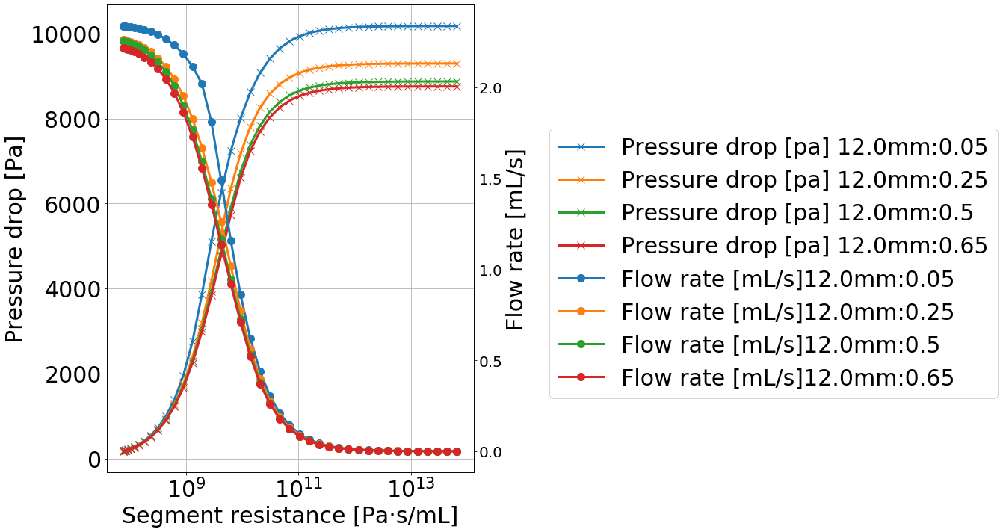

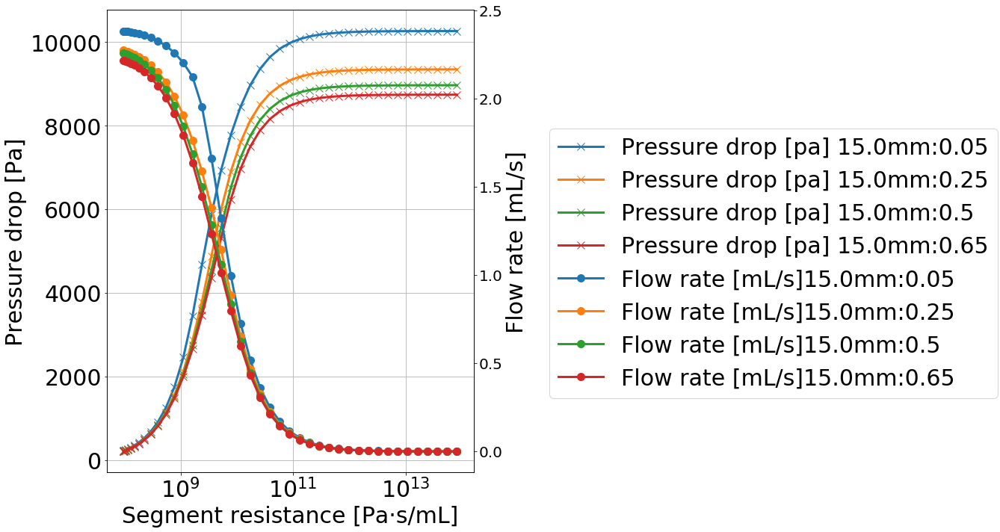

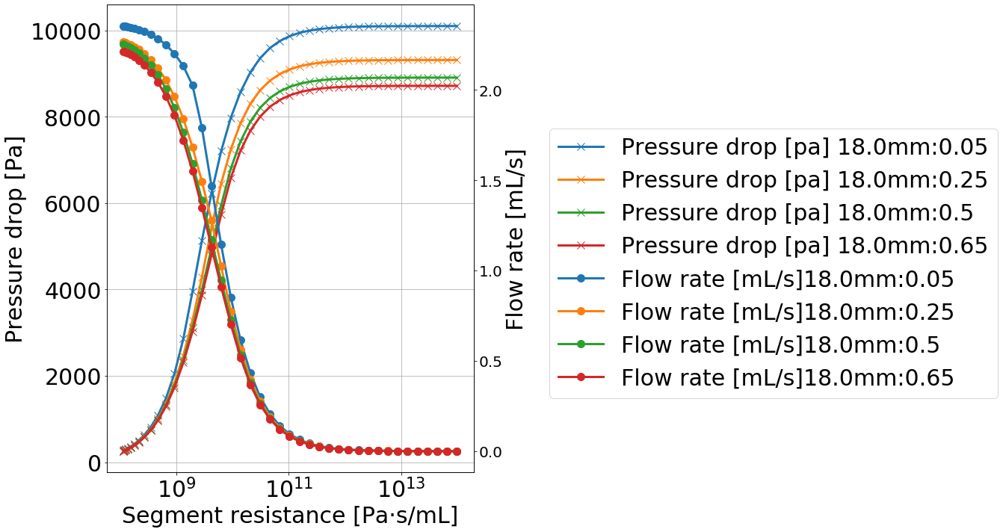

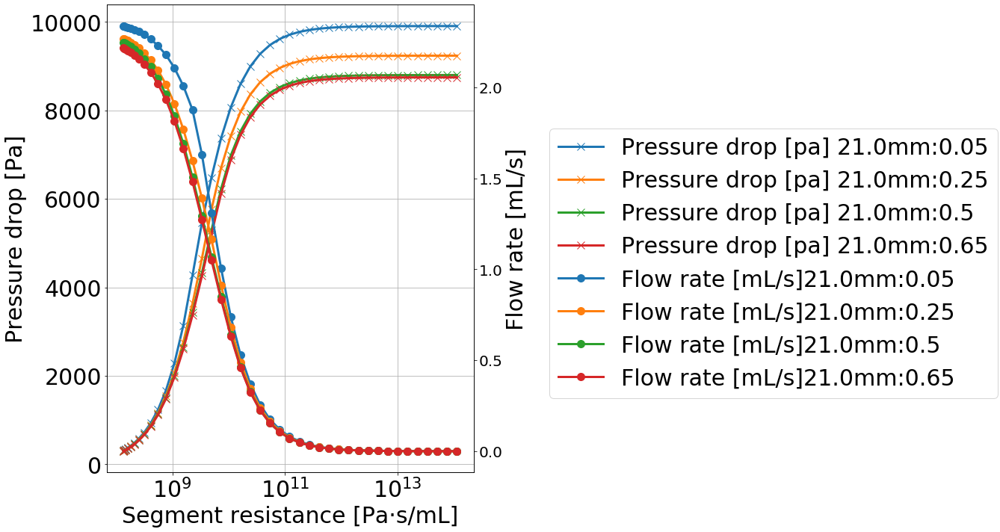

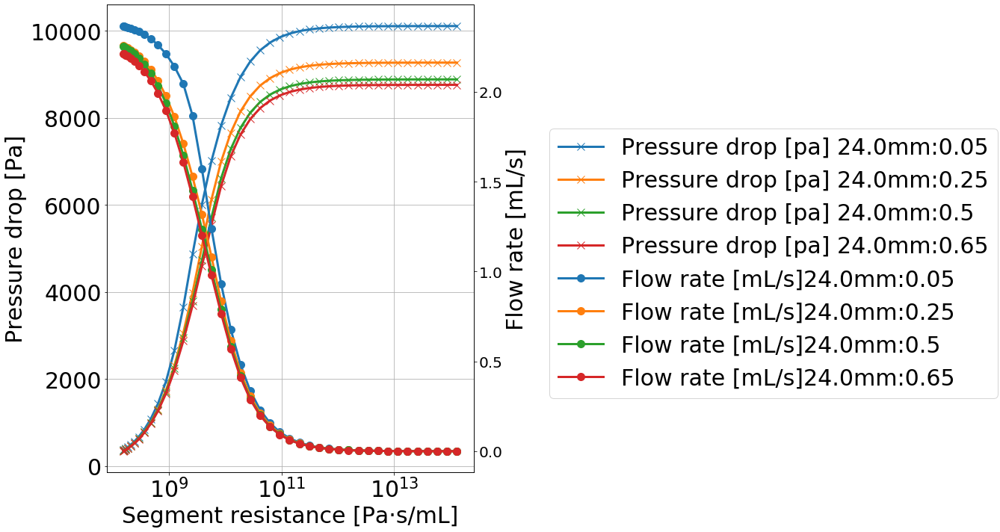

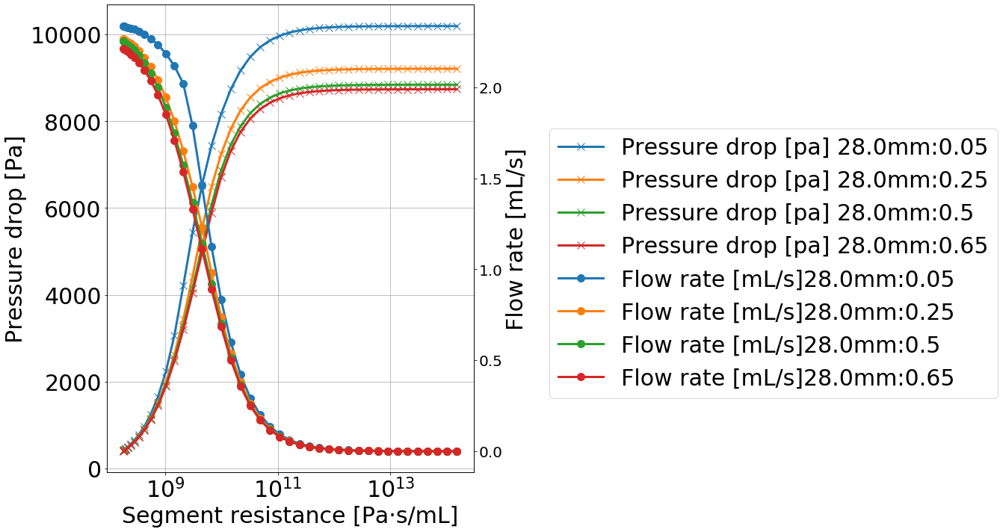

In [24]:
# for index, collateral in enumerate(collateraloptions):
for index, length in enumerate(lengthoptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()
    
#     for _, length in enumerate(lengthoptions):
    for _, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)

    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
#     ax.set_yscale('log')

    ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax2.tick_params(labelsize=20)
#     ax2.set_yscale('log')

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_dp_Q_Length%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

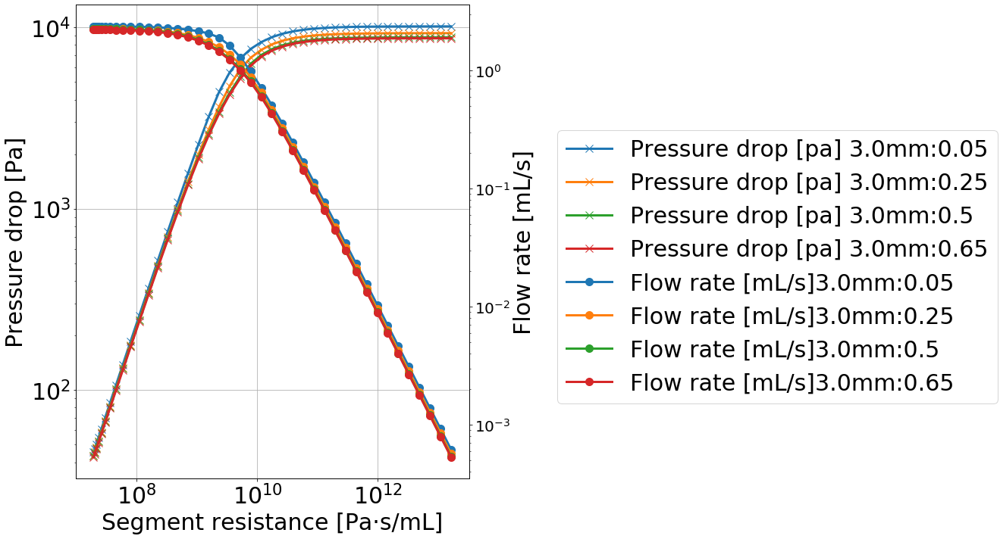

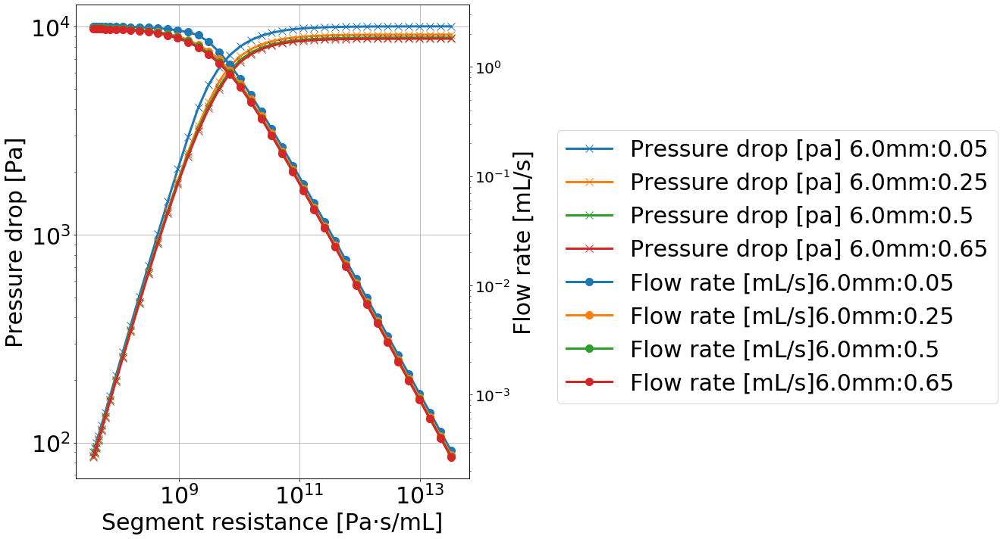

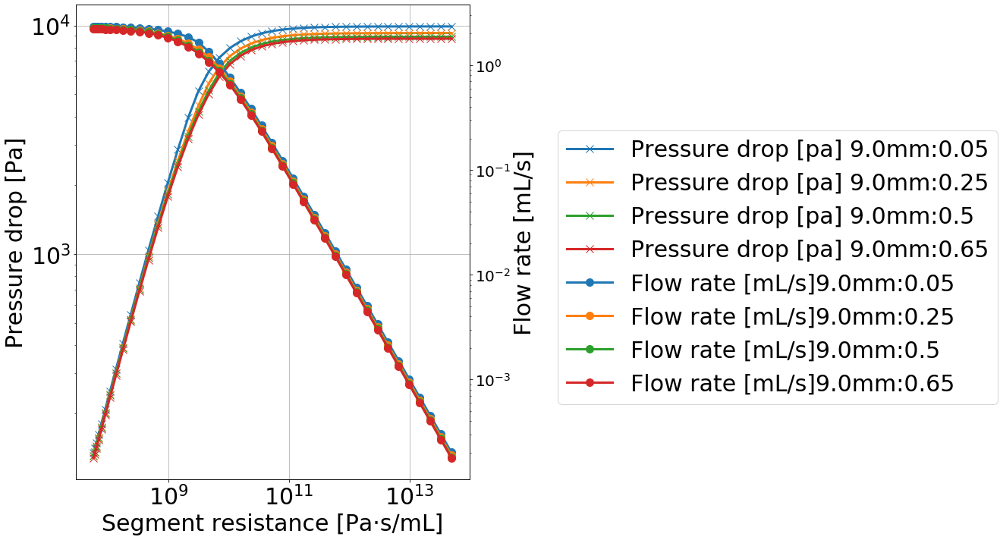

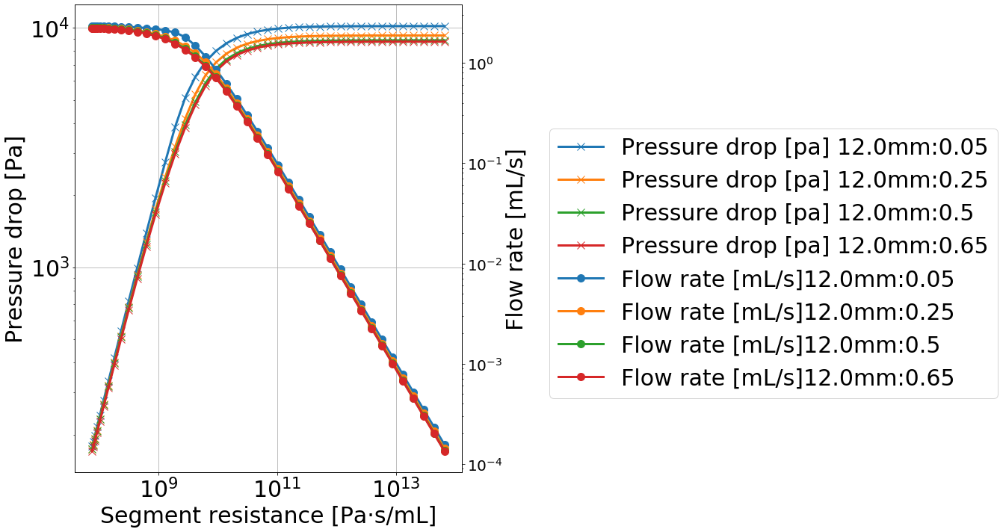

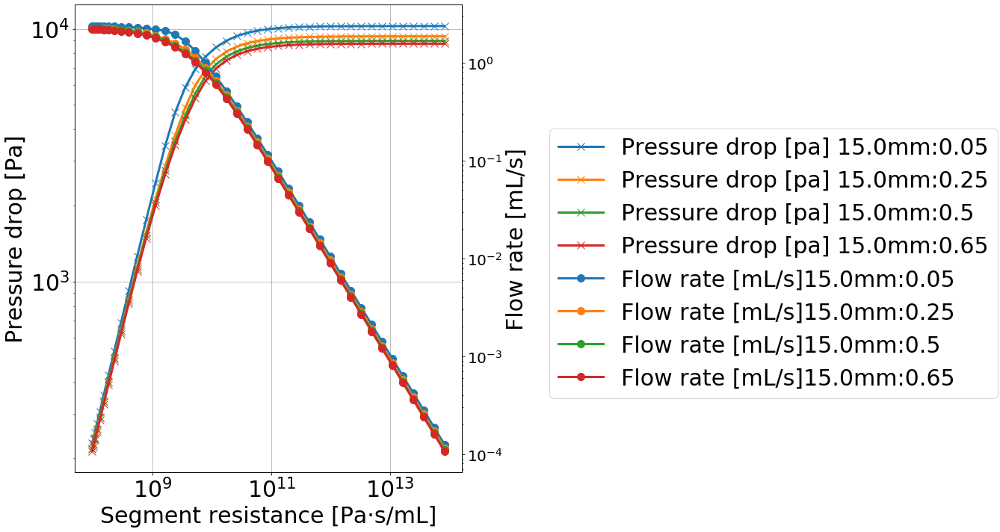

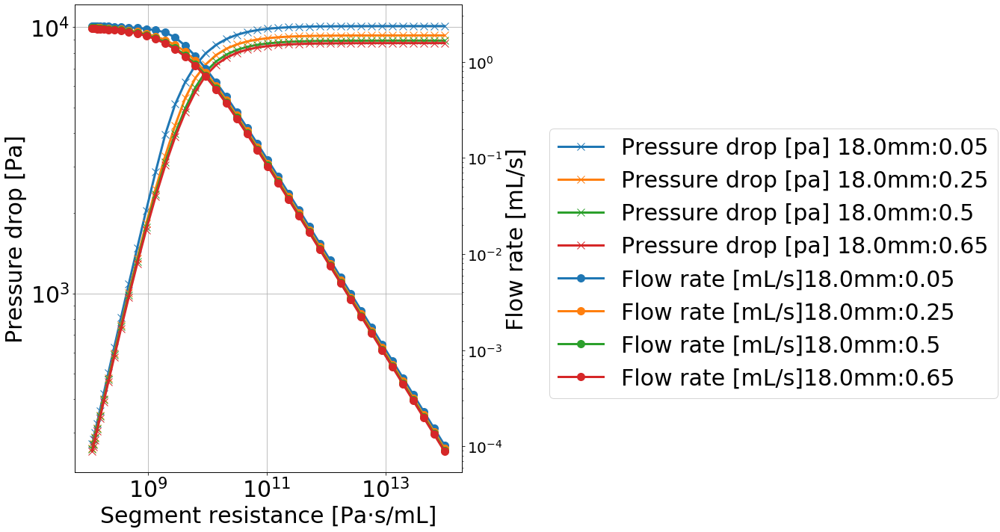

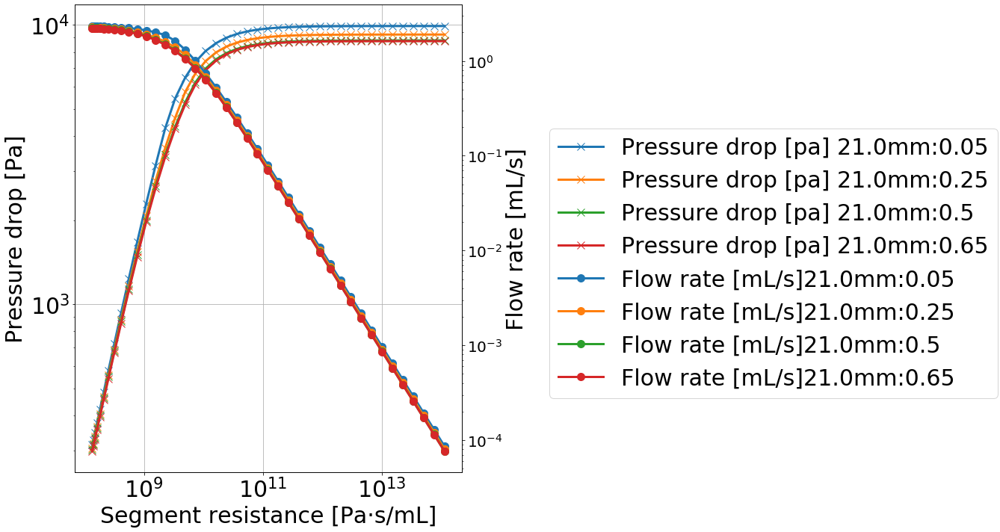

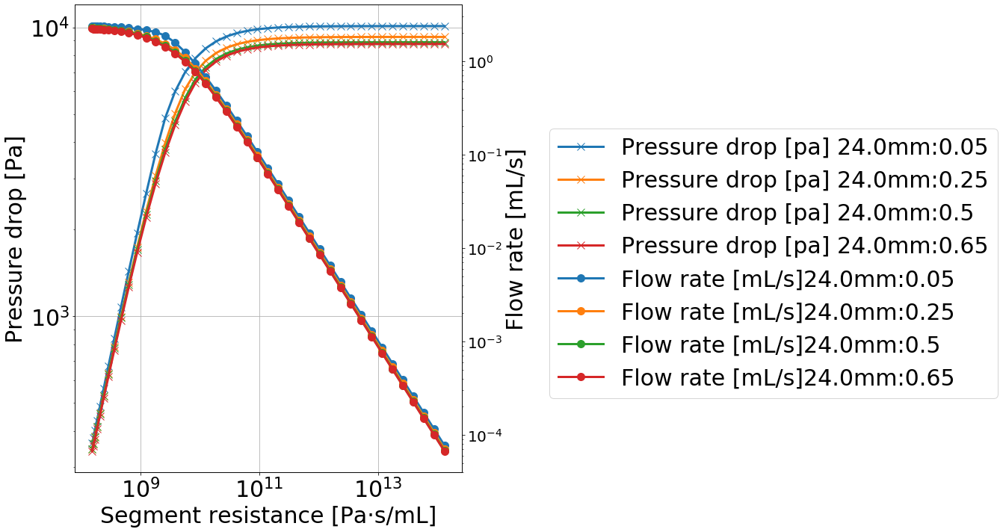

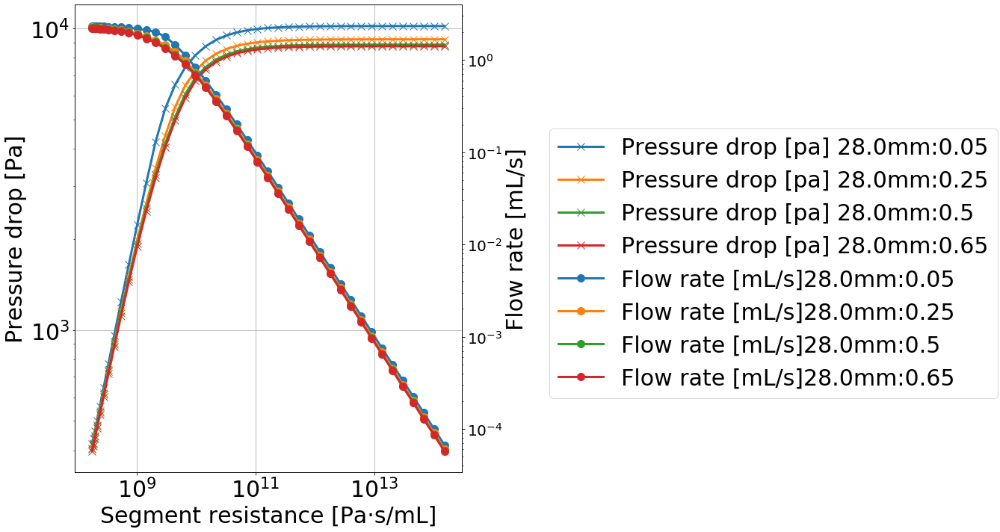

In [25]:
# for index, collateral in enumerate(collateraloptions):
for index, length in enumerate(lengthoptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()
    
#     for _, length in enumerate(lengthoptions):
    for _, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)

    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')

    ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax2.tick_params(labelsize=20)
    ax2.set_yscale('log')

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_dp_Q_Length_log%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot dp, Q scatter

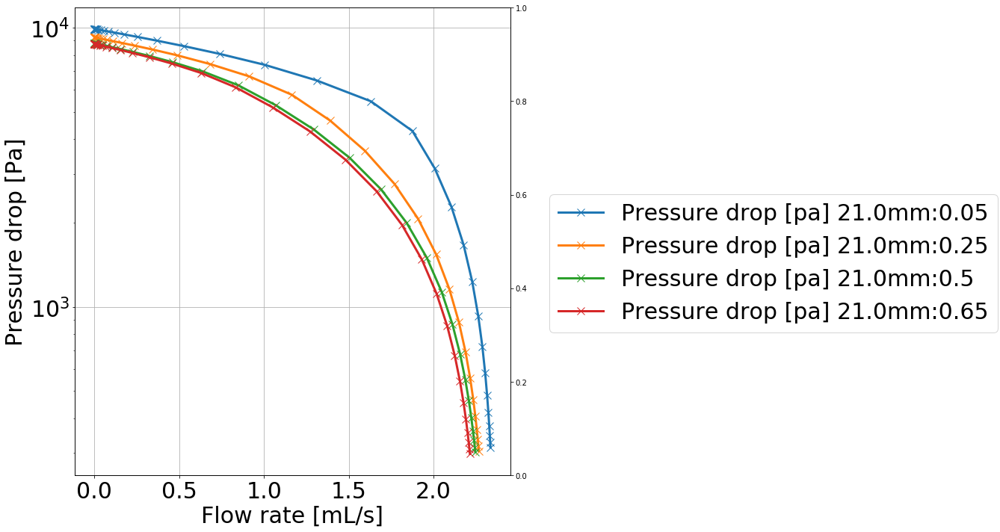

In [26]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
ax2 = ax.twinx()

lengths = np.array([21.0])
# collaterals = np.array([1.0])
for index, length in enumerate(lengths):
    for _, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(flowrate, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linestyle = '-', linewidth=3, markersize=10)
#         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


ax.set_xlabel("Flow rate [mL/s]", fontsize=30)
ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
# ax.set_xscale('log')
ax.set_yscale('log')

# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)
#     ax2.set_yscale('log')

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sScatter_dp_Q" % OutputFolder, bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot dp, Q scatter (length)

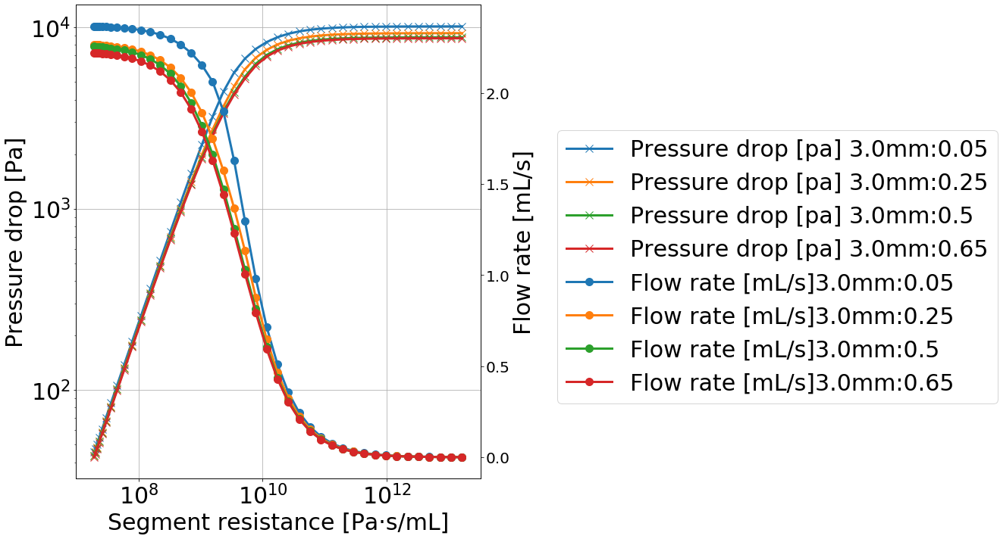

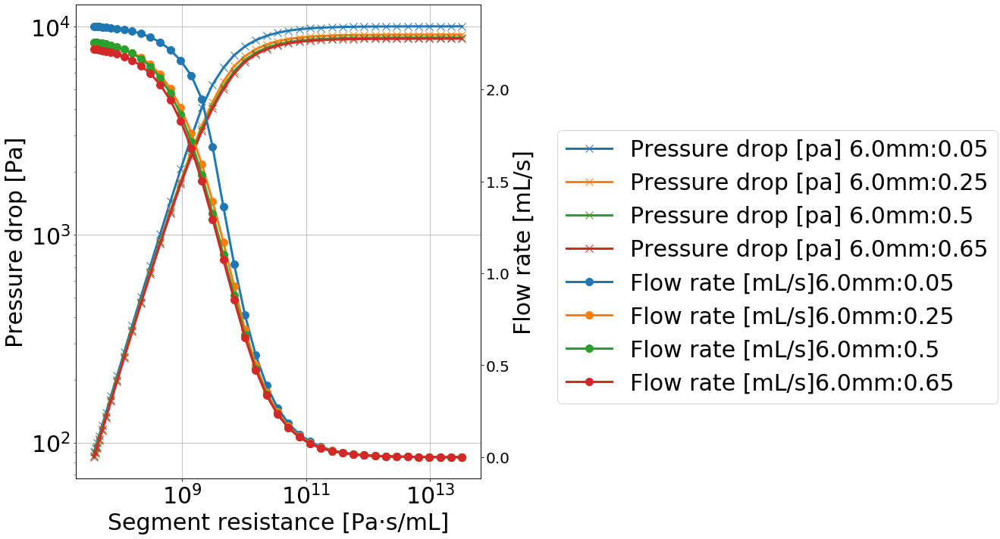

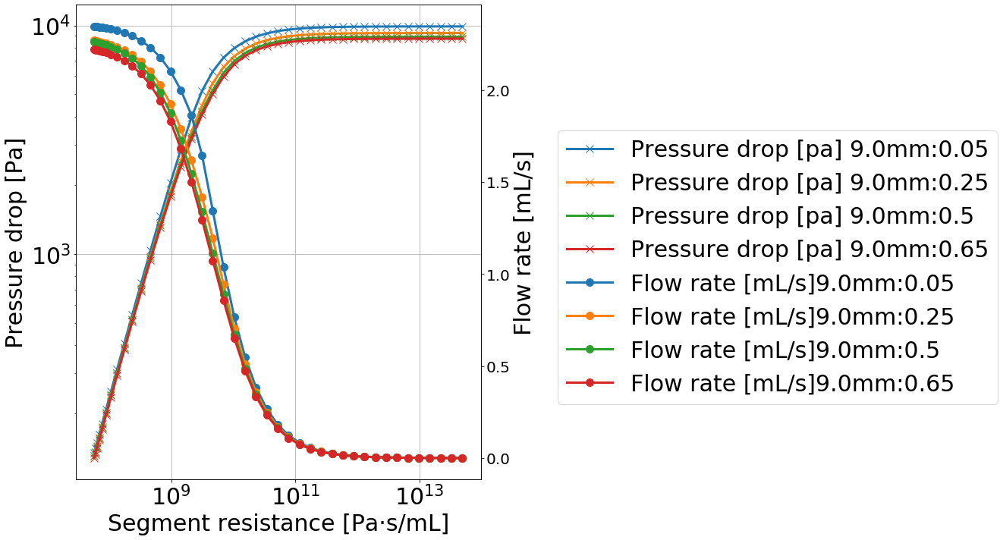

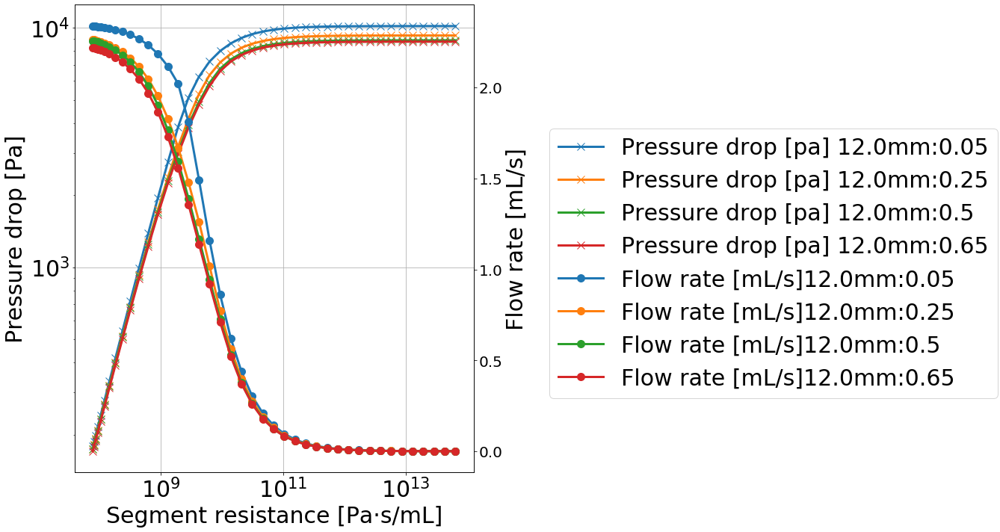

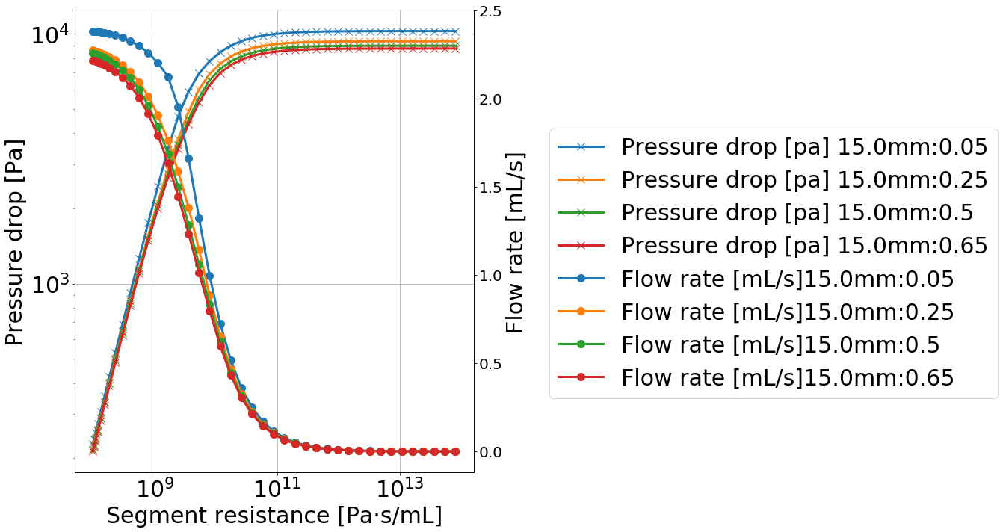

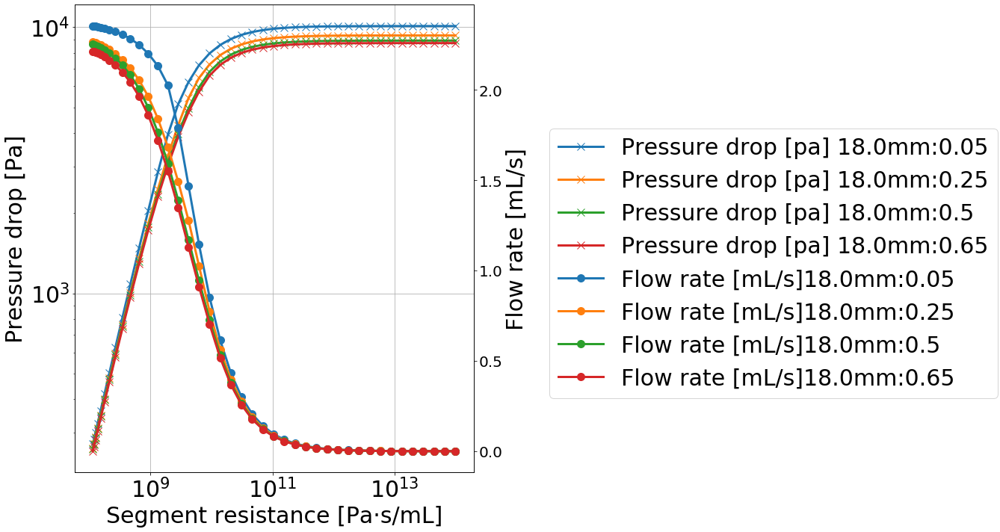

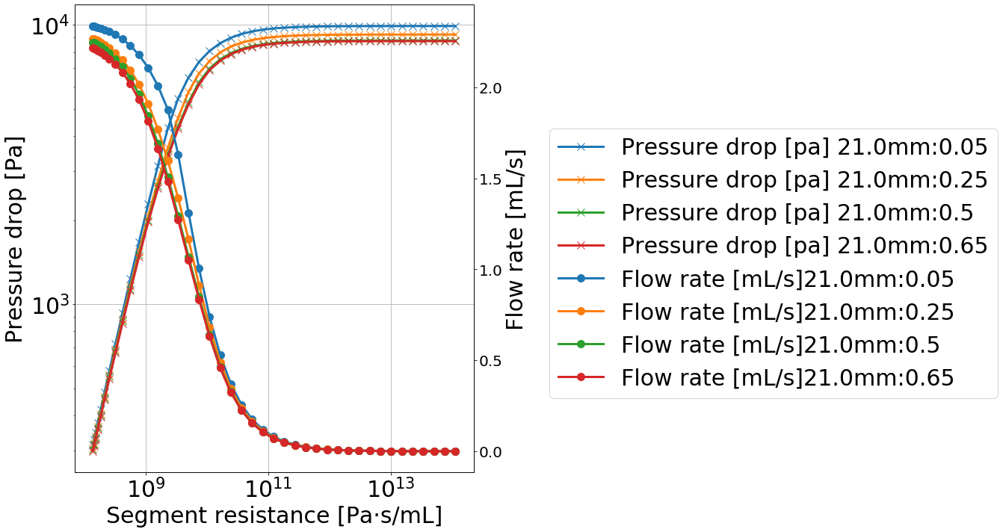

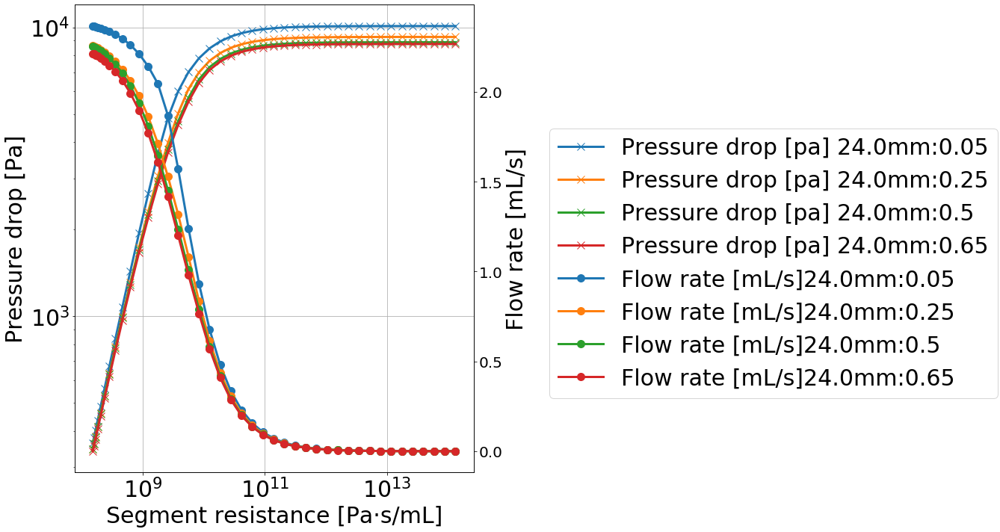

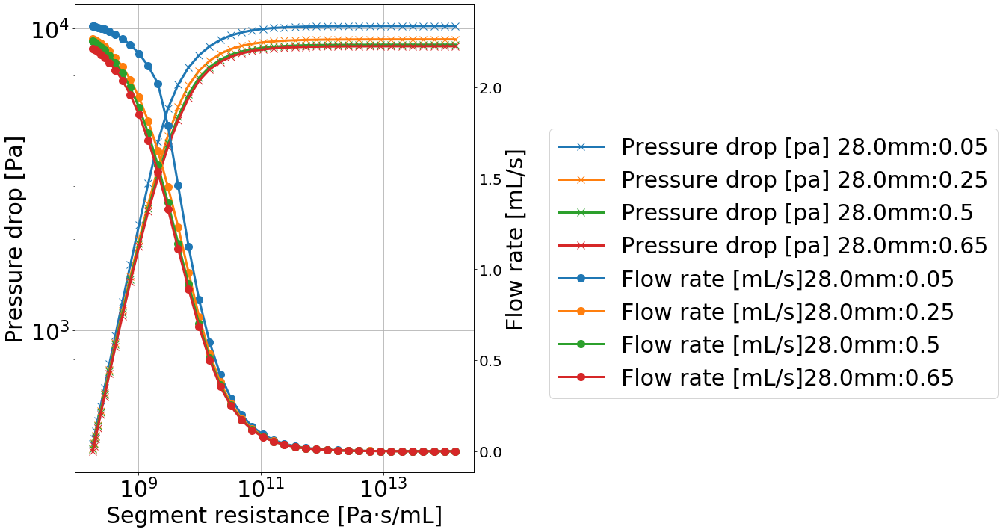

In [27]:
for index, length in enumerate(lengthoptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    ax2 = ax.twinx()

    for _, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
    ax.set_yscale('log')

    ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax2.tick_params(labelsize=20)
#     ax2.set_yscale('log')

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sScatter_dp_Q_Length%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot power

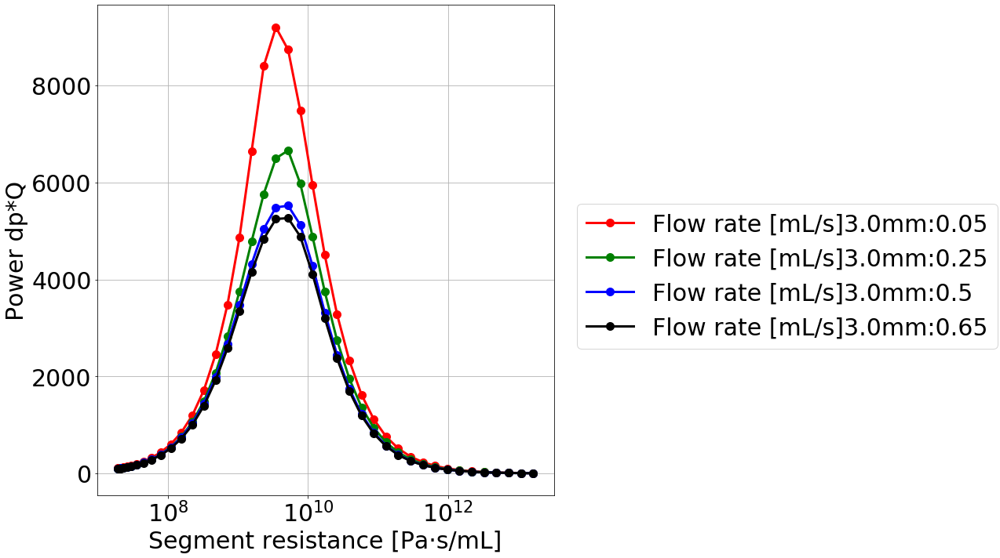

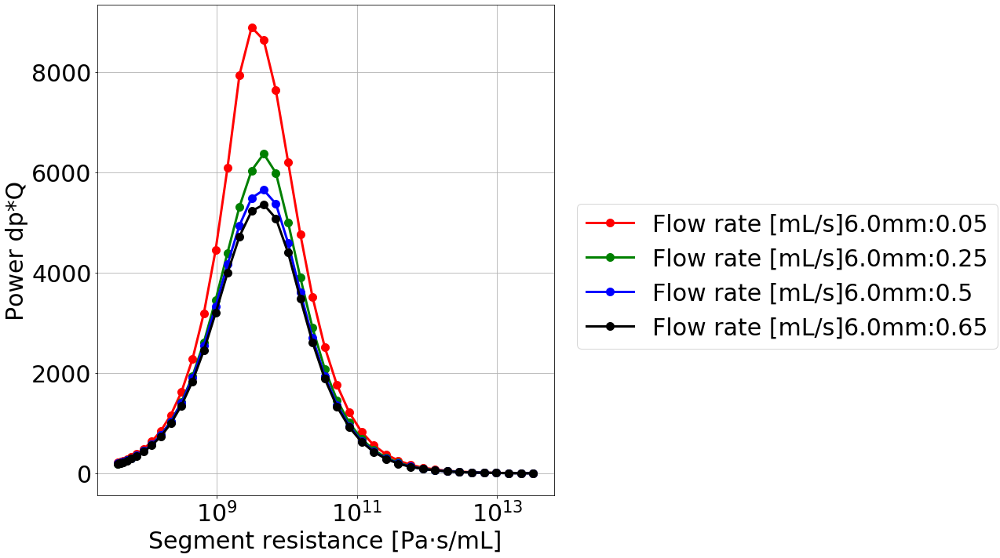

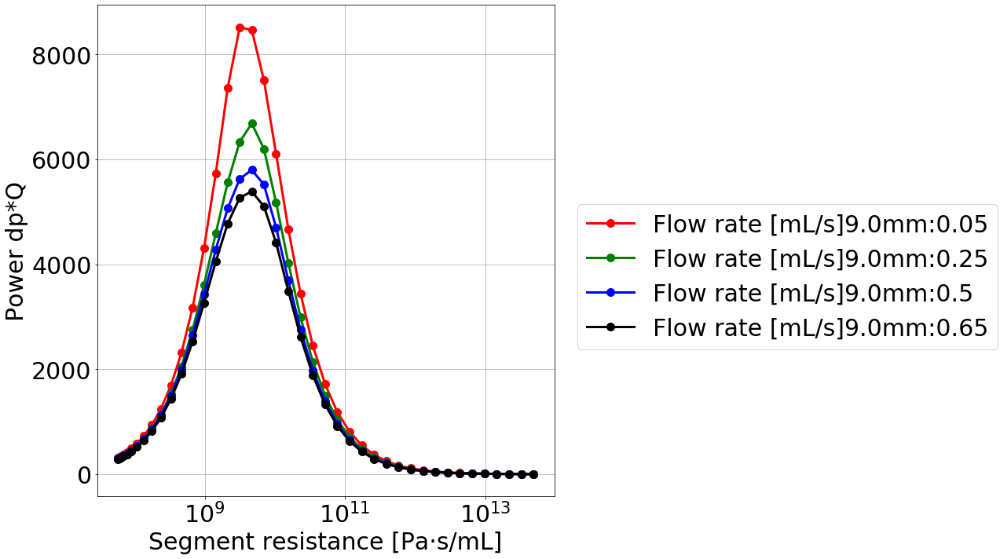

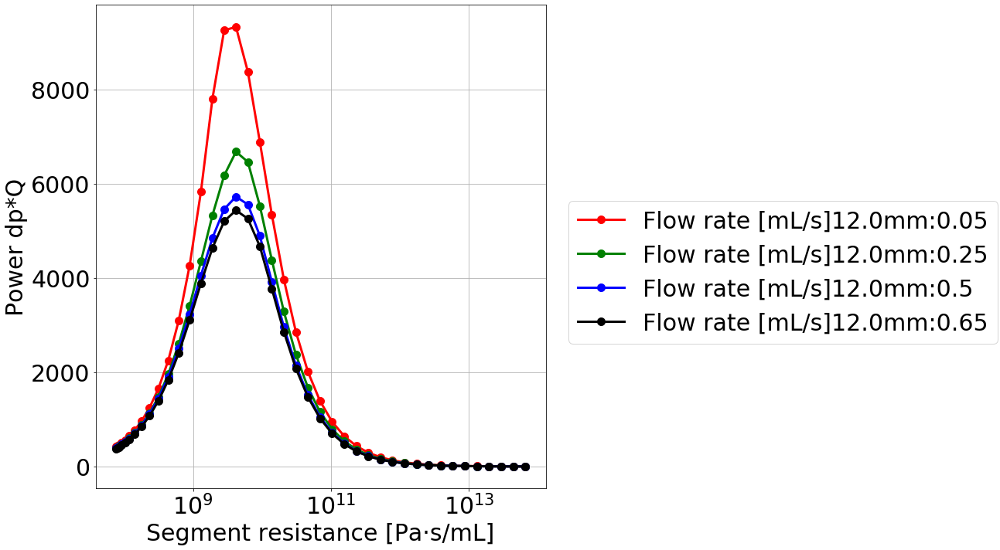

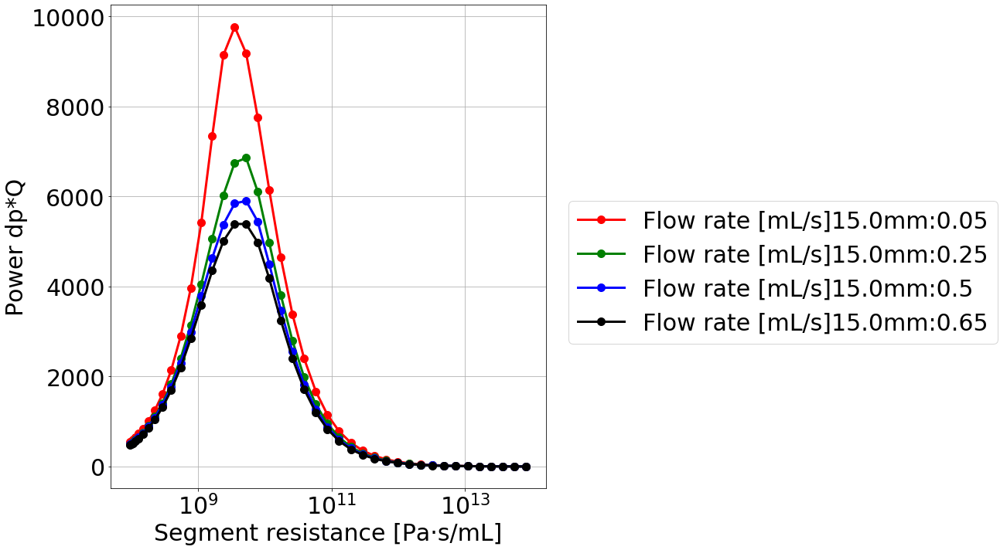

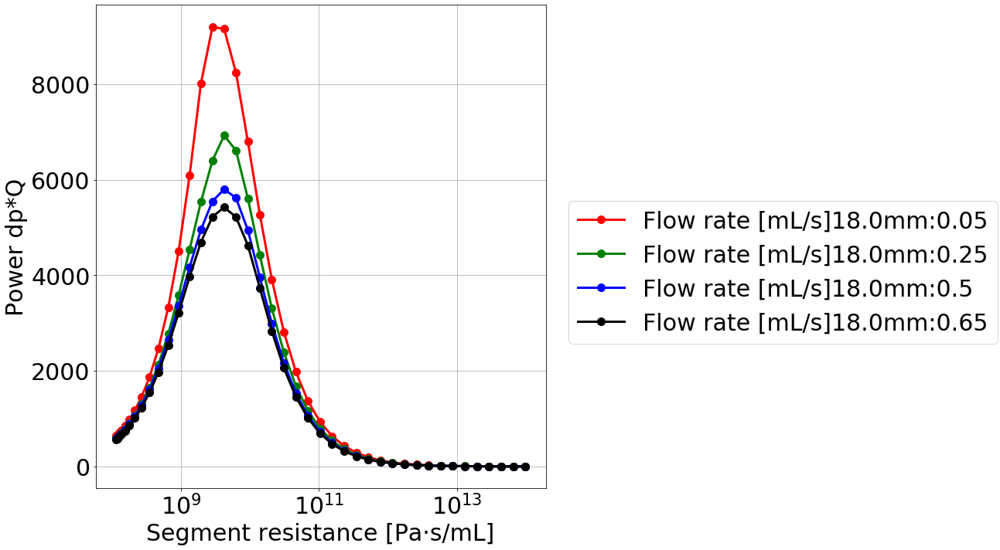

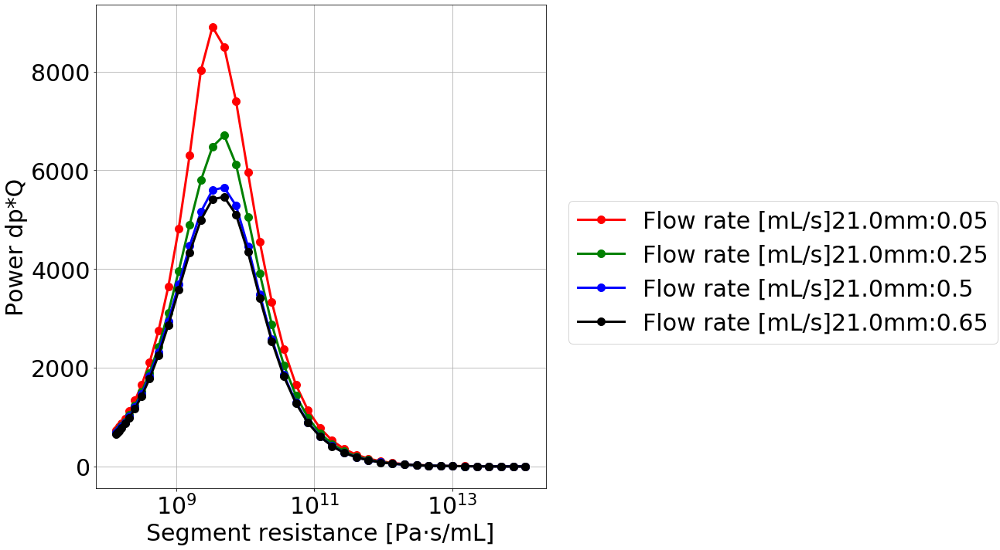

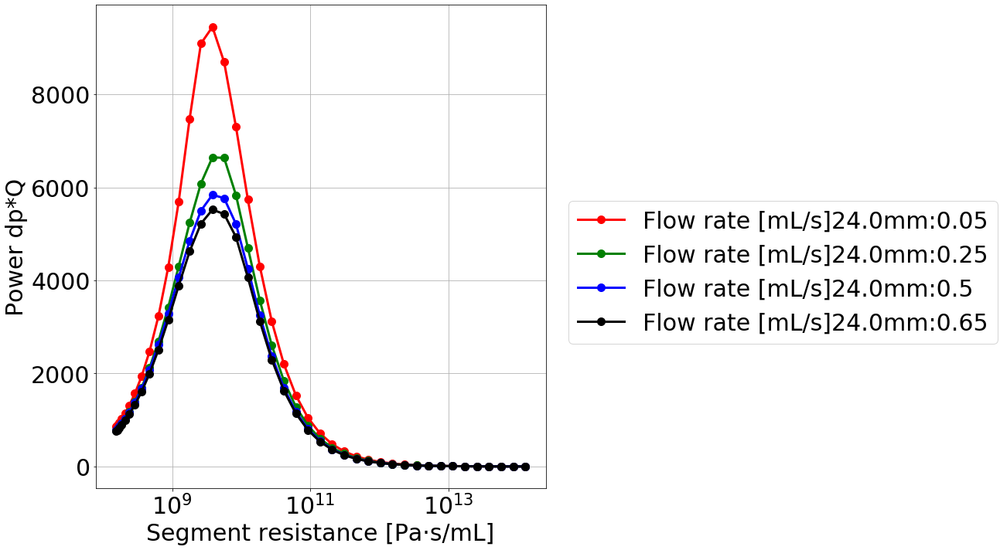

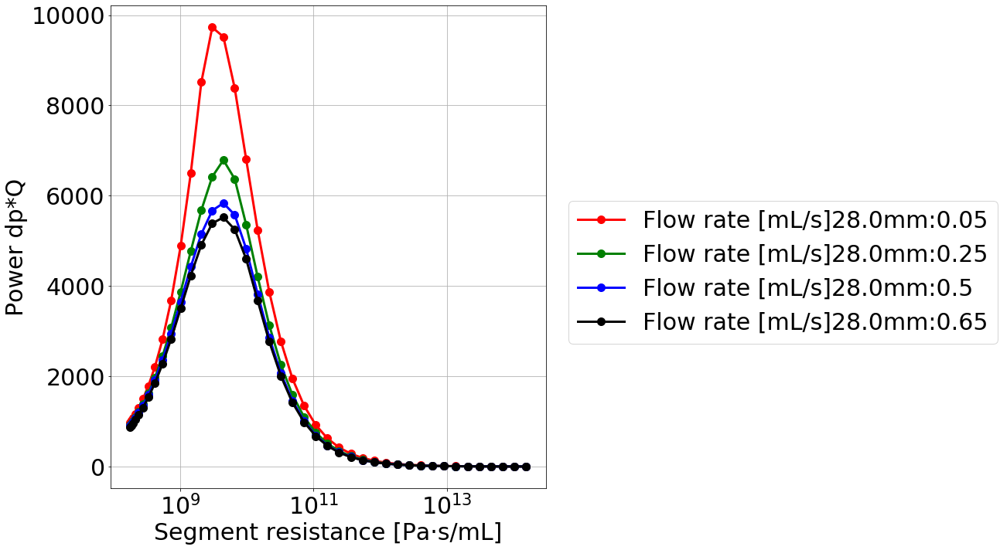

In [28]:
# for index, collateral in enumerate(collateraloptions):
for index, length in enumerate(lengthoptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    colours = ["red",'green',"blue","black","yellow","purple"]
#     ax2 = ax.twinx()
    
#     for index2, length in enumerate(lengthoptions):
    for index2, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

#         ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
        
        ax.plot(Permeability, flowrate*pressuredrop, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', color=colours[index2], linestyle = '-',linewidth=3, markersize=10)


    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Power dp*Q", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
    #     ax.set_yscale('log')

    # ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
    # ax2.tick_params(labelsize=20)
    #     ax2.set_yscale('log')

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sPower%s" % (OutputFolder,index), bbox_inches='tight')    
    #     plt.clf()
#     plt.cla()
#     plt.close()

### Plot power (merged)

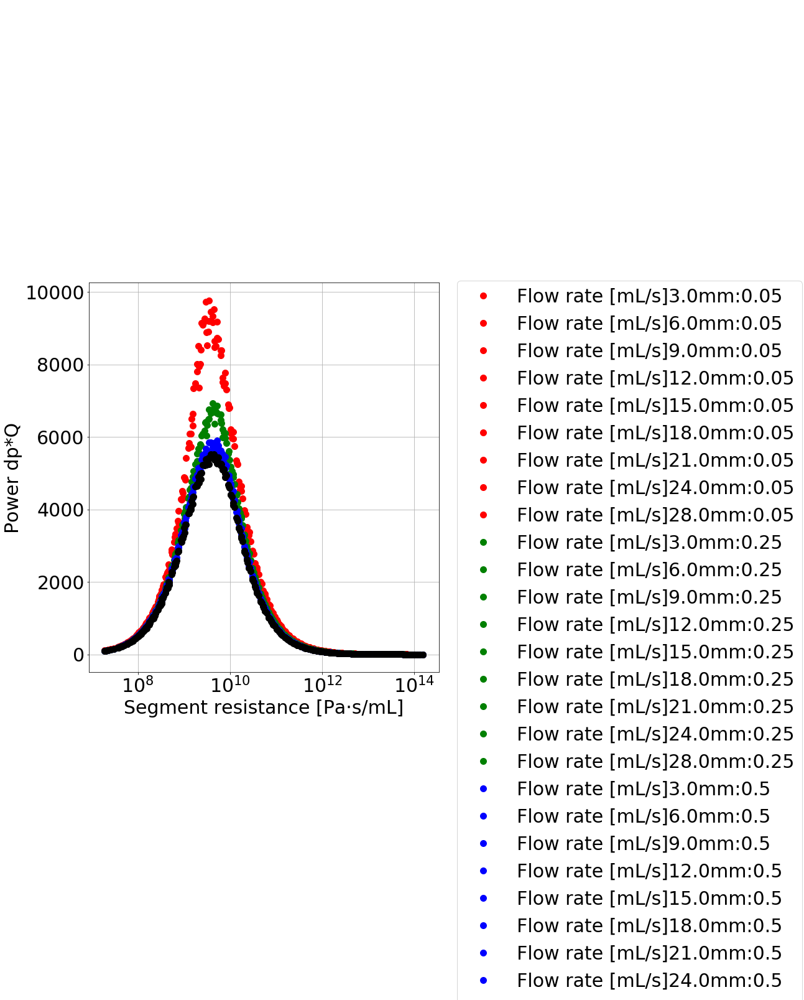

In [29]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
colours = ["red",'green',"blue","black","yellow","purple"]

for index, collateral in enumerate(collateraloptions):
# for index, length in enumerate(lengthoptions):

#     ax2 = ax.twinx()
    
    for _, length in enumerate(lengthoptions):
#     for _, collateral in enumerate(collateraloptions):
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

#         ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
        
        ax.plot(Permeability, flowrate*pressuredrop, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral), marker='o', color=colours[index], linestyle = 'none',linewidth=3, markersize=10)


ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Power dp*Q", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
#     ax.set_yscale('log')

# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)
#     ax2.set_yscale('log')

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sPower" % OutputFolder, bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot Q as function of R (all collaterals)

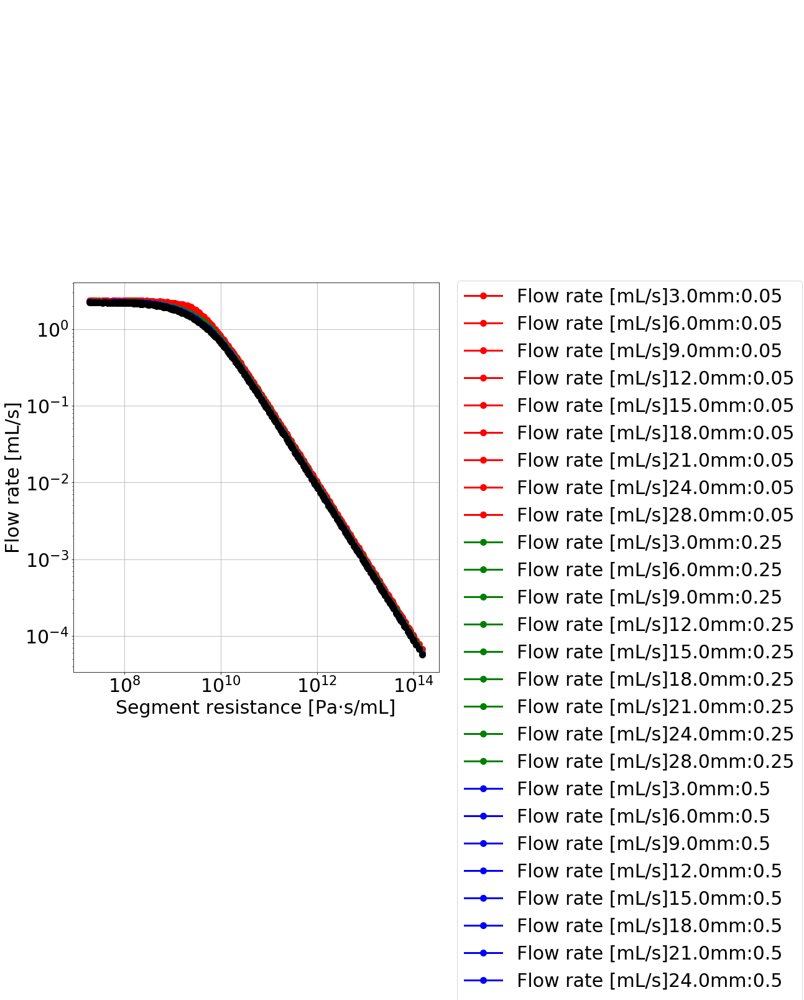

In [30]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","black","yellow","purple"]
for index, collateral in enumerate(collateraloptions):
    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

    #     ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm", marker='x', linewidth=3, markersize=10)
        ax.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)


ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
ax.set_yscale('log')


# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sResistance_Q_Collaterals_Merged" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close()  


### Plot dp as function of R (all collaterals)

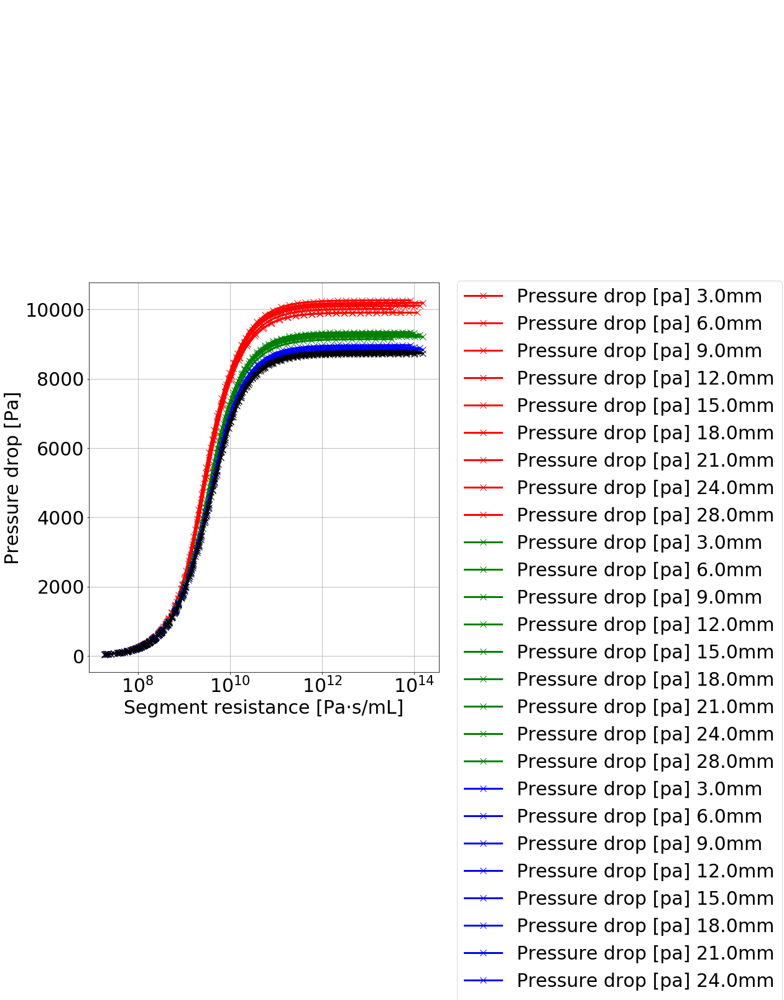

In [31]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","black","yellow","purple"]
for index, collateral in enumerate(collateraloptions):
    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm",color=colours[index], marker='x', linewidth=3, markersize=10)
#         ax.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)


ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')

# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sResistance_dp_Collaterals_Merged" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close()  

### Plot Q, dp as function of R (all collaterals)

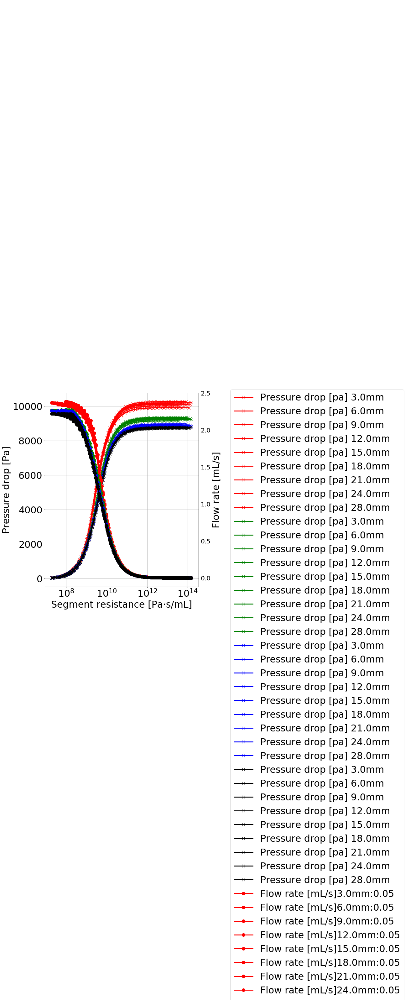

In [32]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
ax2 = ax.twinx()
colours = ["red",'green',"blue","black","yellow","purple"]
for index, collateral in enumerate(collateraloptions):
    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        pressuredrop = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Pressure drop [pa]"][2:]
        flowrate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]

        ax.plot(Permeability, pressuredrop, label="Pressure drop [pa] "+str(length)+"mm",color=colours[index], marker='x', linewidth=3, markersize=10)
        ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)


ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')

ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax2.tick_params(labelsize=20)

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sResistance_dp_Q_Collaterals_Merged" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

### Plot Q tissue as function of R, collaterals

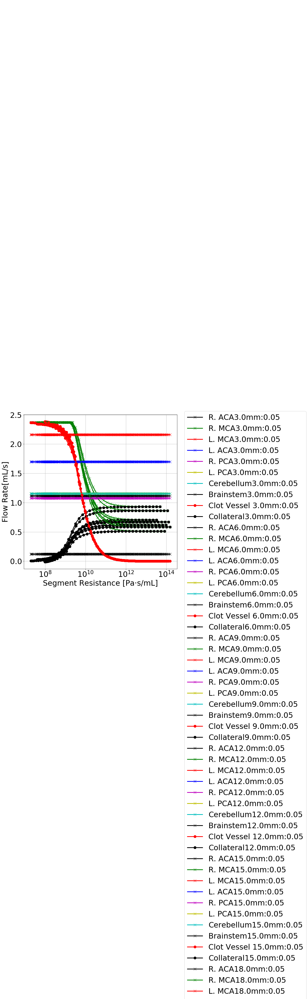

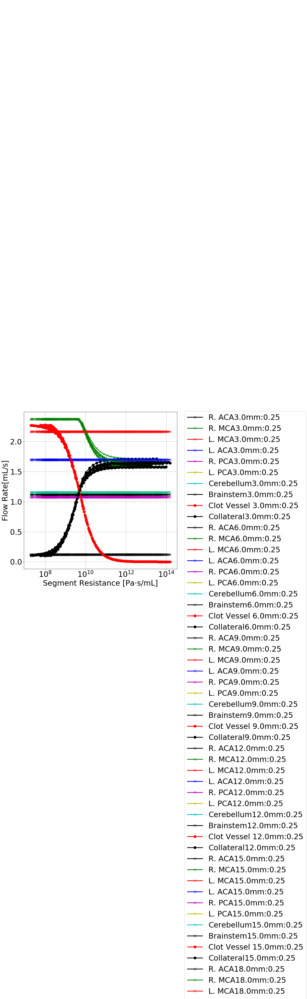

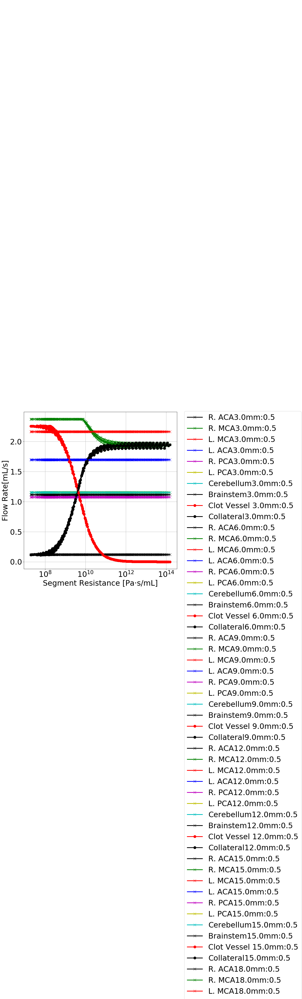

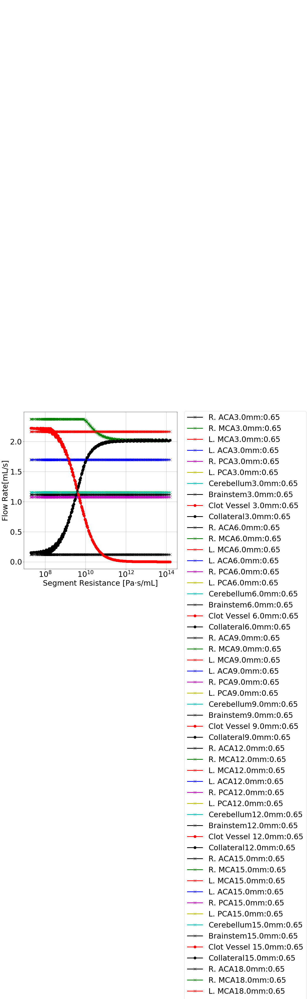

In [33]:
# Collateral flow rate
# subtract vessel flow from surface region flow for every simulation (if mapping is off, value can be negative)
# plot cerebral flow vs Resistance (Per collateral?)
# result["Cerebral flow rate [mL/s]"]

regions = ["R. ACA","R. MCA","L. MCA", "L. ACA","R. PCA","L. PCA","Cerebellum","Brainstem"]
colours = ["k","g","r","b","m","y",'c','k']
# region = "R. MCA"
# plots of clot time delay
for index, collateral in enumerate(collateraloptions):
        fig = plt.figure()
        fig.set_size_inches(10,10)
        ax = fig.add_subplot(111)
        # ax2 = ax.twinx()

        for length in lengthoptions:
            Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
            Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
            vesselflow = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]
            
            for region_index, region in enumerate(regions):
                flowrates = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)][region][2:]
                ax.plot(Resistance, flowrates, label=region+str(length)+"mm:"+str(collateral), color=colours[region_index], marker='x', linewidth=3, markersize=10)

    #         flow = pd.DataFrame(columns=regions)
    #         for index2, i in enumerate(flowrates.str.split(",")):
    #             flow.loc[index2]=i
            collateralflow = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Collateral flow"][2:]
    
#             ax.plot(Resistance, flowrates, label="Surface "+str(length)+"mm:"+str(collateral), color='b', marker='o', linewidth=3, markersize=10)
            
            ax.plot(Resistance, vesselflow, label="Clot Vessel "+str(length)+"mm:"+str(collateral), color="r", marker='o', linewidth=3, markersize=10)

            ax.plot(Resistance, collateralflow, label="Collateral"+str(length)+"mm:"+str(collateral), color="k", marker='o', linewidth=3, markersize=10)

    #         time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][1:]
    #         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][1:]

    #         ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
    #         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
    #         ax.plot(Resistance, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
    #         ax.plot(Resistance, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)

        ax.set_xlabel("Segment Resistance [Pa·s/mL]", fontsize=30)
        ax.set_ylabel("Flow Rate[mL/s]", fontsize=30)
        ax.tick_params(labelsize=30)
        ax.grid()
    #     ax.set_yscale('log')
        ax.set_xscale('log')

        # ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
        # ax2.tick_params(labelsize=20)
        # ax2.semilogy()

        fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
        plt.tight_layout()
        plt.show()
        fig.savefig("%sResistance_Regionflow%s" % (OutputFolder,index), bbox_inches='tight')    
    #     plt.clf()
    #     plt.cla()
    #     plt.close()
    

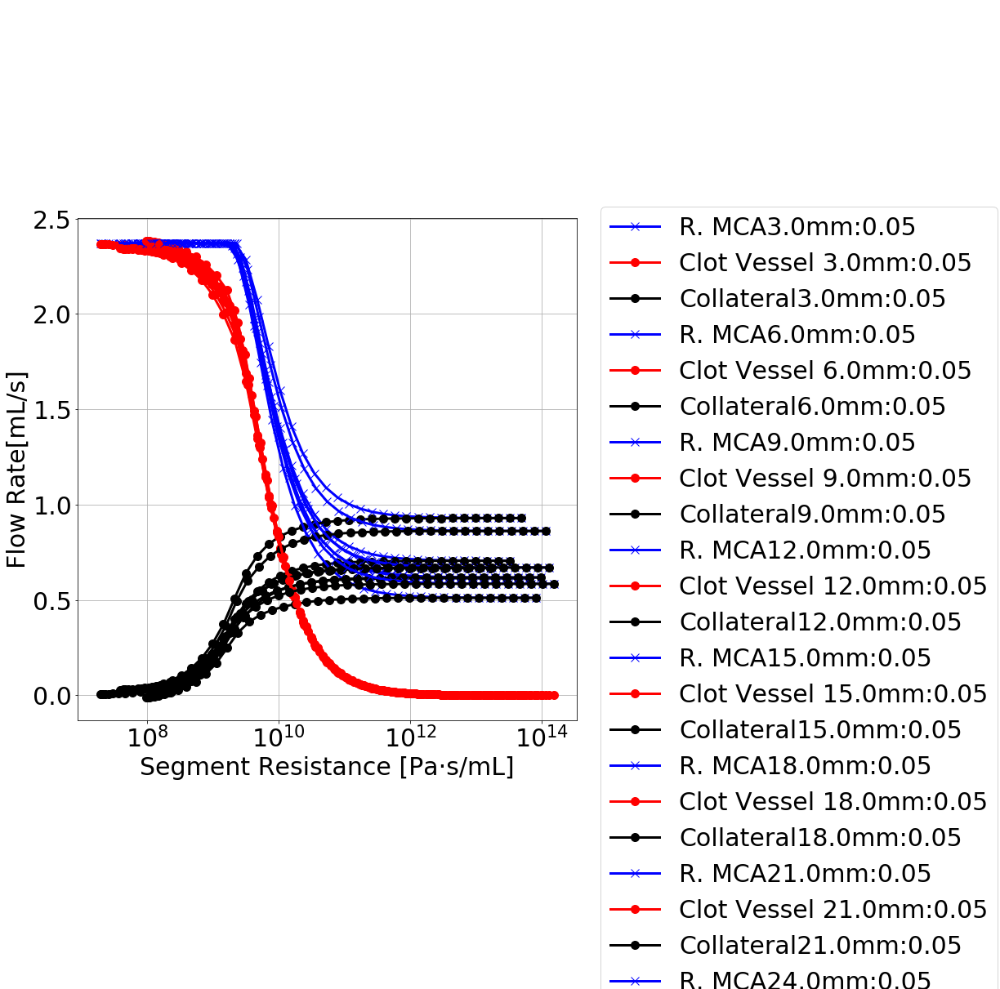

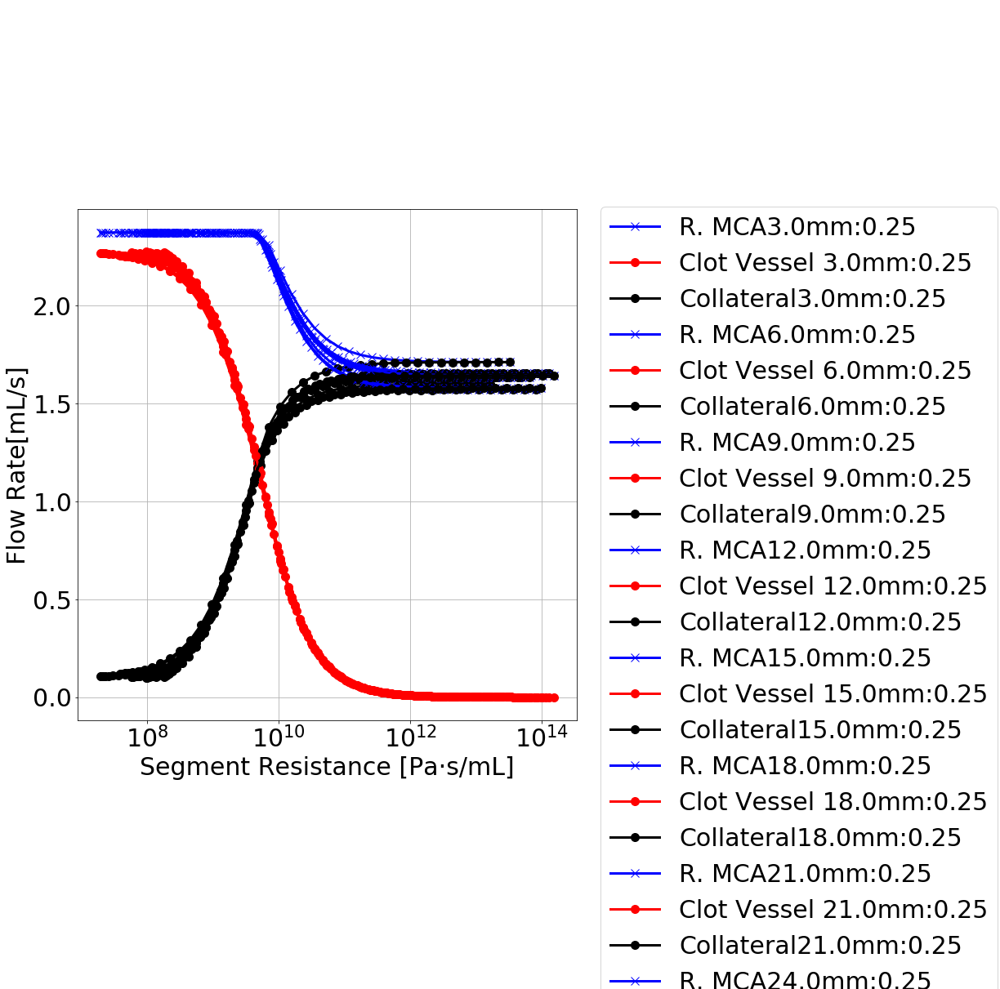

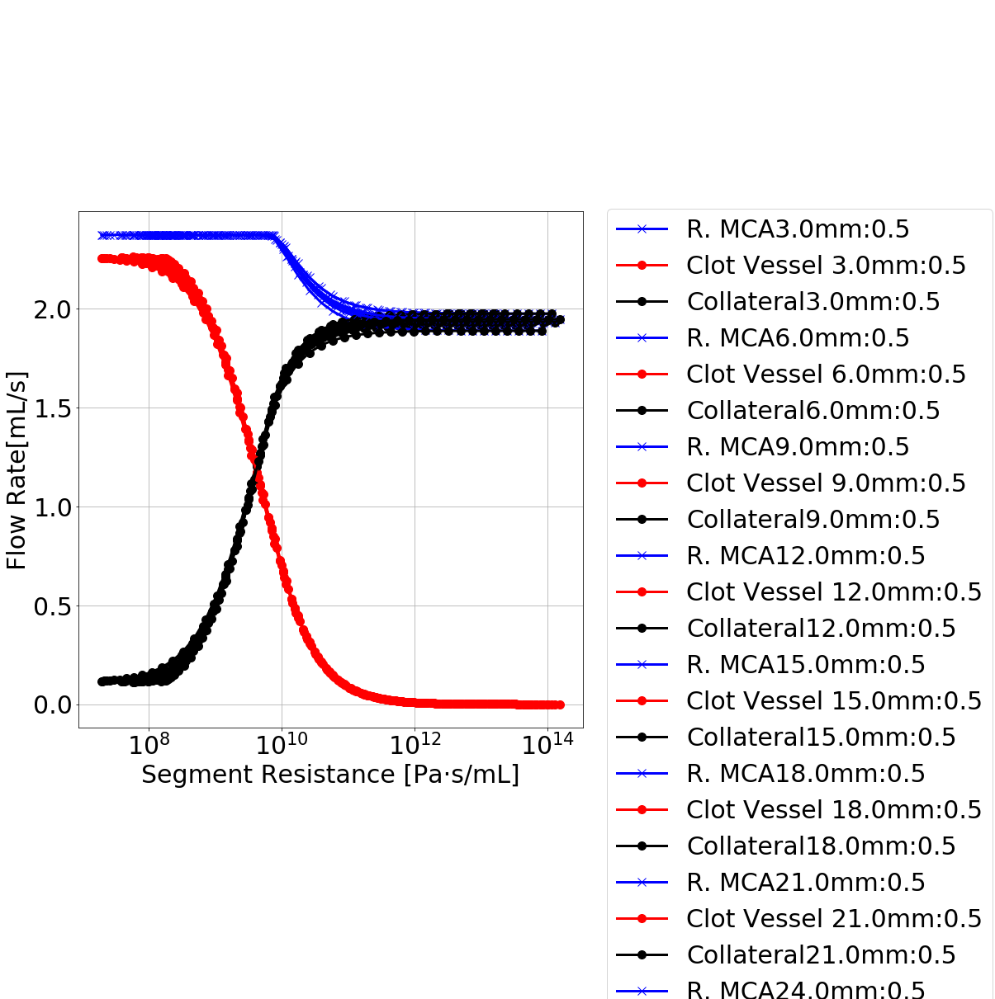

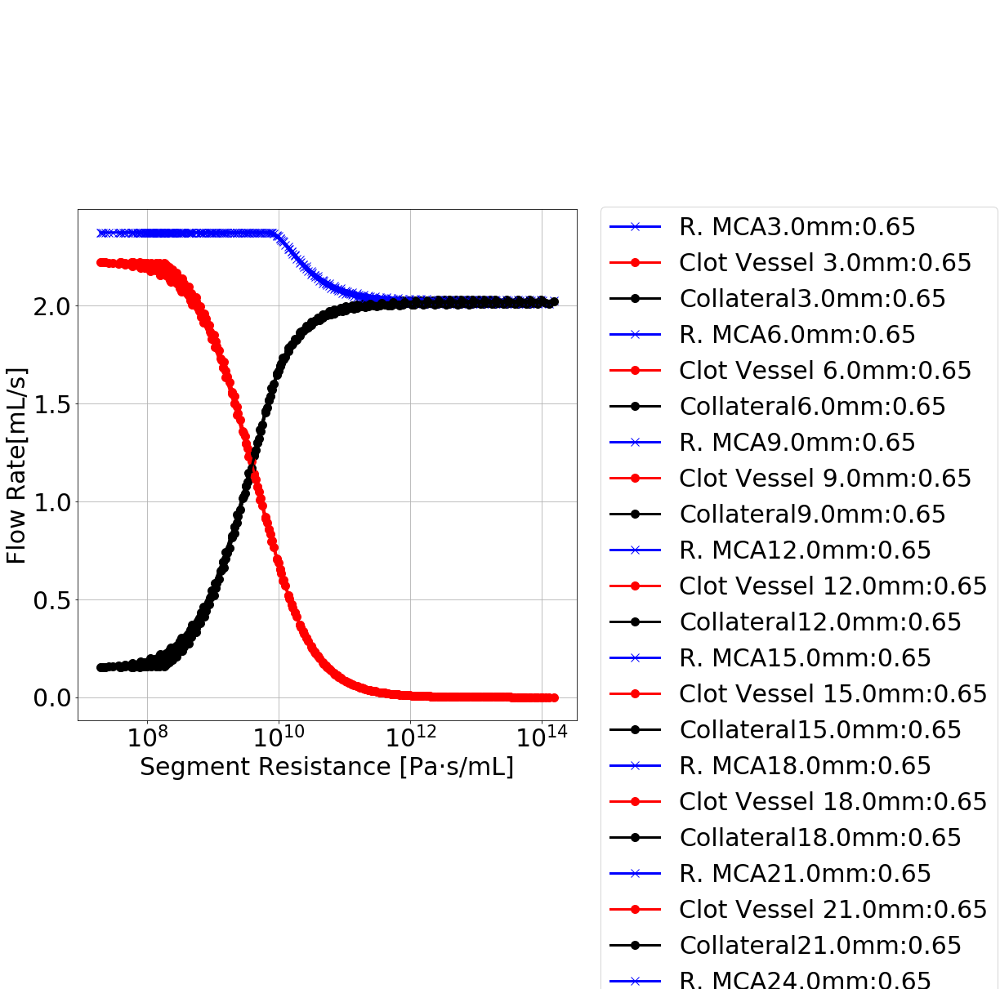

In [34]:
# Collateral flow rate
# subtract vessel flow from surface region flow for every simulation (if mapping is off, value can be negative)
# plot cerebral flow vs Resistance (Per collateral?)
# result["Cerebral flow rate [mL/s]"]

regions = ["R. ACA","R. MCA","L. MCA", "L. ACA","R. PCA","L. PCA","Cerebellum","Brainstem"]
colours = ["k","g","r","b","m","y",'c','k']
region = "R. MCA"
# plots of clot time delay
for index, collateral in enumerate(collateraloptions):
        fig = plt.figure()
        fig.set_size_inches(10,10)
        ax = fig.add_subplot(111)
        # ax2 = ax.twinx()

        for length in lengthoptions:
            Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
            Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
            vesselflow = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Flow rate [mL/s]"][2:]
            
#             for region_index, region in enumerate(regions):
            flowrates = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)][region][2:]
            ax.plot(Resistance, flowrates, label=region+str(length)+"mm:"+str(collateral), color='b', marker='x', linewidth=3, markersize=10)

    #         flow = pd.DataFrame(columns=regions)
    #         for index2, i in enumerate(flowrates.str.split(",")):
    #             flow.loc[index2]=i
            collateralflow = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Collateral flow"][2:]
    
#             ax.plot(Resistance, flowrates, label="Surface "+str(length)+"mm:"+str(collateral), color='b', marker='o', linewidth=3, markersize=10)
            
            ax.plot(Resistance, vesselflow, label="Clot Vessel "+str(length)+"mm:"+str(collateral), color="r", marker='o', linewidth=3, markersize=10)

            ax.plot(Resistance, collateralflow, label="Collateral"+str(length)+"mm:"+str(collateral), color="k", marker='o', linewidth=3, markersize=10)

    #         time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][1:]
    #         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][1:]

    #         ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
    #         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
    #         ax.plot(Resistance, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
    #         ax.plot(Resistance, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)

        ax.set_xlabel("Segment Resistance [Pa·s/mL]", fontsize=30)
        ax.set_ylabel("Flow Rate[mL/s]", fontsize=30)
        ax.tick_params(labelsize=30)
        ax.grid()
    #     ax.set_yscale('log')
        ax.set_xscale('log')

        # ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
        # ax2.tick_params(labelsize=20)
        # ax2.semilogy()

        fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
        plt.tight_layout()
        plt.show()
        fig.savefig("%sResistance_collateralflow%s" % (OutputFolder,index), bbox_inches='tight')    
    #     plt.clf()
    #     plt.cla()
    #     plt.close()
    

### Plot dt as function of k

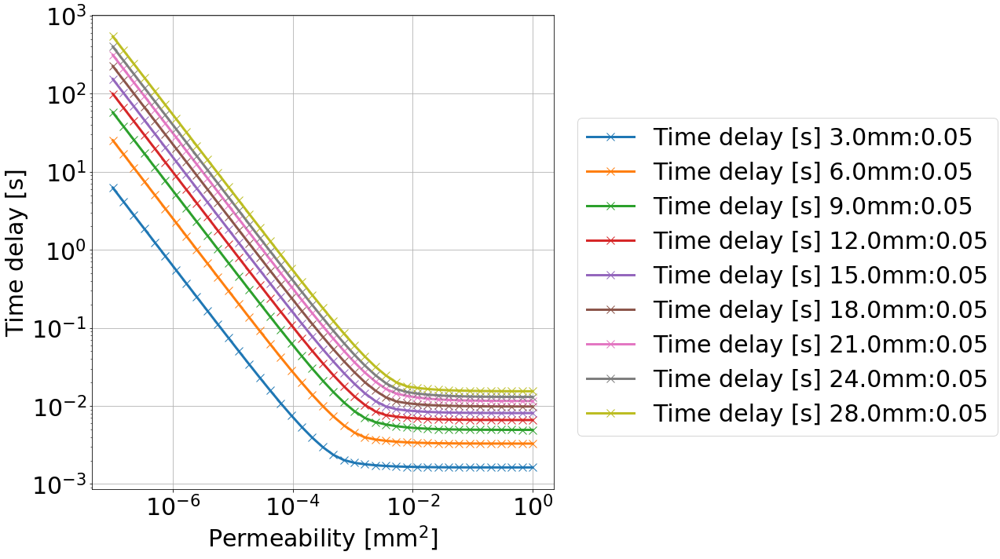

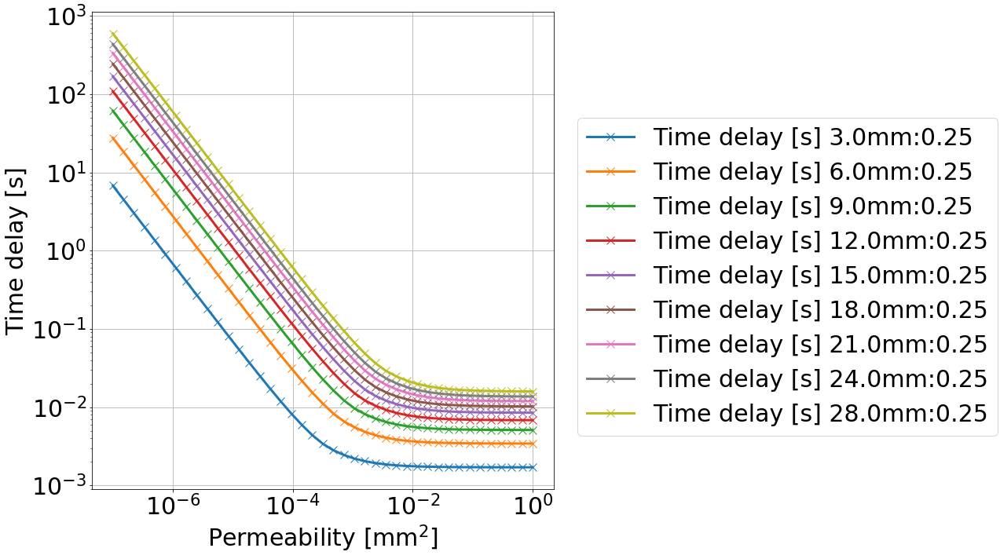

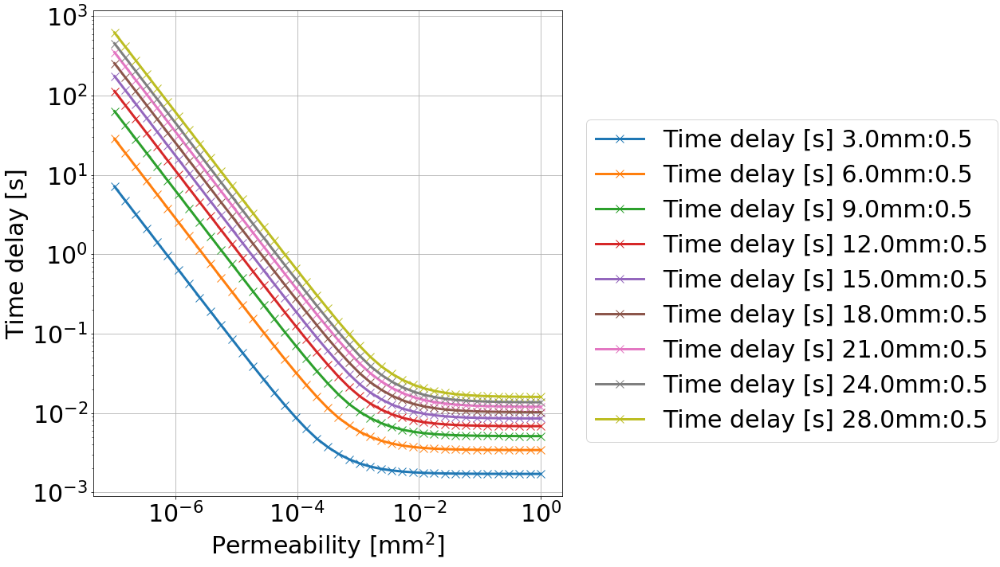

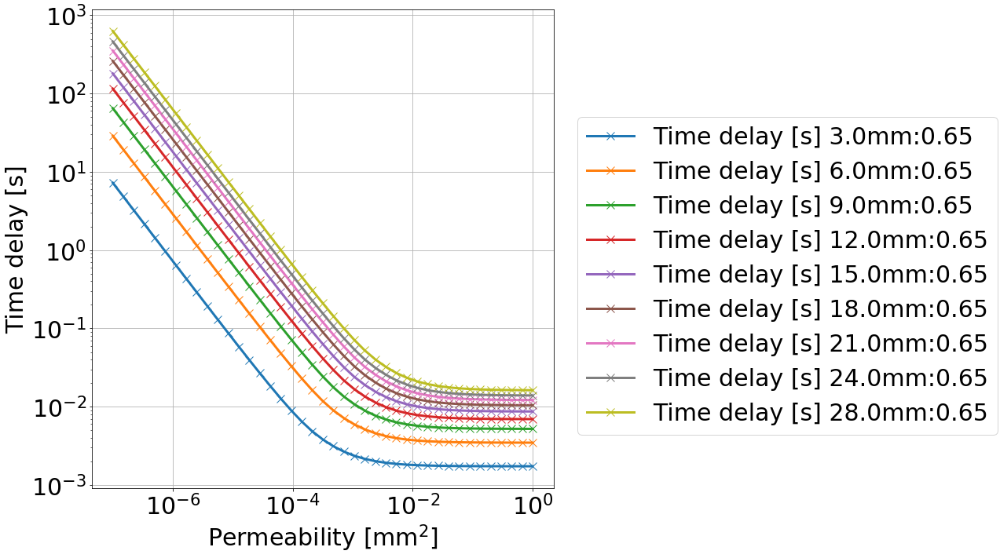

In [35]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
        time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][2:]
#         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][2:]

        ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Permeability [mm$^2$]", fontsize=30)
    ax.set_ylabel("Time delay [s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')

    # ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
    # ax2.tick_params(labelsize=20)
    # ax2.semilogy()

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sPermeability_dt_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()

### Plot dt as function of R

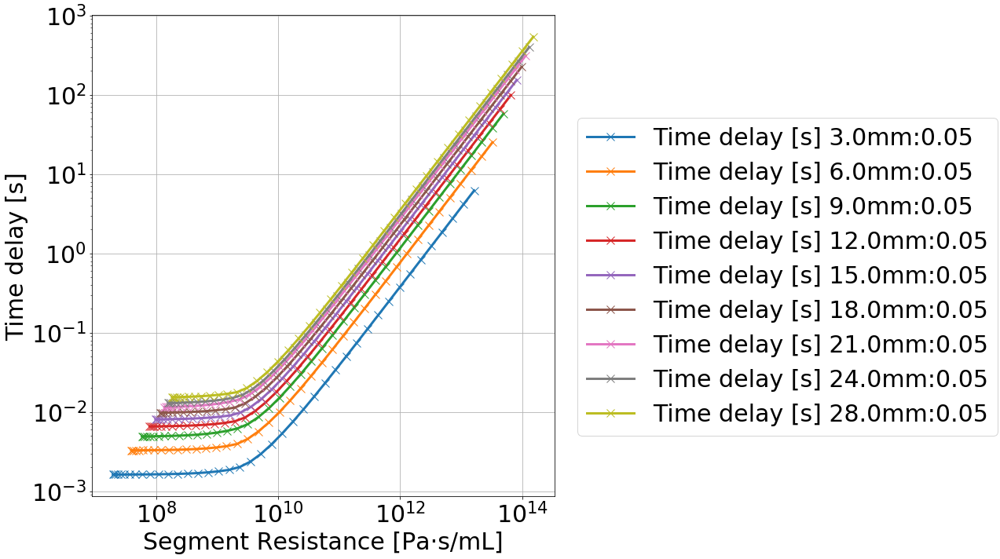

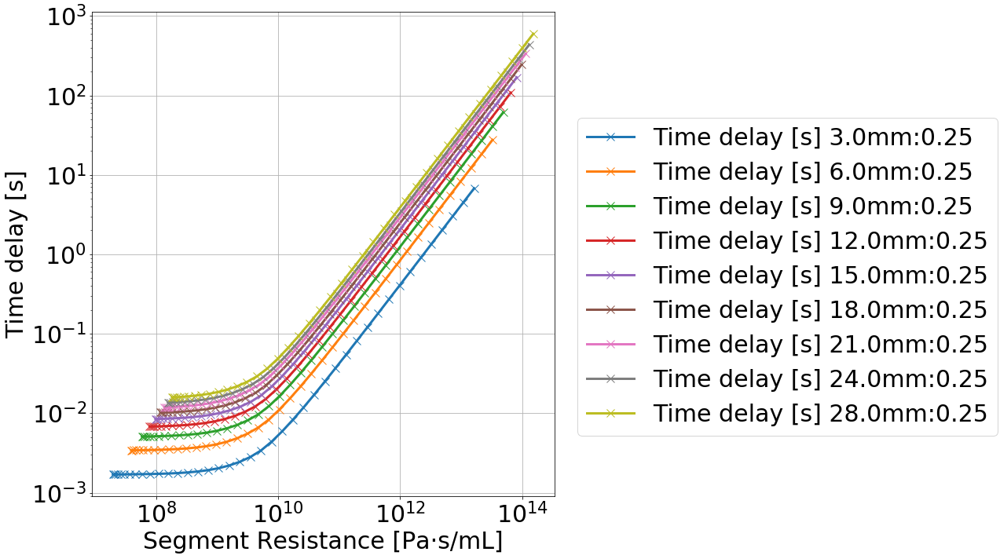

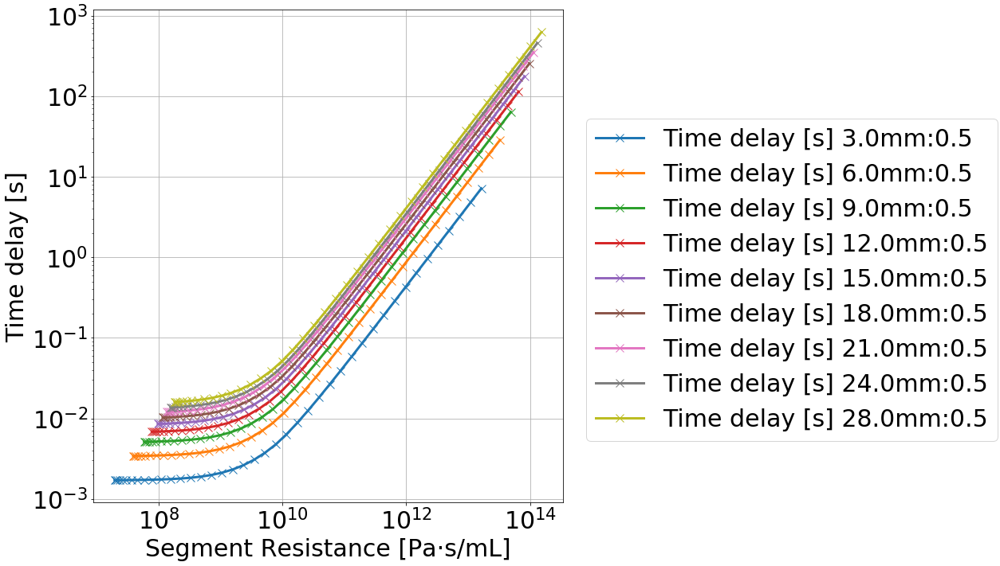

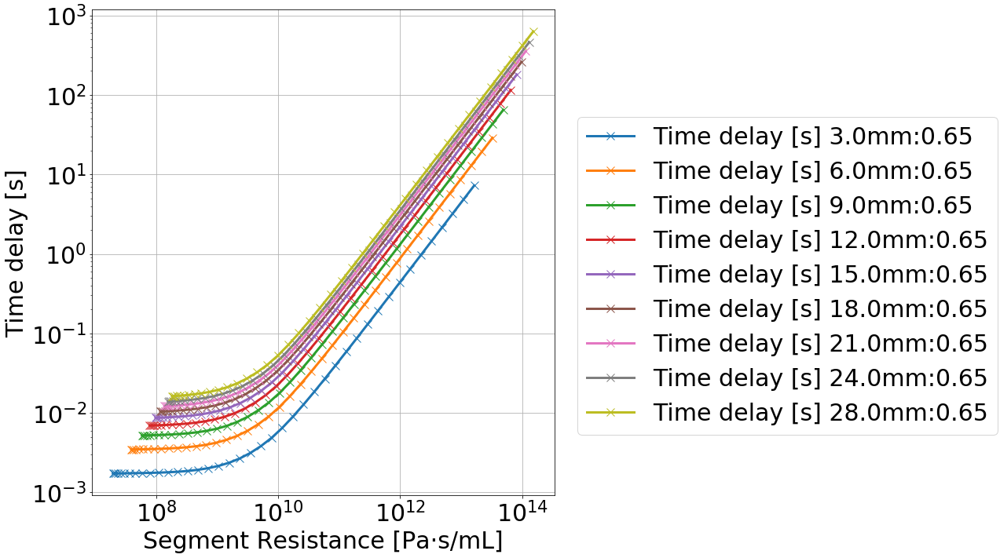

In [36]:
# plots of clot time delay
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
        Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]

#         clot_lengths=result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot Length"][2:]

        time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][2:]
#         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][2:]

#         ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
        ax.plot(Resistance, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Resistance, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment Resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Time delay [s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')

    # ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
    # ax2.tick_params(labelsize=20)
    # ax2.semilogy()

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_dt_clot_Collateral%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()


### Plot dt as function of R/L

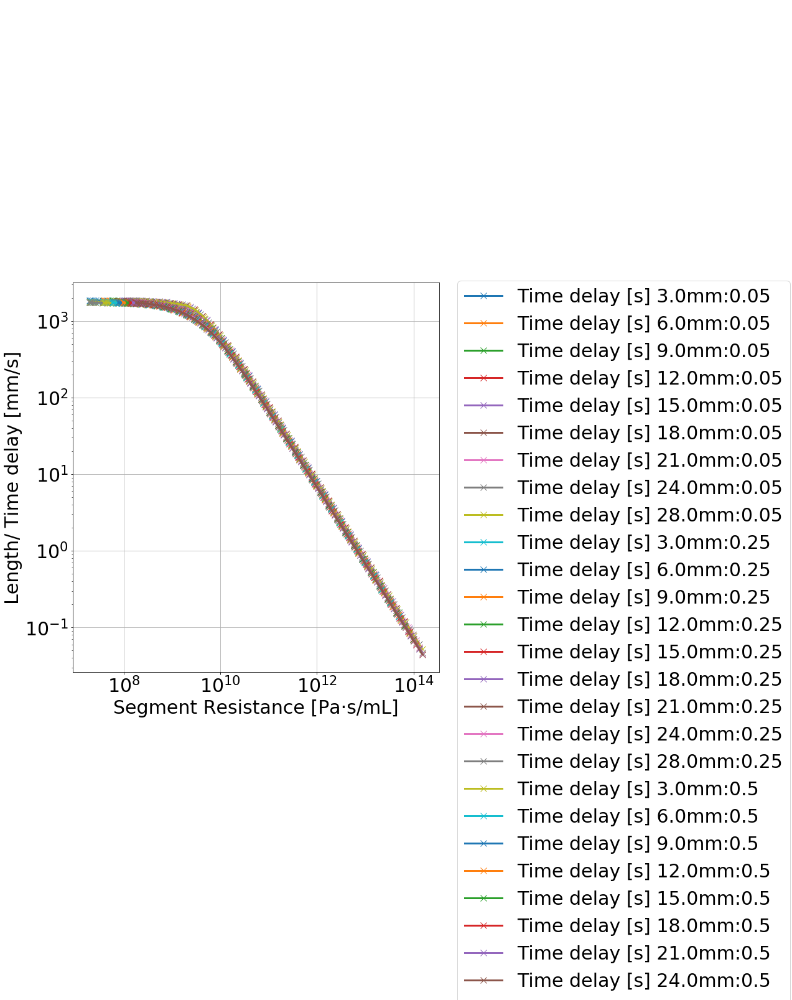

In [37]:
# plots of clot time delay
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

for index, collateral in enumerate(collateraloptions):

    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
        Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]

        clot_lengths=result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot Length"][2:]

        time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][2:]
#         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][2:]

#         ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
        ax.plot(Resistance, clot_lengths/time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Resistance, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


ax.set_xlabel("Segment Resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Length/ Time delay [mm/s]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_yscale('log')
ax.set_xscale('log')

# ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
# ax2.tick_params(labelsize=20)
# ax2.semilogy()

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sResistance_dt_clot_CollateralAll" % OutputFolder, bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()


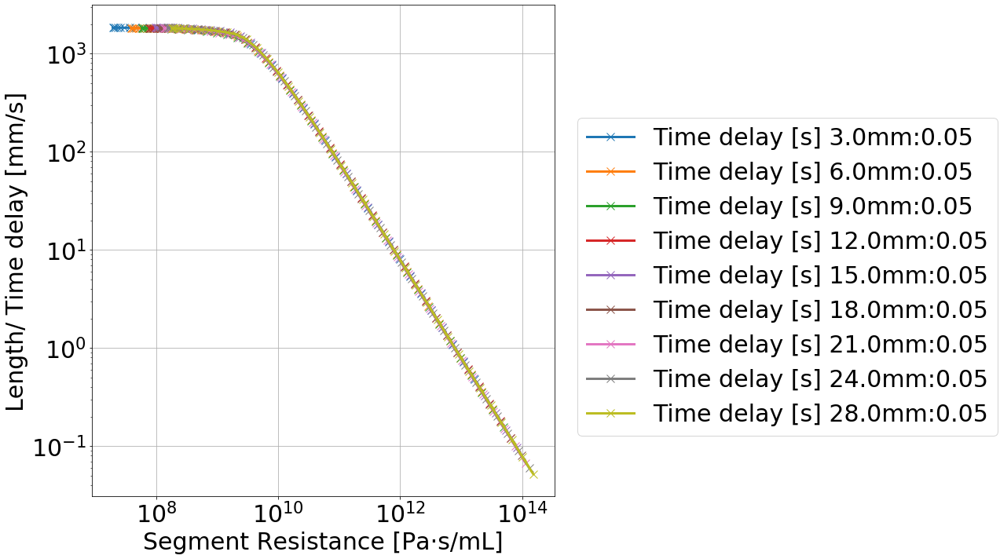

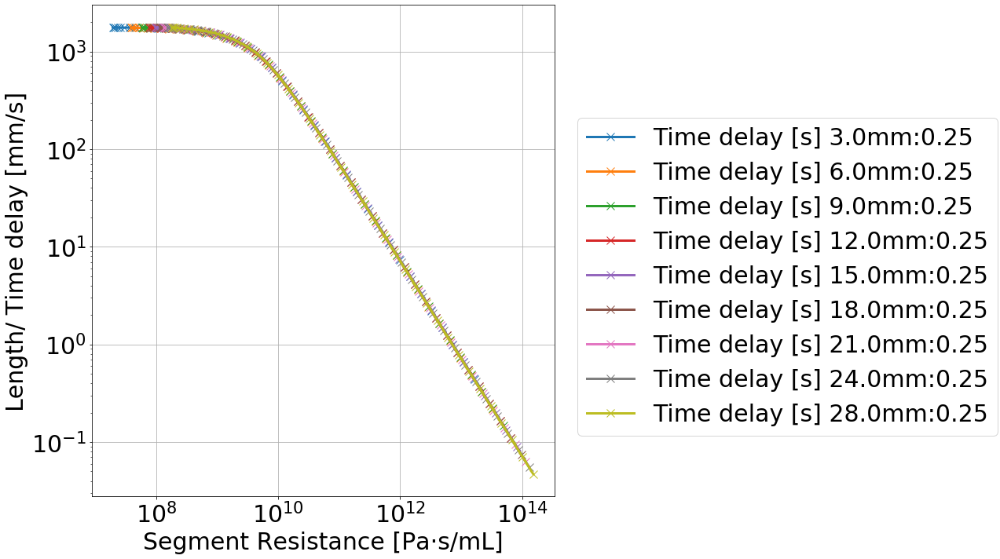

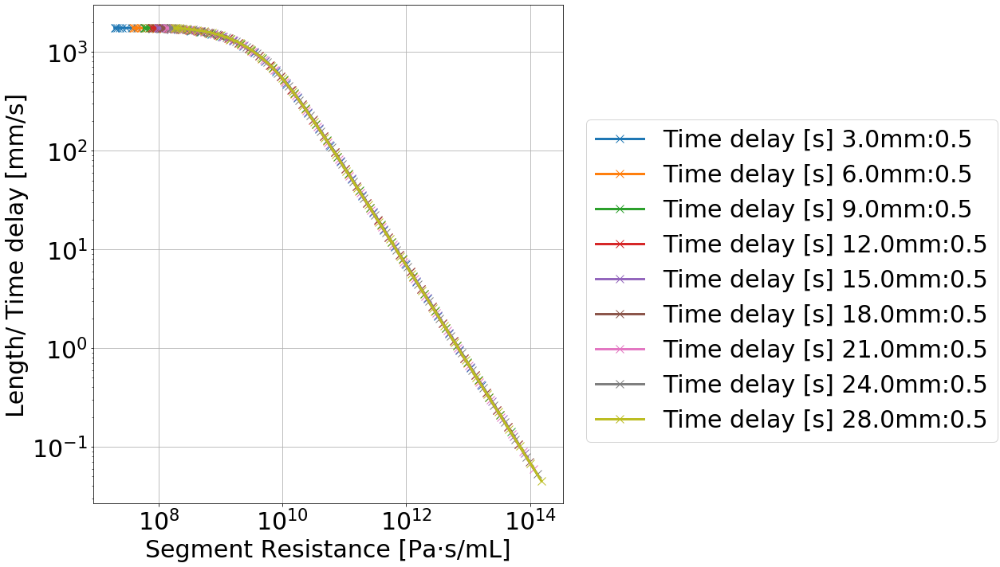

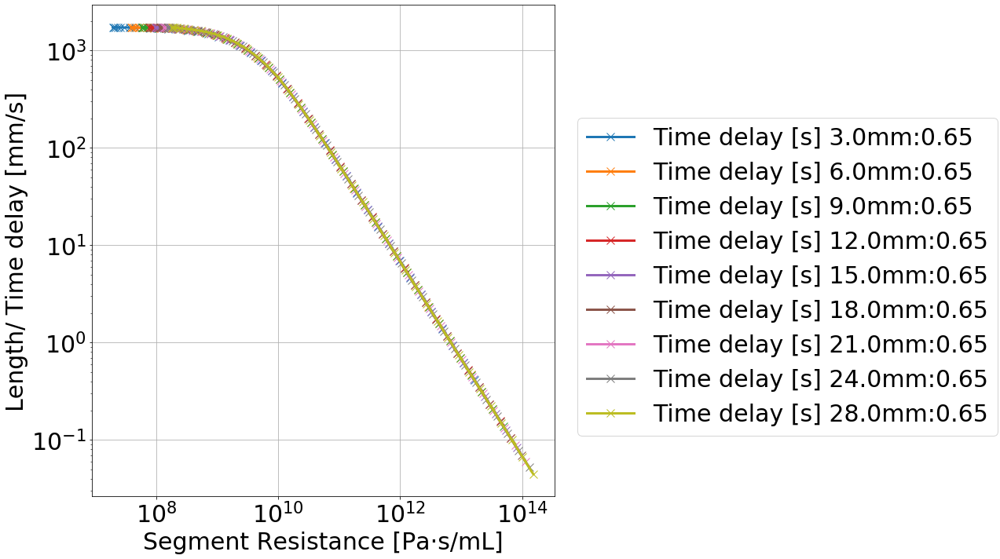

In [38]:
# plots of clot time delay
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
    # ax2 = ax.twinx()

    for length in lengthoptions:
        Permeability = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Permeability [mm^2]"][2:]
        Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]

        clot_lengths=result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot Length"][2:]

        time_delay = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay [s]"][2:]
#         time_delay_bif = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Time delay bifurcation [s]"][2:]

#         ax.plot(Permeability, time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Permeability, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)
        ax.plot(Resistance, clot_lengths/time_delay, label="Time delay [s] "+str(length)+"mm:"+str(collateral), marker='x', linewidth=3, markersize=10)
#         ax.plot(Resistance, time_delay_bif, label="Time delay bifurcation [s] "+str(length)+"mm:"+str(collateral), marker='o', linewidth=3, markersize=10)


    ax.set_xlabel("Segment Resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Length/ Time delay [mm/s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')

    # ax2.set_ylabel("Time delay bifurcation [s]", fontsize=30)
    # ax2.tick_params(labelsize=20)
    # ax2.semilogy()

    fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sResistance_Ldt_clot_Collaterals%s" % (OutputFolder,index), bbox_inches='tight')    
#     plt.clf()
#     plt.cla()
#     plt.close()


### Plot Infarct volume as function of collaterals and resistance

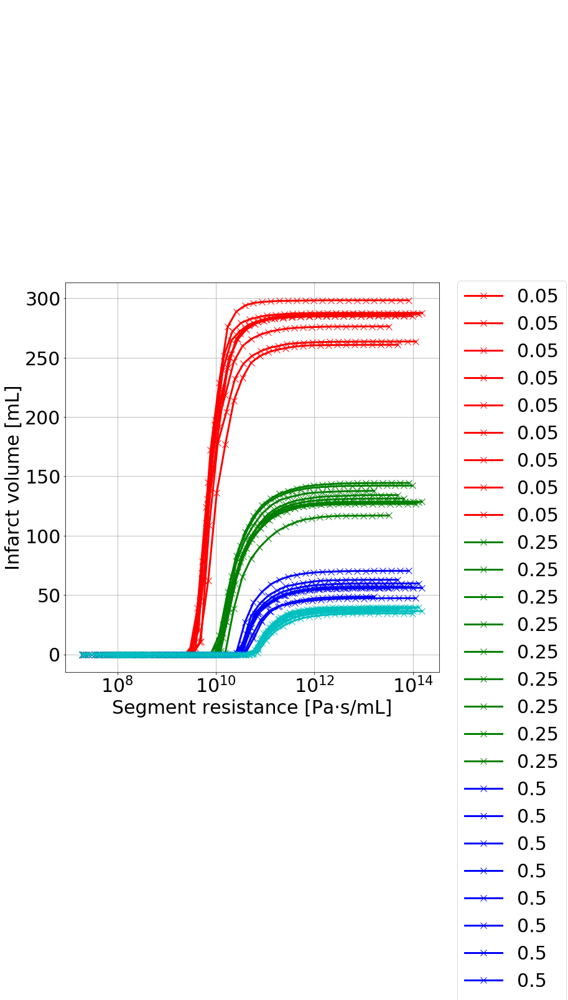

In [39]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
for index, collateral in enumerate(collateraloptions):
    for length in lengthoptions:
        Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
        IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
        ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
#         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Infarct volume [mL]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')

# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)

fig.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sResistance_IV_clot_Collaterals" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

# Interpolate data

In [40]:
R_min = 1e7
R_max = 1e14
R_min_log = np.log10(R_min)
R_max_log = np.log10(R_max)

interpolation_sets = []
for index, collateral in enumerate(collateraloptions):
    interpolation_col_IV = []
    interpolation_col_dp = []
    interpolation_col_Q = []
    interpolation_col_ColQ = []
    for length in lengthoptions:
        resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:].tolist()
        IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:].tolist()        
        pressure_drop= result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]['Pressure drop [pa]'][2:].tolist()        
        flow_rate= result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]['Flow rate [mL/s]'][2:].tolist()        
        
        collateral_flow_rate = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]['Collateral flow'][2:].tolist()        

        #add limits to keep interpolation doable
        IV_min = IV[-1]
        IV_max = IV[0]
        IV.append(IV_min)
        IV.append(IV_max)        
        
        pressure_drop_min = pressure_drop[-1]
        pressure_drop_max = pressure_drop[0]
        pressure_drop.append(pressure_drop_min)
        pressure_drop.append(pressure_drop_max)
        
        flow_rate_min = flow_rate[-1]
        flow_rate_max = flow_rate[0]
        flow_rate.append(flow_rate_min)
        flow_rate.append(flow_rate_max)        
        
        resistance.append(R_min)
        resistance.append(R_max)
        
        collateral_flow_rate_min = collateral_flow_rate[-1]
        collateral_flow_rate_max = collateral_flow_rate[0]
        collateral_flow_rate.append(collateral_flow_rate_min)
        collateral_flow_rate.append(collateral_flow_rate_max)           
        
        f = interpolate.interp1d(resistance, IV)
        f2 = interpolate.interp1d(resistance, pressure_drop)
        f3 = interpolate.interp1d(resistance, flow_rate)
        f4 = interpolate.interp1d(resistance, collateral_flow_rate)
        interpolation_col_IV.append(f)
        interpolation_col_dp.append(f2)
        interpolation_col_Q.append(f3)
        interpolation_col_ColQ.append(f4)
    interpolation_sets.append((interpolation_col_IV,interpolation_col_dp,interpolation_col_Q,interpolation_col_ColQ))    
    
# interpolate all data and calculate mean, std
R_range = np.logspace(R_min_log,R_max_log,100)
iv_mean_std = []
dp_mean_std = []
q_mean_std = []
colq_mean_std = []
totalflow_mean_std = []
for int_set in interpolation_sets:
    IV, dp, Q, colQ = int_set
    interpolated_IV = [fun(R_range) for fun in IV]
    interpolated_dp = [fun(R_range) for fun in dp]
    interpolated_Q = [fun(R_range) for fun in Q]
    interpolated_colQ = [fun(R_range) for fun in colQ]
    
    iv_mean = np.mean(np.stack(interpolated_IV, axis=0),axis=0)
    dp_mean = np.mean(np.stack(interpolated_dp, axis=0),axis=0)
    q_mean = np.mean(np.stack(interpolated_Q, axis=0),axis=0)
    colq_mean = np.mean(np.stack(interpolated_colQ, axis=0),axis=0)
    
    iv_std = np.std(np.stack(interpolated_IV, axis=0),axis=0)
    dp_std = np.std(np.stack(interpolated_dp, axis=0),axis=0)
    q_std = np.std(np.stack(interpolated_Q, axis=0),axis=0)
    colq_std = np.std(np.stack(interpolated_colQ, axis=0),axis=0)
    
    total_flow = np.stack(interpolated_colQ, axis=0)+np.stack(interpolated_Q, axis=0)
    total_flow_mean = np.mean(total_flow,axis=0)
    total_flow_std = np.std(total_flow,axis=0)
    
    iv_mean_std.append((iv_mean,iv_std))
    dp_mean_std.append((dp_mean,dp_std))
    q_mean_std.append((q_mean,q_std))
    colq_mean_std.append((colq_mean,colq_std))
    totalflow_mean_std.append((total_flow_mean,total_flow_std))

mean_interp_RfromQ = [interpolate.interp1d(i,R_range) for i,_ in q_mean_std]
mean_interp_IVfromR = [interpolate.interp1d(R_range,i) for i,_ in iv_mean_std]
mean_interp_dpfromR = [interpolate.interp1d(R_range,i) for i,_ in dp_mean_std]

## Plot interpolations

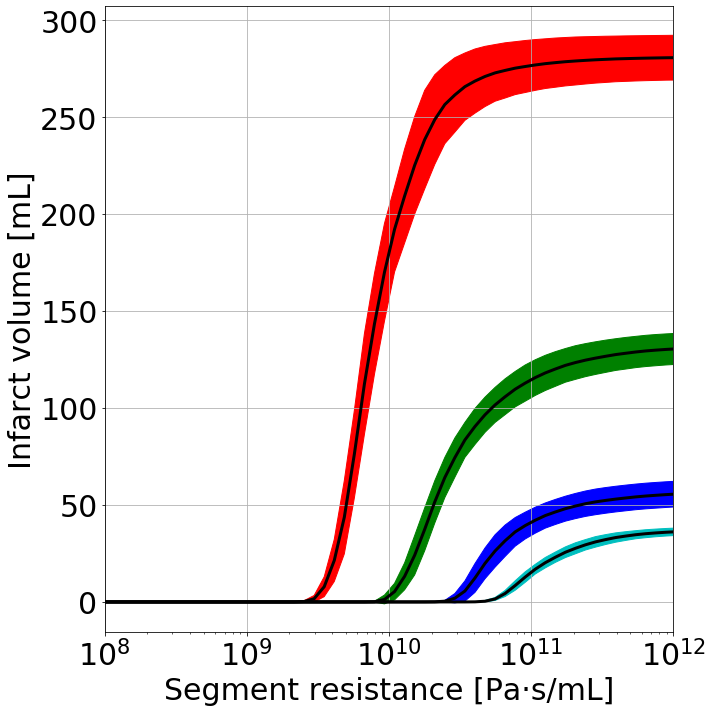

In [41]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
p=[]
for index, collateral in enumerate(collateraloptions):
    y, error = iv_mean_std[index]
    
    plt.plot(R_range, y, 'k-', linewidth=3, markersize=10)
    p1= plt.fill_between(R_range, y-error, y+error,color=colours[index],label=collateraloptions[index])
    p.append(p1)    
    
#     for length in lengthoptions:
#         Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
#         IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
#         ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
# #         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Infarct volume [mL]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')

ax.set_xlim((1e8, 1e12))  

# ax2.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax2.tick_params(labelsize=20)

# fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sInfarct_volume_interp" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

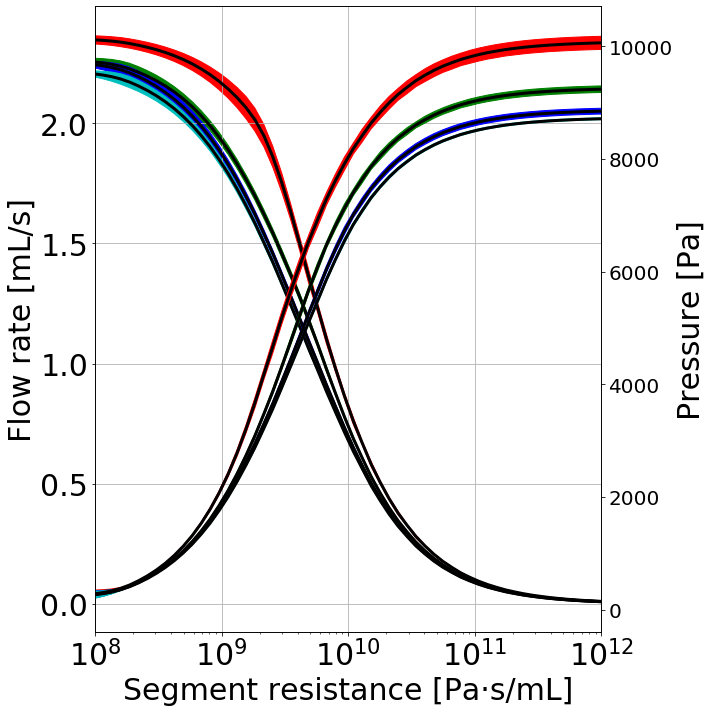

In [42]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
p=[]
for index, collateral in enumerate(collateraloptions):
    y, error = dp_mean_std[index]
    y2, error2 = q_mean_std[index]
    
    ax.plot(R_range, y2, 'k-', linewidth=3, markersize=10)
    ax.fill_between(R_range, y2-error2, y2+error2,color=colours[index],label=collateraloptions[index])

    
    ax2.plot(R_range, y, 'k-', linewidth=3, markersize=10)
    p1= ax2.fill_between(R_range, y-error, y+error,color=colours[index],label=collateraloptions[index])
    p.append(p1)    
    
#     for length in lengthoptions:
#         Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
#         IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
#         ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
# #         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
ax.set_xlim((1e8, 1e12))  

ax2.set_ylabel("Pressure [Pa]", fontsize=30)
ax2.tick_params(labelsize=20)

# fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sPressure_Flow_interp" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

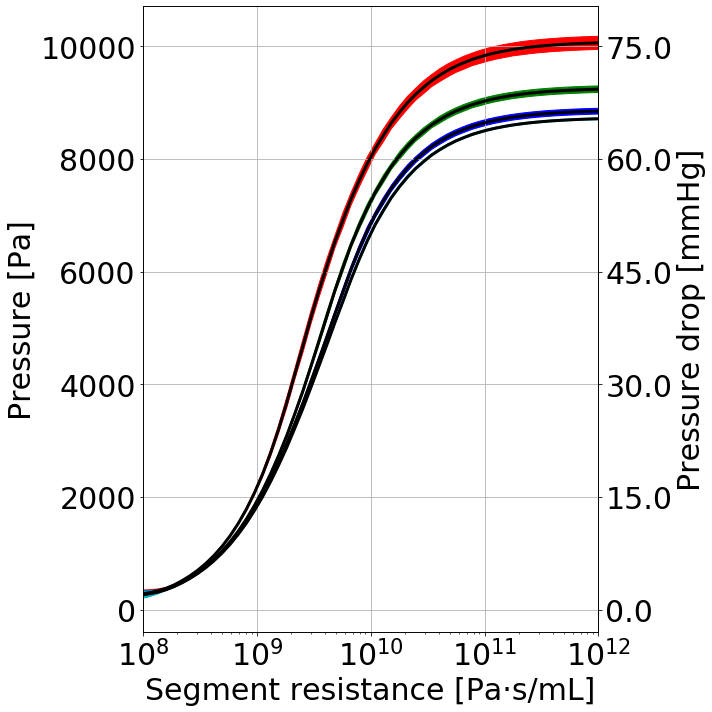

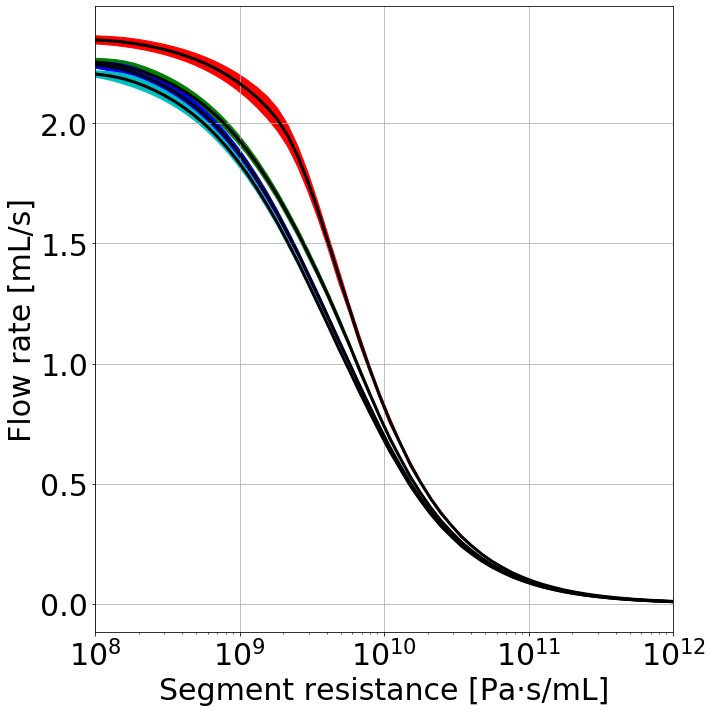

In [43]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
p=[]
for index, collateral in enumerate(collateraloptions):
    y, error = dp_mean_std[index]
    y2, error2 = q_mean_std[index]
    
#     ax.plot(R_range, y2, 'k-', linewidth=3, markersize=10)
#     ax.fill_between(R_range, y2-error2, y2+error2,color=colours[index],label=collateraloptions[index])

    
    ax.plot(R_range, y, 'k-', linewidth=3, markersize=10)
    p1= ax.fill_between(R_range, y-error, y+error,color=colours[index],label=collateraloptions[index])
    p.append(p1)    
    
#     for length in lengthoptions:
#         Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
#         IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
#         ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
# #         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
# ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax.set_ylabel("Pressure [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
ax.set_xlim((1e8, 1e12))  

# add a twin axes and set its limits so it matches the first
ax2 = ax.twinx()
ax2.set_ylabel('Pressure drop [mmHg]', fontsize=30)
ax2.set_ylim(ax.get_ylim())

# apply a function formatter
formatter = mticker.FuncFormatter(lambda x, pos: '{:.1f}'.format(x/133.322))
ax2.yaxis.set_major_formatter(formatter)
ax2.tick_params(labelsize=30)

# fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sPressure_interp" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 


fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
# ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
p=[]
for index, collateral in enumerate(collateraloptions):
    y, error = dp_mean_std[index]
    y2, error2 = q_mean_std[index]
    
    ax.plot(R_range, y2, 'k-', linewidth=3, markersize=10)
    p1= ax.fill_between(R_range, y2-error2, y2+error2,color=colours[index],label=collateraloptions[index])

    
#     ax2.plot(R_range, y, 'k-', linewidth=3, markersize=10)
#     p1= ax2.fill_between(R_range, y-error, y+error,color=colours[index],label=collateraloptions[index])
    p.append(p1)    
    
#     for length in lengthoptions:
#         Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
#         IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
#         ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
# #         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
ax.set_xlim((1e8, 1e12))  

# ax2.set_ylabel("Pressure [Pa]", fontsize=30)
# ax2.tick_params(labelsize=20)

# fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
# fig.legend(handles=p, labels=["Absent","Poor","Moderate","Good"],fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sFlow_interp" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

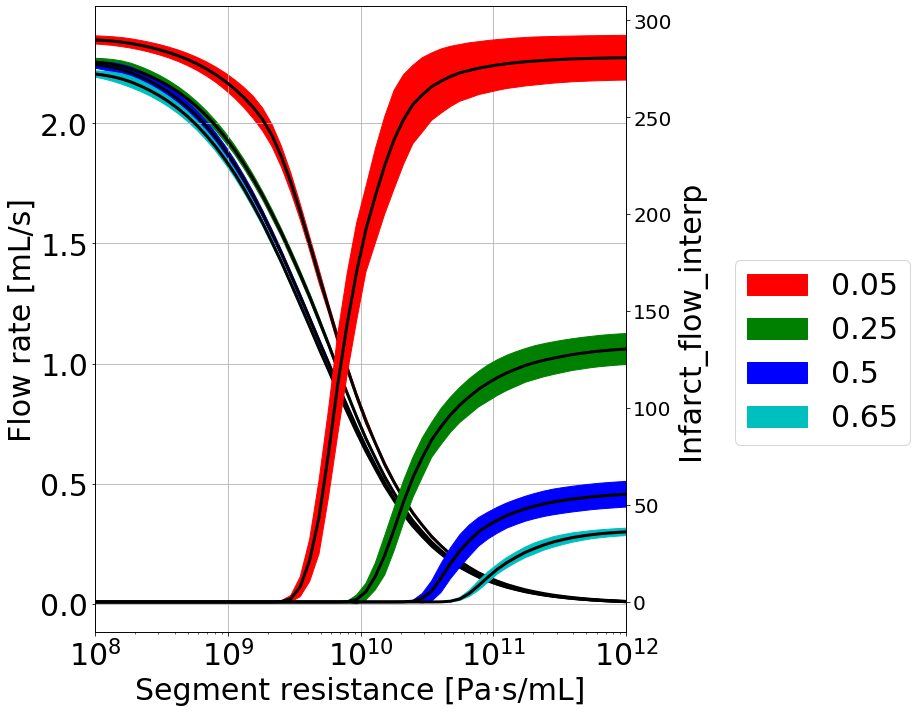

In [44]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
ax2 = ax.twinx()
colours = ["red",'green',"blue","c","black","yellow","purple"]
p=[]
for index, collateral in enumerate(collateraloptions):
    y, error = iv_mean_std[index]
    y2, error2 = q_mean_std[index]
    
    ax.plot(R_range, y2, 'k-', linewidth=3, markersize=10)
    ax.fill_between(R_range, y2-error2, y2+error2,color=colours[index],label=collateraloptions[index])

    
    ax2.plot(R_range, y, 'k-', linewidth=3, markersize=10)
    p1= ax2.fill_between(R_range, y-error, y+error,color=colours[index],label=collateraloptions[index])
    p.append(p1)    
    
#     for length in lengthoptions:
#         Resistance = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Clot resistance"][2:]
#         IV = result.loc[(result['Clot Length']==length)&(result['Collaterals']==collateral)]["Infarct"][2:]        
#         ax.plot(Resistance, IV, label=str(collateral),color=colours[index], marker='x', linewidth=3, markersize=10)
# #         ax2.plot(Permeability, flowrate, label="Flow rate [mL/s]"+str(length)+"mm:"+str(collateral),color=colours[index], marker='o', linewidth=3, markersize=10)
    

ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
ax.tick_params(labelsize=30)
ax.grid()
ax.set_xscale('log')
ax.set_xlim((1e8, 1e12))  

ax2.set_ylabel("Infarct_flow_interp", fontsize=30)
ax2.tick_params(labelsize=20)

fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
plt.tight_layout()
plt.show()
fig.savefig("%sIV_Flow_interp" % OutputFolder, bbox_inches='tight')    
# plt.clf()
# plt.cla()
# plt.close() 

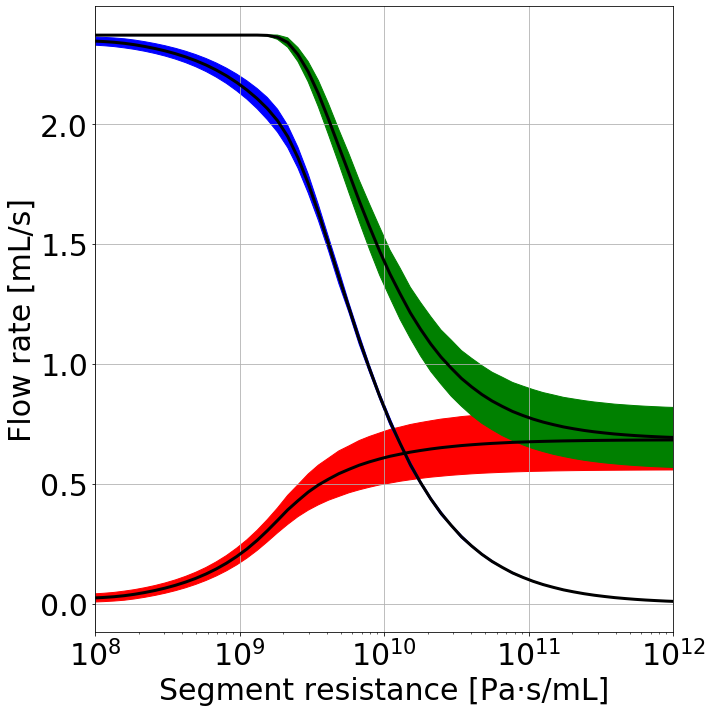

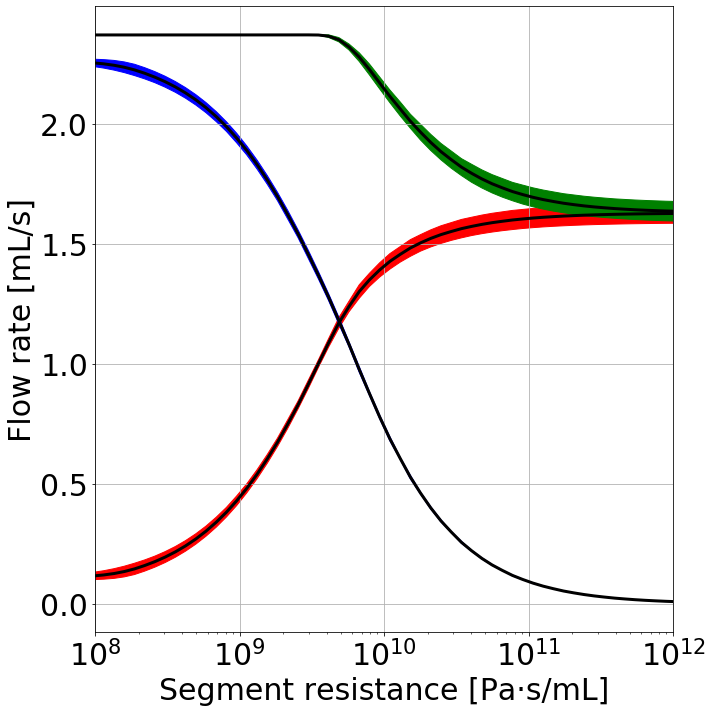

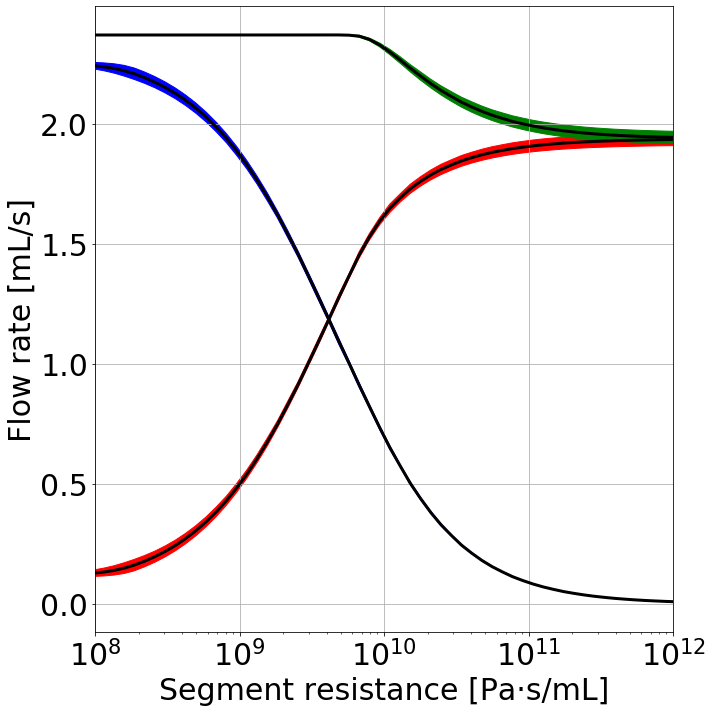

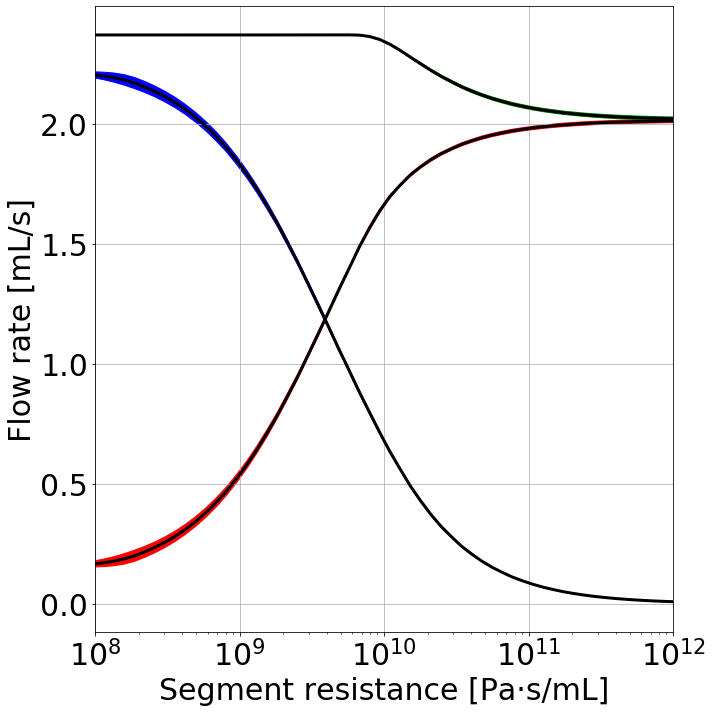

In [45]:
for index, collateral in enumerate(collateraloptions):
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = fig.add_subplot(111)
#     ax2 = ax.twinx()
    colours = ["red",'green',"blue","c","black","yellow","purple"]
    p=[]

    y, error = q_mean_std[index]
    y2, error2 = colq_mean_std[index]   
    y3, error3 = totalflow_mean_std[index]
    
    ax.plot(R_range, y2, 'k-', linewidth=3, markersize=10)
    p1=ax.fill_between(R_range, y2-error2, y2+error2,color=colours[0],label="Collaterals "+str(collateraloptions[index]))

    ax.plot(R_range, y3, 'k-', linewidth=3, markersize=10)
    p3=ax.fill_between(R_range, y3-error3, y3+error3,color=colours[1],label="Total "+str(collateraloptions[index]))
    
    ax.plot(R_range, y, 'k-', linewidth=3, markersize=10)
    p2= ax.fill_between(R_range, y-error, y+error,color=colours[2],label="Vessel "+str(collateraloptions[index]))
    p.append(p1)    
    p.append(p2)  
    p.append(p3)  

    ax.set_xlabel("Segment resistance [Pa·s/mL]", fontsize=30)
    ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    ax.set_xscale('log')
    
    ax.set_xlim((1e8, 1e12))  

#     ax2.set_ylabel("Collateral Flow rate [mL/s]", fontsize=30)
#     ax2.tick_params(labelsize=20)

#     fig.legend(handles=p,fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   
    plt.tight_layout()
    plt.show()
    fig.savefig("%sTotal_Flow_interp%s" % (OutputFolder,index), bbox_inches='tight')  
    # plt.clf()
    # plt.cla()
    # plt.close() 

# Patient Data

Use time delay, porosity and clot length from patients to estimate thrombus permeability.
Note that the porosity in the model only scales the velocity and therefore the time delay. Therefore, the time delay is normalized to the (constant) value used in the model. This avoids running the model again.
The (normalized) time delay and clot length are then used in the model to estimate the permeability and pressure drop.

## Import data

In [46]:
patient_file = "inputdata2.csv"
patient_data= pd.read_csv(patient_file, sep=',',header=0)

## Interpolate from 3d plots

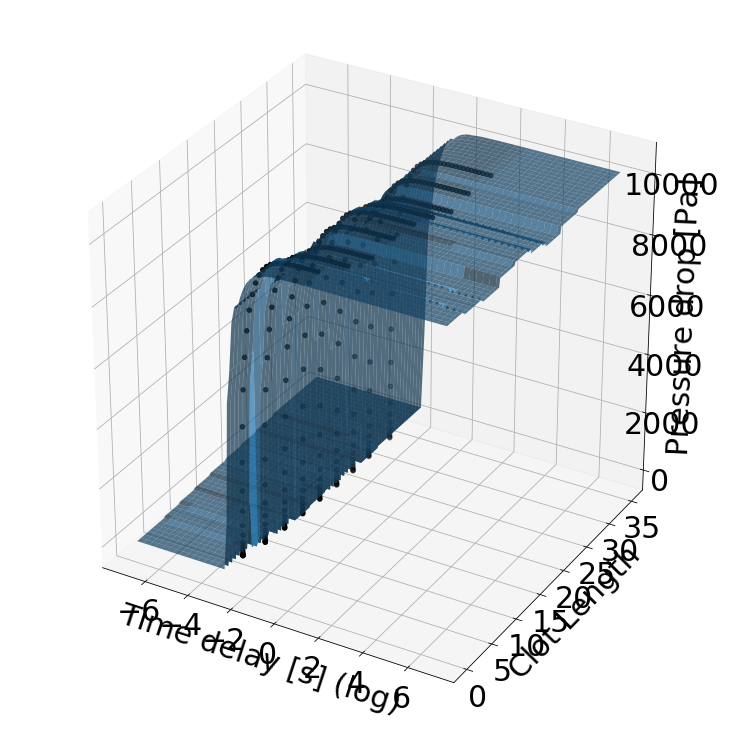

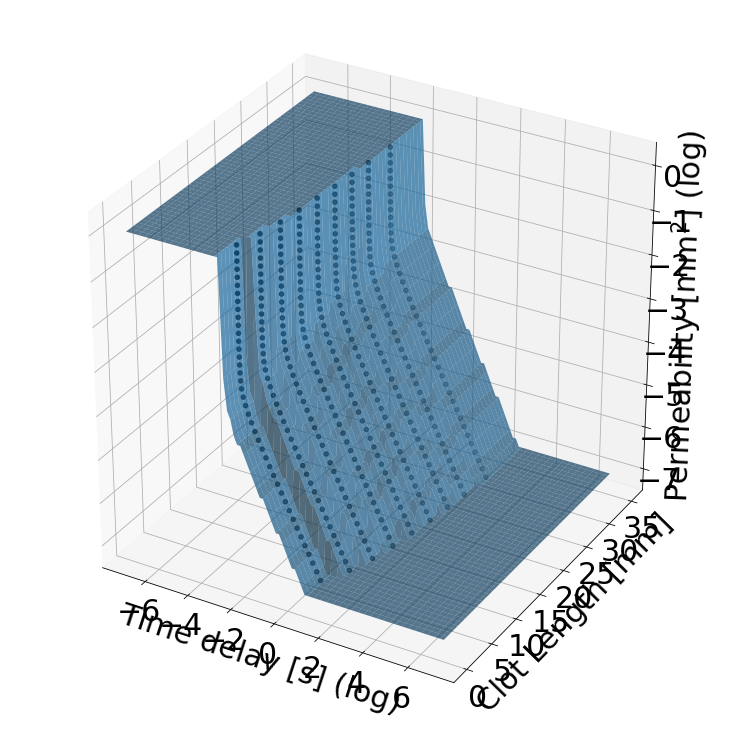

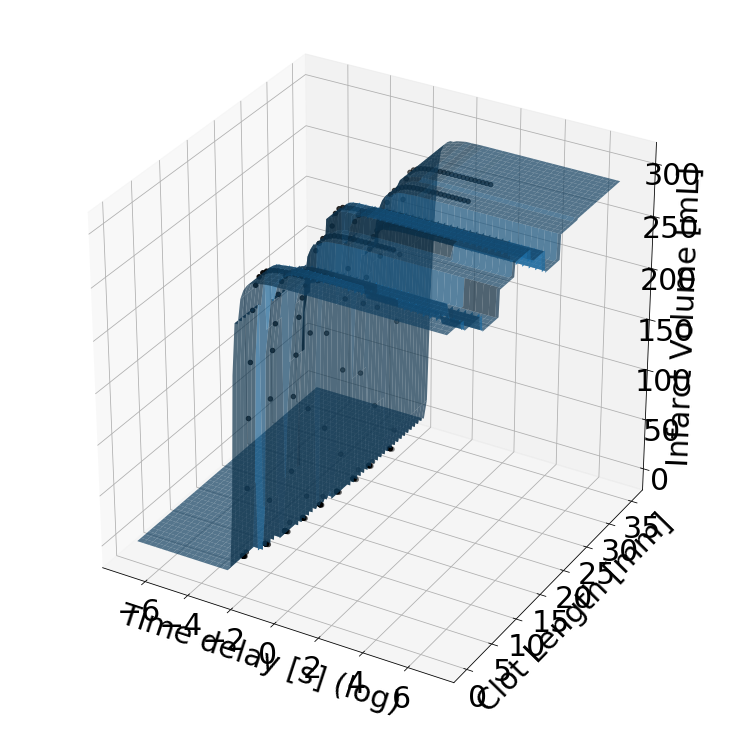

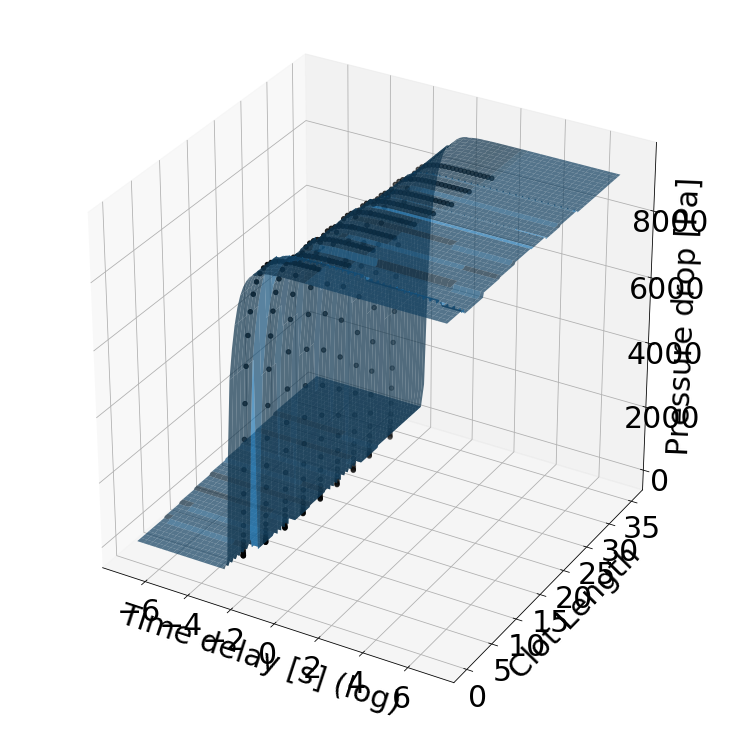

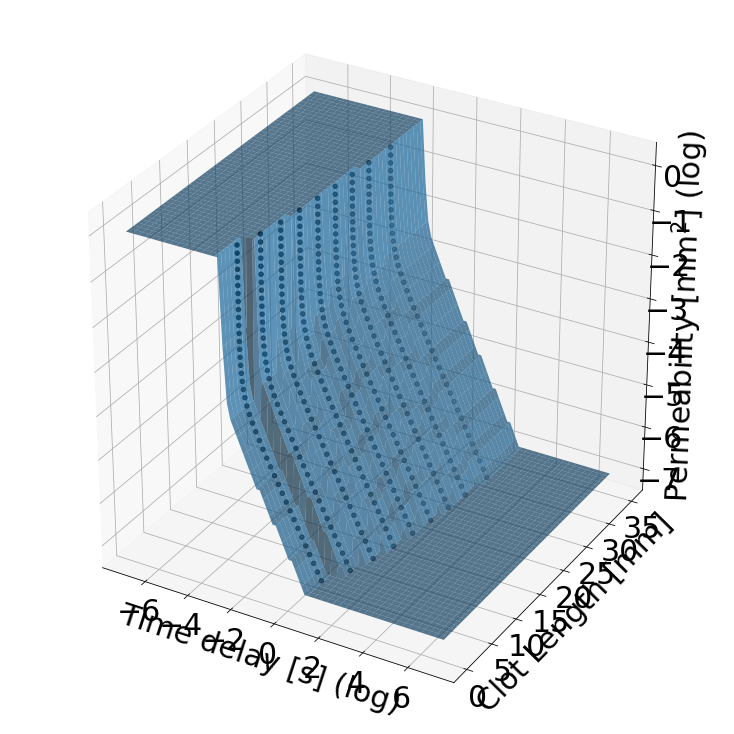

...

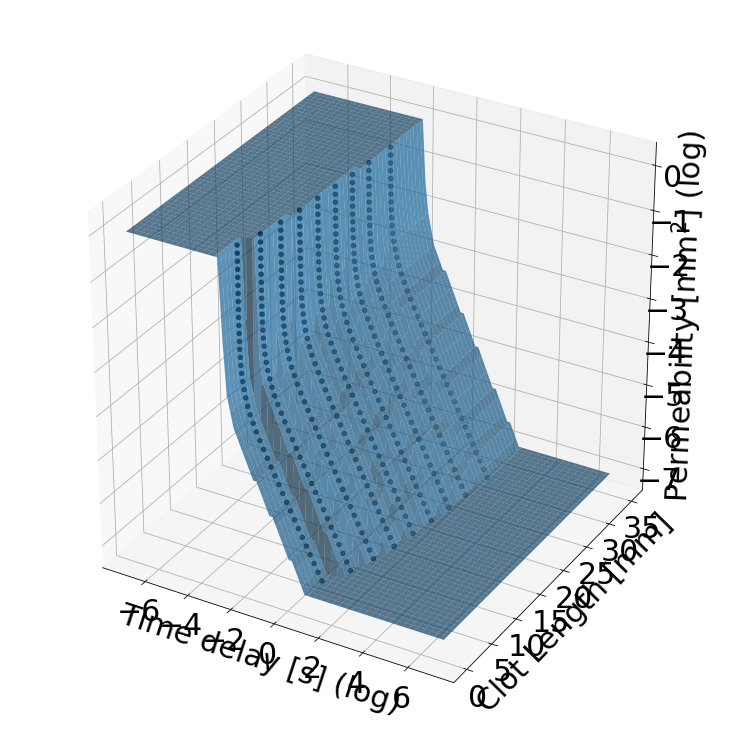

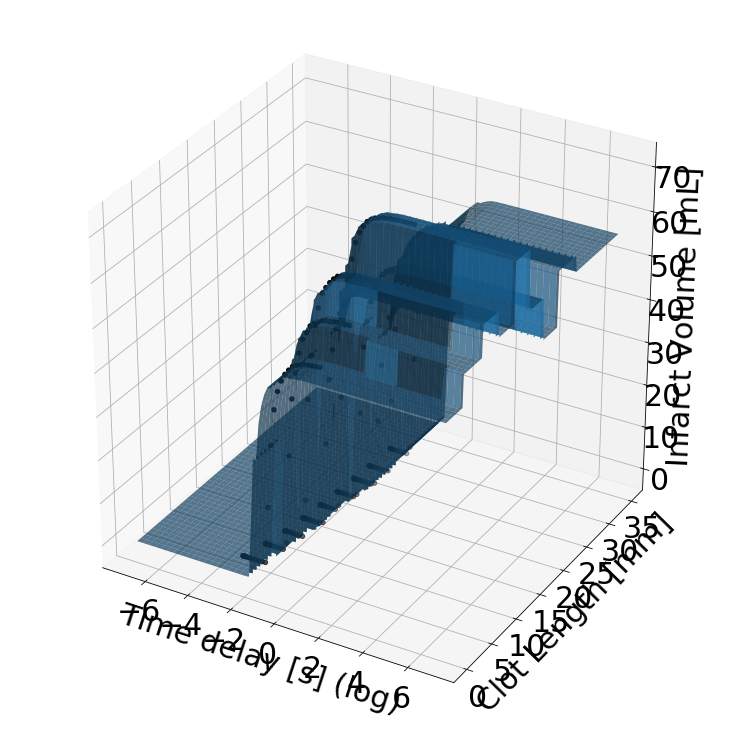

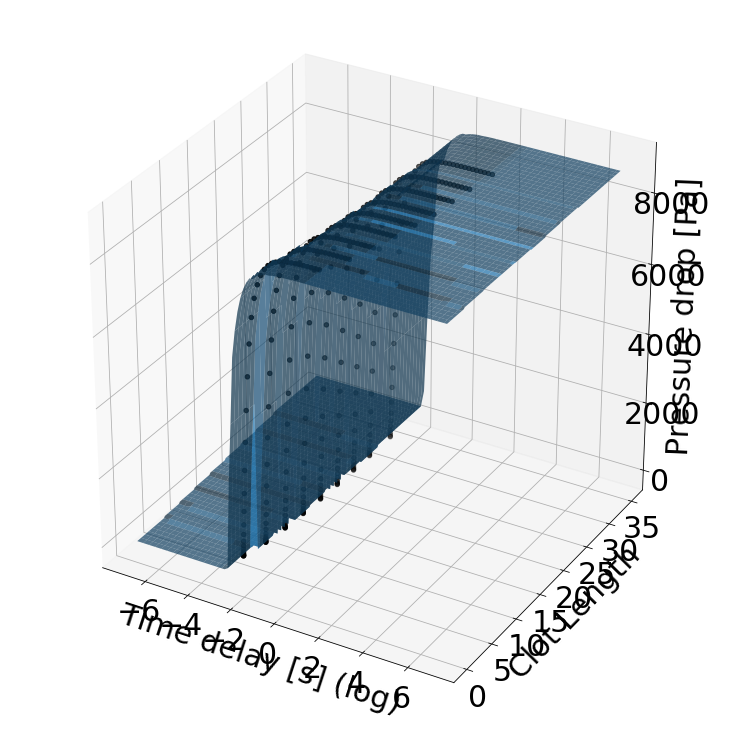

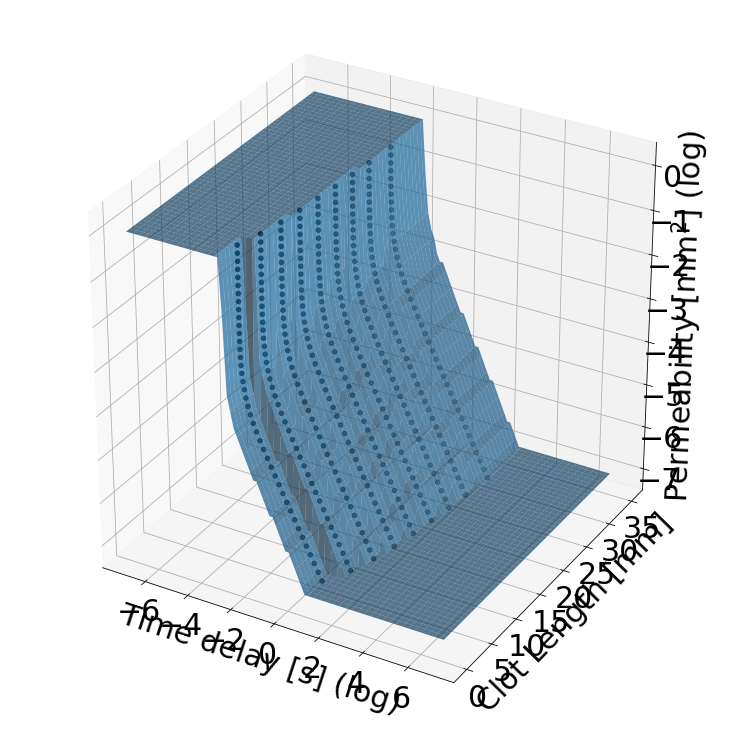

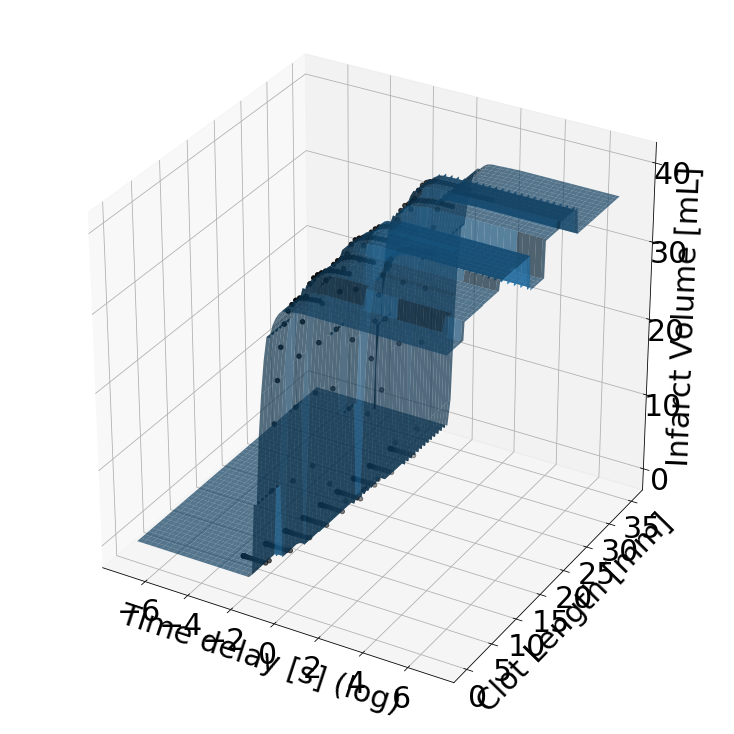

In [47]:
# normalize to same void fraction as model
patient_data["Normalised Time delay [s]"] = patient_data["Transit-time [s]"] * 0.2 / patient_data["Void fraction [-]"]

## Estimate pressure drop, permeability, infarct volume, from model

# %matplotlib notebook
# create interpolation scheme to estimate dp, k, etc
collateraloptions = np.sort(result['Collaterals'].unique())
# display(collateraloptions)
result_stroke = result.loc[(result['Type']=="Stroke")&(result['Time [s]']>0.0)]

for index,collateral in enumerate(collateraloptions):
#     collateral= 1.0
    result_stroke.loc[result_stroke['Collaterals']==collateral]

    # clot length, time delay, get dp, k
    dt = np.log10(result_stroke.loc[result_stroke['Collaterals']==collateral]["Time delay [s]"].values)
    L = result_stroke.loc[result_stroke['Collaterals']==collateral]["Clot Length"].values
    dp = result_stroke.loc[result_stroke['Collaterals']==collateral]["Pressure drop [pa]"].values
    k = np.log10(result_stroke.loc[result_stroke['Collaterals']==collateral]["Permeability [mm^2]"].values)
    IV = result_stroke.loc[result_stroke['Collaterals']==collateral]["Infarct"].values
    points = np.vstack((dt, L)).T

#     grid_x, grid_y = np.mgrid[0:20:100j, 0:22:200j]
    # length and time
    grid_x, grid_y = np.mgrid[-7:7:100j, 0:35:200j]
    grid_z0 = griddata(points, dp,  (grid_x, grid_y), method='nearest')
    grid_z1 = griddata(points, k,  (grid_x, grid_y), method='nearest')
    grid_z2 = griddata(points, IV,  (grid_x, grid_y), method='nearest')
    
    #########
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = Axes3D(fig)
    ax.plot_surface(grid_x ,grid_y, grid_z0,alpha=0.7) 
    ax.scatter(points[:,0], points[:,1], dp, color="k")
   
    ax.set_xlabel("Time delay [s] (log)", fontsize=30)
    ax.set_ylabel("Clot Length", fontsize=30)
    ax.set_zlabel("Pressure drop [Pa]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    plt.show()
    fig.savefig("%sSurface_dp_%d" % (OutputFolder,index), bbox_inches='tight')   

    ############
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = Axes3D(fig)
    ax.plot_surface(grid_x ,grid_y, grid_z1,alpha=0.7) 
    ax.scatter(points[:,0], points[:,1], k, color="k")
 
    ax.set_xlabel("Time delay [s] (log)", fontsize=30)
    ax.set_ylabel("Clot Length [mm]", fontsize=30)
    ax.set_zlabel("Permeability [mm$^2$] (log)", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    plt.show()
    fig.savefig("%sSurface_k_%d" % (OutputFolder,index), bbox_inches='tight')   
    
    ############
    fig = plt.figure()
    fig.set_size_inches(10,10)
    ax = Axes3D(fig)
    ax.plot_surface(grid_x ,grid_y, grid_z2,alpha=0.7) 
    ax.scatter(points[:,0], points[:,1], IV, color="k")
 
    ax.set_xlabel("Time delay [s] (log)", fontsize=30)
    ax.set_ylabel("Clot Length [mm]", fontsize=30)
    ax.set_zlabel("Infarct Volume [mL]", fontsize=30)
    ax.tick_params(labelsize=30)
    ax.grid()
    plt.show()
    fig.savefig("%sSurface_IV_%d" % (OutputFolder,index), bbox_inches='tight')   
    
    
    ###########
    patients_dt = np.log10(patient_data["Normalised Time delay [s]"].values) 
    patients_L = patient_data["Thrombus length [cm]"].values * 10
    points_patient = np.vstack((patients_dt, patients_L)).T

    grid_p0 = griddata(points, dp, points_patient, method='nearest')
    grid_p1 = griddata(points, k, points_patient, method='nearest')
    grid_p2 = griddata(points, IV, points_patient, method='nearest')
    patient_data[str(collateral)+"_dp"] = grid_p0
    patient_data[str(collateral)+"_k"] = 10 **grid_p1
    patient_data[str(collateral)+"_IV"] = grid_p2
    
# #     plt.hist(x=grid_z0, bins='auto', alpha=0.7, rwidth=0.85)
#     plt.hist(x=np.log10(grid_z1), bins='auto', label=str(collateral), alpha=0.7, rwidth=0.85)
#     plt.legend(fontsize=30,loc='center left', bbox_to_anchor=(1, 0.5))   

## Interpolate from resistances

In [48]:
# determine flow rate -> get resistance?
patient_clot_res = 1
rma=np.pi*1.43*1.43 # area in mm^2
mu=0.0035
patient_data["Flow rate [mL]_p"] = patient_data["Void fraction [-]"]*rma*1e-3 * patient_data["Thrombus length [cm]"]*10/patient_data["Transit-time [s]"]
patient_data["Flow rate [mL]"] = 0.2*rma*1e-3 * patient_data["Thrombus length [cm]"]*10/patient_data["Normalised Time delay [s]"]

for index, collateral in enumerate(collateraloptions):
    patient_data["Resistance"+str(collateral)] = mean_interp_RfromQ[index](patient_data["Flow rate [mL]"].tolist())
    patient_data["Pressure"+str(collateral)] = mean_interp_dpfromR[index](patient_data["Resistance"+str(collateral)].tolist())
    patient_data["IV"+str(collateral)] = mean_interp_IVfromR[index](patient_data["Resistance"+str(collateral)].tolist())
    patient_data["Permeability"+str(collateral)] = 1e10* (mu*patient_data["Thrombus length [cm]"])/(rma*patient_data["Resistance"+str(collateral)])
#     print(patient_data["Permeability"+str(collateral)]/patient_data[str(collateral)+"_k"] )
    

In [49]:
patient_data

,INSIST,Transit-time [s],Thrombus length [cm],Void fraction [-],Normalised Time delay [s],0.05_dp,0.05_k,0.05_IV,0.25_dp,0.25_k,...,IV0.25,Permeability0.25,Resistance0.5,Pressure0.5,IV0.5,Permeability0.5,Resistance0.65,Pressure0.65,IV0.65,Permeability0.65
0,I0016,0.13,1.06,0.26,0.100000,9818.719339,9.440609e-05,280.283742,8965.067151,9.440609e-05,...,106.435099,8.540816e-05,6.455247e+10,8518.788002,30.895425,8.946210e-05,6.347904e+10,8367.911669,3.690337,9.097490e-05
1,I0043,0.13,1.09,0.67,0.038806,9076.027164,3.162278e-04,264.623591,8258.687152,3.162278e-04,...,60.649888,2.502161e-04,2.251461e+10,7897.891372,0.190456,2.637595e-04,2.197468e+10,7718.618010,0.000000,2.702402e-04
2,I0044,0.38,2.34,0.23,0.330435,9854.088159,1.412538e-04,280.967271,9029.147161,1.412538e-04,...,114.864187,1.243965e-04,9.814603e+10,8638.526085,40.586796,1.298940e-04,9.645326e+10,8493.091403,14.168816,1.321737e-04
3,I0042,0.40,0.64,0.46,0.173913,9917.511732,1.258925e-05,274.254034,9006.945884,1.883649e-05,...,123.181216,1.746884e-05,1.911911e+11,8752.890248,48.820996,1.823721e-05,1.880040e+11,8612.691181,26.503276,1.854638e-05
4,I0001,0.53,0.69,0.27,0.392593,9970.864937,5.623413e-06,275.364770,9081.607129,8.413951e-06,...,127.837078,8.930828e-06,4.008944e+11,8816.935930,53.088650,9.377027e-06,3.937614e+11,8679.751175,33.193384,9.546892e-06
5,I0012,0.53,0.89,0.14,0.757143,9866.363150,8.413951e-06,259.936531,9229.458193,8.413951e-06,...,129.377170,7.711952e-06,6.040293e+11,8836.247235,54.447526,8.027459e-06,5.948958e+11,8699.966720,34.931907,8.150705e-06
6,I0020,0.74,1.86,0.14,1.057143,10054.914811,1.883649e-05,284.397125,9249.926422,2.818383e-05,...,127.832240,2.410266e-05,4.003790e+11,8816.872447,53.084329,2.530974e-05,3.934071e+11,8679.684533,33.187142,2.575828e-05
7,I0018,0.79,3.09,0.06,2.633333,10162.652292,1.883649e-05,287.387567,9181.640085,1.883649e-05,...,129.382728,2.673356e-05,6.050523e+11,8836.315286,54.452358,2.782349e-05,5.959350e+11,8700.038146,34.937533,2.824917e-05
8,I0038,0.81,1.10,0.06,2.700000,10159.764164,3.758374e-06,284.983007,9281.917496,3.758374e-06,...,131.303766,3.279119e-06,1.746389e+12,8861.671600,56.263392,3.431609e-06,1.716647e+12,8726.622029,36.833622,3.491065e-06
9,I0049,0.89,1.97,0.26,0.684615,9818.149064,4.216965e-05,261.315796,9152.918053,4.216965e-05,...,125.051024,4.193249e-05,2.438611e+11,8779.667739,50.700112,4.401186e-05,2.400946e+11,8640.697661,29.377028,4.470231e-05


## Statistics patient data

In [50]:
patient_data_statistics=patient_data.describe()
display(patient_data_statistics)

,Transit-time [s],Thrombus length [cm],Void fraction [-],Normalised Time delay [s],0.05_dp,0.05_k,0.05_IV,0.25_dp,0.25_k,0.25_IV,...,IV0.25,Permeability0.25,Resistance0.5,Pressure0.5,IV0.5,Permeability0.5,Resistance0.65,Pressure0.65,IV0.65,Permeability0.65
count,44.000000,44.000000,44.000000,44.000000,44.000000,4.400000e+01,44.000000,44.000000,4.400000e+01,44.000000,...,44.000000,4.400000e+01,4.400000e+01,44.000000,44.000000,4.400000e+01,4.400000e+01,44.000000,44.000000,4.400000e+01
mean,2.971136,1.553409,0.207955,4.577983,10036.996062,2.105671e-05,280.354203,9208.497523,2.212315e-05,127.732647,...,127.813387,1.987506e-05,2.567603e+12,8814.582590,53.199617,2.080608e-05,2.527827e+12,8677.341908,33.630901,2.119273e-05
std,2.328396,0.798093,0.127891,5.431691,200.769283,5.230519e-05,12.275370,171.279273,5.251543e-05,15.360449,...,11.399716,4.269857e-05,3.192493e+12,155.584274,9.426316,4.490478e-05,3.141635e+12,162.735076,8.140809,4.592088e-05
min,0.130000,0.350000,0.040000,0.038806,9076.027164,1.000000e-07,259.936531,8258.687152,1.000000e-07,51.521041,...,60.649888,1.762675e-07,2.251461e+10,7897.891372,0.190456,1.841718e-07,2.197468e+10,7718.618010,0.000000,1.868172e-07
25%,1.020000,0.972500,0.120000,1.249000,9900.358220,1.678804e-06,271.846424,9181.387606,1.678804e-06,125.748081,...,129.336305,1.543378e-06,5.965082e+11,8835.746900,54.411998,1.607050e-06,5.872551e+11,8699.441576,34.890544,1.631358e-06
50%,2.455000,1.530000,0.180000,2.576667,10098.715976,5.623413e-06,285.019625,9256.562682,5.623413e-06,130.560251,...,131.194767,5.421704e-06,1.577695e+12,8860.209121,56.168809,5.664317e-06,1.552678e+12,8725.077905,36.719322,5.758773e-06
75%,4.052500,2.052500,0.260000,6.471667,10165.437910,1.883649e-05,286.661317,9293.653061,1.883649e-05,137.346723,...,131.765365,1.983260e-05,3.191463e+12,8867.765723,56.687597,2.072243e-05,3.147448e+12,8733.012225,37.258264,2.102317e-05
max,10.910000,3.490000,0.670000,25.166667,10258.940438,3.162278e-04,298.250805,9342.647535,3.162278e-04,144.066063,...,132.181174,2.502161e-04,1.482266e+13,8873.497014,57.092451,2.637595e-04,1.457159e+13,8738.994308,37.588430,2.702402e-04


In [51]:
# fig = plt.figure()
# fig.set_size_inches(10,10)
# ax = fig.add_subplot(111)

# Pressuredrop0 = patient_data['0.0_dp']
# Pressuredrop005 = patient_data['0.05_dp']
# Pressuredrop01 = patient_data['0.1_dp']
# Pressuredrop03 = patient_data['0.3_dp']
# Pressuredrop05 = patient_data['0.5_dp']
# Pressuredrop1 = patient_data['1.0_dp']
# transit_time = patient_data['Transit-time [s]']

# # Resistance_Normalized = df2['Normalized Clot resistance Calculation']
# # timedelay = df2['Normalised Time delay [s]']

# ax.plot(transit_time, Pressuredrop0, 'o', label="0", color='black', markersize=10)
# ax.plot(transit_time, Pressuredrop005, 'o', label=".05", color='green', markersize=10)
# ax.plot(transit_time, Pressuredrop01, 'o', label=".1", color='blue', markersize=10)
# ax.plot(transit_time, Pressuredrop03, 'o', label=".3", color='red', markersize=10)
# ax.plot(transit_time, Pressuredrop05, 'o', label=".5", color='m', markersize=10)
# ax.plot(transit_time, Pressuredrop1, 'o', label="1", color='y', markersize=10)

# # ax.plot(timedelay, Resistance,'o', label="normalized", color='blue', markersize=10)

# ax.set_xlabel("Time delay [s]", fontsize=30)
# ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
# ax.tick_params(labelsize=30)
# ax.grid()
# # ax.set_yscale('log')
# # ax.set_xscale('log')
# plt.legend(loc="upper right", fontsize=30)
 
# plt.tight_layout()
# plt.show()
# fig.savefig("pressuredrop_timedelay", bbox_inches='tight')   

In [52]:
# fig = plt.figure()
# fig.set_size_inches(10,10)
# ax = fig.add_subplot(111)

# permeability0 = patient_data['0.0_k']
# permeability005 = patient_data['0.05_k']
# permeability01 = patient_data['0.1_k']
# permeability03 = patient_data['0.3_k']
# permeability05 = patient_data['0.5_k']
# permeability1 = patient_data['1.0_k']
# transit_time = patient_data['Transit-time [s]']

# # Resistance_Normalized = df2['Normalized Clot resistance Calculation']
# # timedelay = df2['Normalised Time delay [s]']

# ax.plot(transit_time, permeability0, 'o', label="0", color='black', markersize=10)
# ax.plot(transit_time, permeability005, 'o', label=".05", color='green', markersize=10)
# ax.plot(transit_time, permeability01, 'o', label=".1", color='blue', markersize=10)
# ax.plot(transit_time, permeability03, 'o', label=".3", color='red', markersize=10)
# ax.plot(transit_time, permeability05, 'o', label=".5", color='m', markersize=10)
# ax.plot(transit_time, permeability1, 'o', label="1", color='y', markersize=10)

# # ax.plot(timedelay, Resistance,'o', label="normalized", color='blue', markersize=10)

# ax.set_xlabel("Time delay [s]", fontsize=30)
# ax.set_ylabel("Permeability", fontsize=30)
# ax.tick_params(labelsize=30)
# ax.grid()
# # ax.set_yscale('log')
# # ax.set_xscale('log')
# plt.legend(loc="upper right", fontsize=30)
 
# plt.tight_layout()
# plt.show()
# fig.savefig("permeability_timedelay", bbox_inches='tight')   

## Boxplots (patient input)

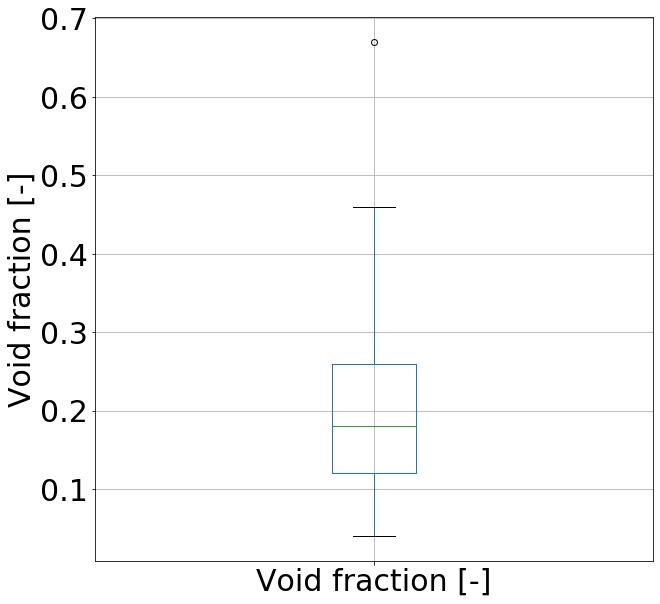

In [53]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
patient_data.boxplot(column=['Void fraction [-]'],fontsize=30)
ax.set_ylabel("Void fraction [-]", fontsize=30)
fig.savefig(OutputFolder+"patient_void-fraction", bbox_inches='tight')   

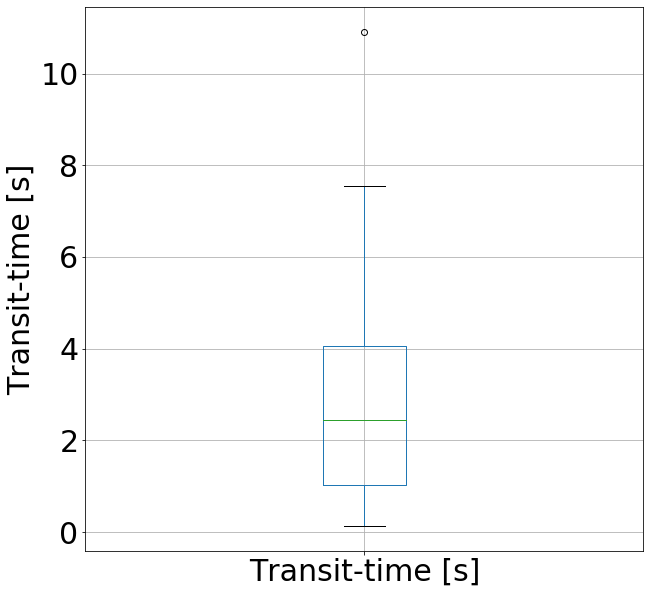

In [54]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
patient_data.boxplot(column=['Transit-time [s]'],fontsize=30)
ax.set_ylabel("Transit-time [s]", fontsize=30)
fig.savefig(OutputFolder+"patient_Transit-time", bbox_inches='tight')   

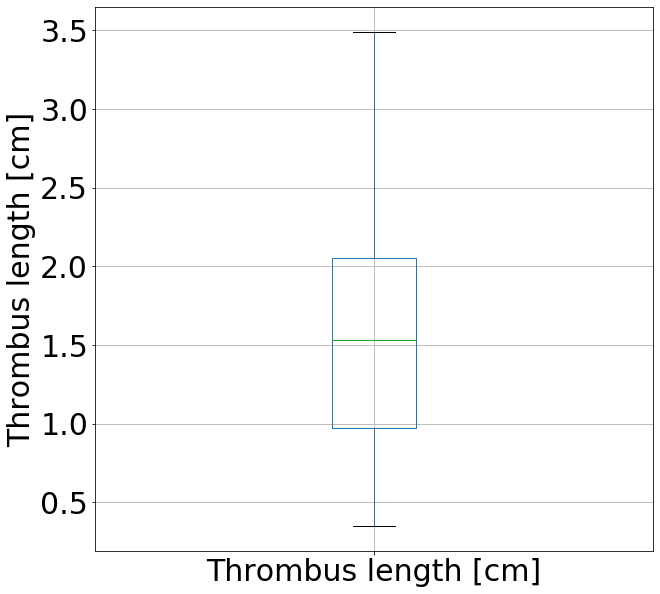

In [55]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
patient_data.boxplot(column=['Thrombus length [cm]'],fontsize=30)
ax.set_ylabel("Thrombus length [cm]", fontsize=30)
fig.savefig(OutputFolder+"patient_length", bbox_inches='tight')   

## Boxplots (patient estimates)

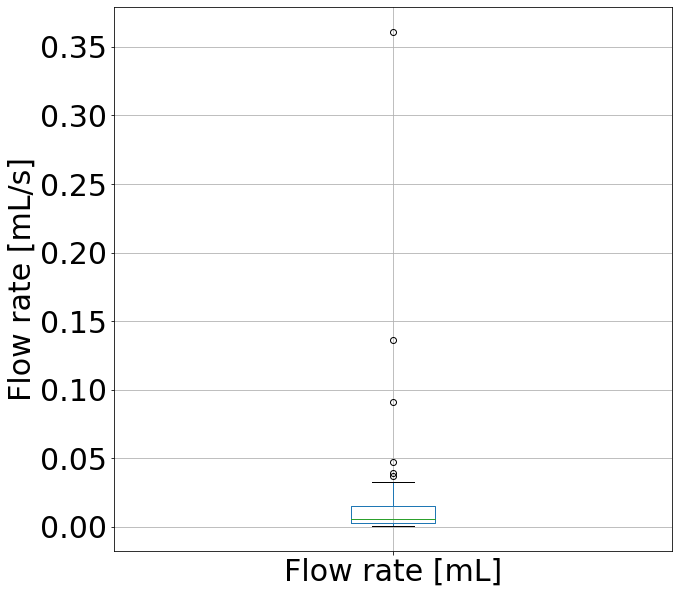

In [56]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
patient_data.boxplot(column=['Flow rate [mL]'],fontsize=30)
ax.set_ylabel("Flow rate [mL/s]", fontsize=30)
# ax.set_yscale('log')
fig.savefig(OutputFolder+"patient_flow-rate", bbox_inches='tight')   

## Boxplots from 3d interp

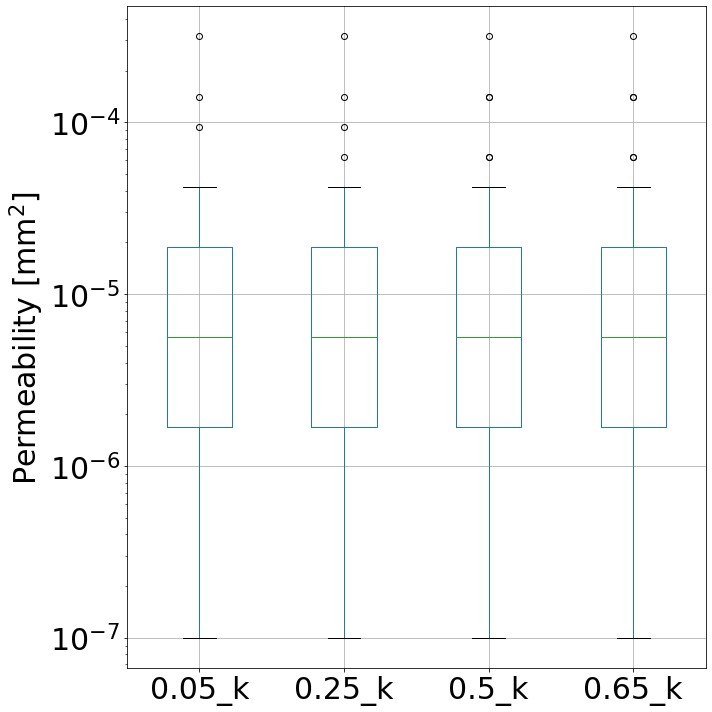

In [57]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

patient_data.boxplot(column=['0.05_k','0.25_k','0.5_k','0.65_k'])
# patient_data.boxplot(column=['0.1_k','0.3_k','0.5_k','0.8_k','Permeability0.1','Permeability0.3','Permeability0.5','Permeability0.8'])

ax.set_ylabel("Permeability [mm$^2$]", fontsize=30)
ax.tick_params(labelsize=30)
ax.set_yscale('log')

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_permeability_boxplot" % (OutputFolder), bbox_inches='tight')   

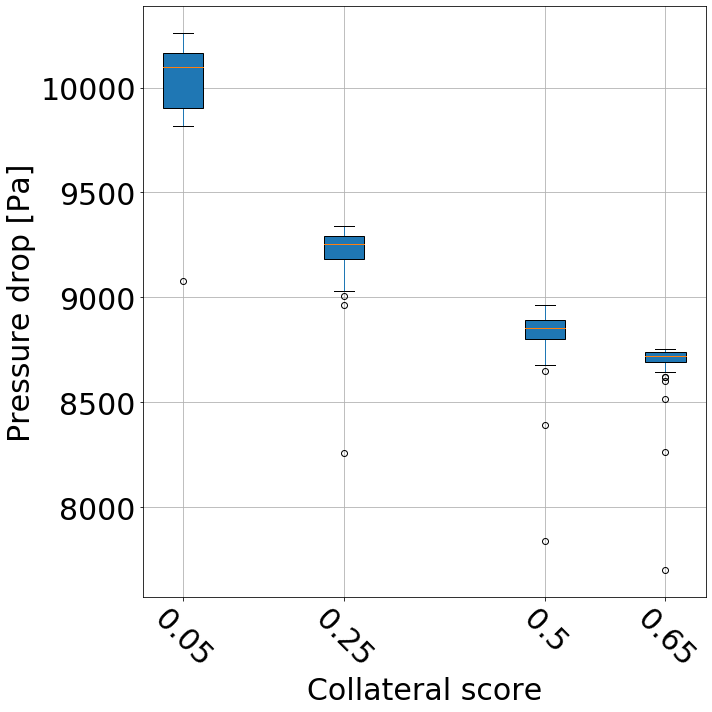

In [58]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['0.05_dp','0.25_dp','0.5_dp','0.65_dp']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
# ax.set_yscale('log')
ax.grid()
plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_pressure" % (OutputFolder), bbox_inches='tight')   

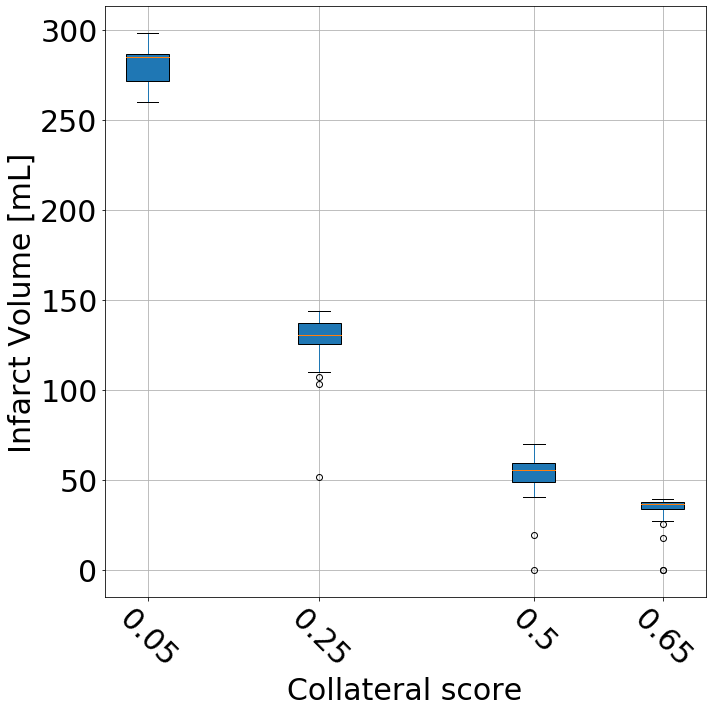

In [59]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['0.05_IV','0.25_IV','0.5_IV','0.65_IV']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Infarct Volume [mL]", fontsize=30)
ax.tick_params(labelsize=30)
# ax.set_yscale('log')
ax.grid()

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_infarct" % (OutputFolder), bbox_inches='tight')   

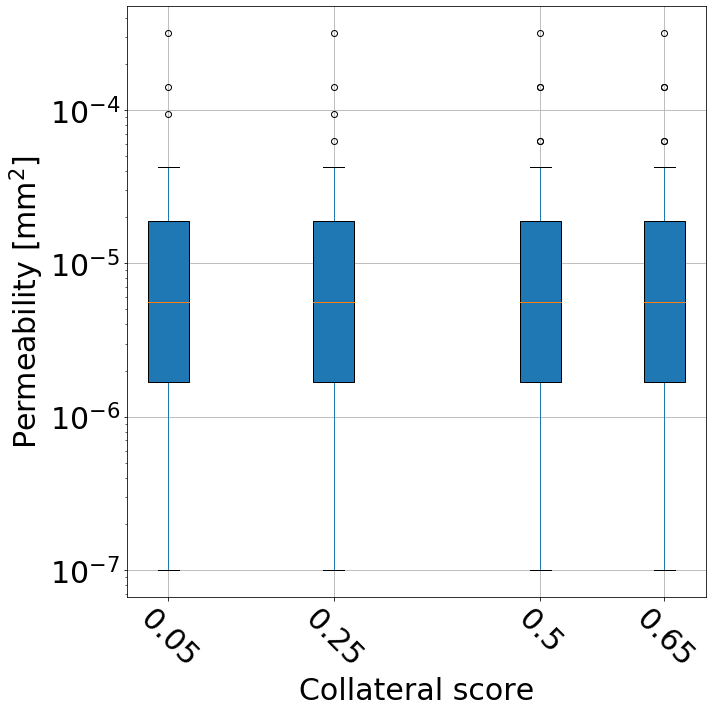

In [60]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['0.05_k','0.25_k','0.5_k','0.65_k']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Permeability [mm$^2$]", fontsize=30)
ax.tick_params(labelsize=30)
ax.set_yscale('log')
ax.grid()

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_permeability" % (OutputFolder), bbox_inches='tight')   

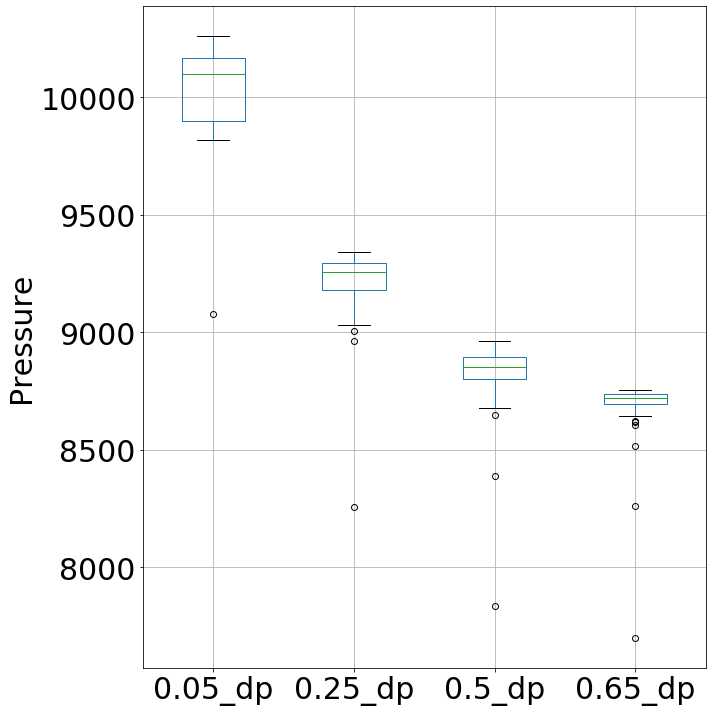

In [61]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)
patient_data.boxplot(column=['0.05_dp','0.25_dp','0.5_dp','0.65_dp'])
# patient_data.boxplot(column=['0.1_dp','0.3_dp','0.5_dp','0.8_dp','Pressure0.1','Pressure0.3','Pressure0.5','Pressure0.8'])


ax.set_ylabel("Pressure", fontsize=30)
ax.tick_params(labelsize=30)

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_pressure_boxplot" % (OutputFolder), bbox_inches='tight')   

## Boxplots from resistance interp

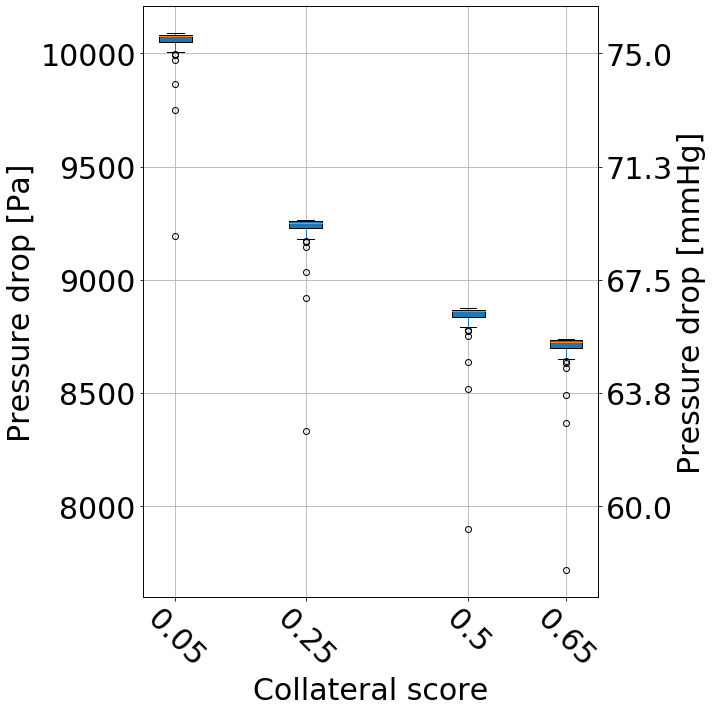

In [62]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['Pressure0.05','Pressure0.25','Pressure0.5','Pressure0.65']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Pressure drop [Pa]", fontsize=30)
ax.tick_params(labelsize=30)
# ax.set_yscale('log')

ax2 = ax.twinx()
ax2.set_ylabel('Pressure drop [mmHg]', fontsize=30)
ax2.set_ylim(ax.get_ylim())

# apply a function formatter
formatter = mticker.FuncFormatter(lambda x, pos: '{:.1f}'.format(x/133.322))
ax2.yaxis.set_major_formatter(formatter)   
ax2.tick_params(labelsize=30)


ax.grid()
plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_pressure_interp" % (OutputFolder), bbox_inches='tight')   

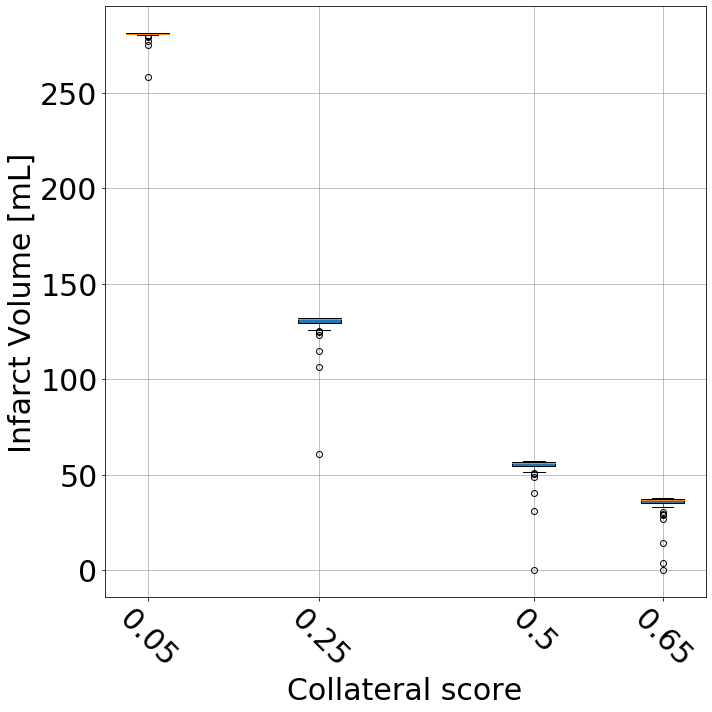

In [63]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['IV0.05','IV0.25','IV0.5','IV0.65']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Infarct Volume [mL]", fontsize=30)
ax.tick_params(labelsize=30)
# ax.set_yscale('log')
ax.grid()

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_infarct_interp" % (OutputFolder), bbox_inches='tight')   

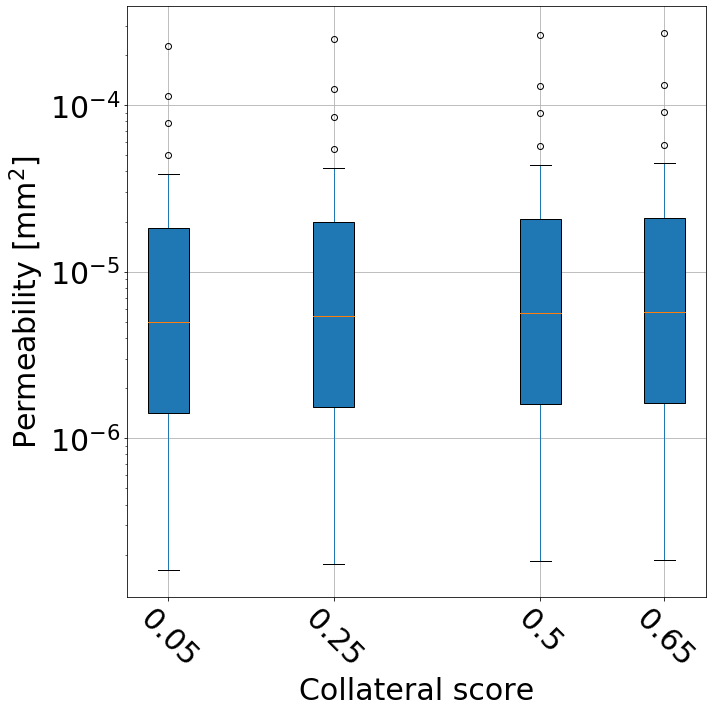

In [64]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['Permeability0.05','Permeability0.25','Permeability0.5','Permeability0.65']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Permeability [mm$^2$]", fontsize=30)
ax.tick_params(labelsize=30)
ax.set_yscale('log')
ax.grid()

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_permeability_interp" % (OutputFolder), bbox_inches='tight')   

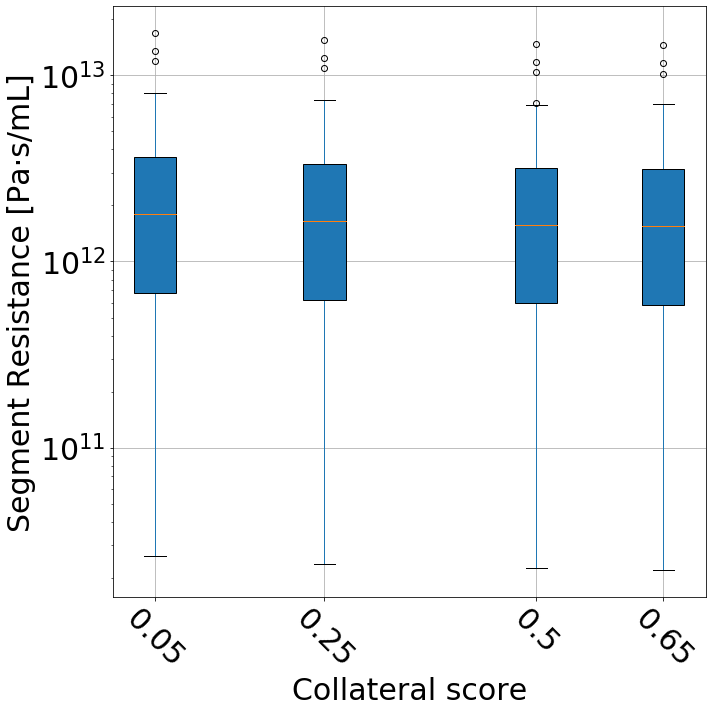

In [65]:
fig = plt.figure()
fig.set_size_inches(10,10)
ax = fig.add_subplot(111)

col1=[0.05,0.25,0.5,0.65]
col=[c*10 for c in col1]
# for c in col:
#     cstring = str(c)+"_k"
#     permeability = patient_data[cstring].values
#     collateral = c * np.ones(len(permeability))
    
#     ax.plot(collateral, permeability, marker='x', linestyle="none", linewidth=3, markersize=10)

# patient_data.boxplot(column=['0.0_k','0.05_k','0.1_k','0.3_k','0.5_k','1.0_k'])
column=['Resistance0.05','Resistance0.25','Resistance0.5','Resistance0.65']
data=patient_data[column].values
ax.boxplot(data,positions=col,
           showcaps=True, 
           whiskerprops={'color' : 'tab:blue'}, 
           patch_artist=True           
          )
plt.xticks(col, col1,rotation=-45)

ax.set_xlabel("Collateral score", fontsize=30)
ax.set_ylabel("Segment Resistance [Pa·s/mL]", fontsize=30)
ax.tick_params(labelsize=30)
ax.set_yscale('log')
ax.grid()

plt.tight_layout()
plt.show()
fig.savefig("%sPatient_estimate_resistance_interp" % (OutputFolder), bbox_inches='tight')   

## Histograms

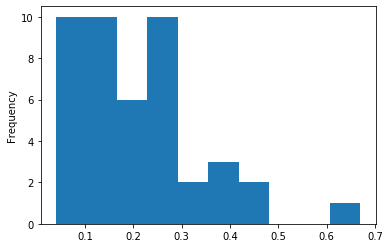

In [66]:
ax = patient_data['Void fraction [-]'].plot.hist()

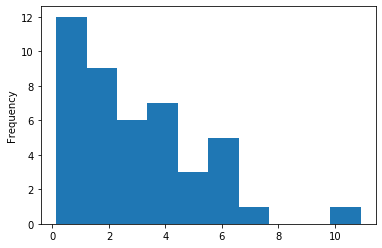

In [67]:
ax = patient_data['Transit-time [s]'].plot.hist()

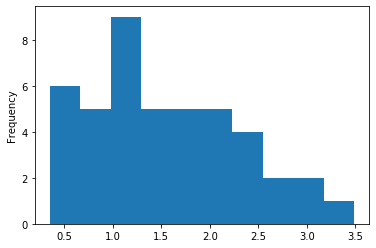

In [68]:
ax = patient_data['Thrombus length [cm]'].plot.hist()

## Export data

In [69]:
patient_data.to_csv(OutputFolder+"result_patient.csv")
patient_data_statistics.to_csv(OutputFolder+"patient_data_statistics.csv")

# treatment time effect?

In [70]:
patients = 100
import random
res = np.array([random.randrange(120, 300, 1) for i in range(100)])/60
np.median(res)

Ischemia_thresholds =100- 60/(1+np.exp(-2*(res-2)))
Ischemia_thresholds
# does not seem like it makes a lot of difference?
# effect of tissue death on flow might be an important factor?

array([59.46782062, 40.55895756, 40.28828517, 43.22956977, 54.2474817 ,
       45.46737766, 40.70412903, 54.98439366, 43.43945055, 44.14830522,
       43.12921378, 44.5514908 , 61.26062163, 42.93728102, 40.94658831,
       40.16945796, 40.80321507, 55.36225052, 69.00037021, 40.32917793,
       40.63783461, 40.47382501, 43.22956977, 47.80650846, 42.27582523,
       50.65039016, 40.26977639, 40.68130706, 41.04440896, 40.16945796,
       45.63528976, 43.22956977, 58.60153113, 58.60153113, 44.5514908 ,
       64.56080304, 45.63528976, 58.60153113, 40.97814996, 58.17644296,
       40.94658831, 49.00970238, 40.19354992, 56.53272427, 40.65921656,
       40.77722365, 40.24420826, 40.42905704, 43.54913512, 40.34027218,
       41.19041834, 46.54580927, 46.74274656, 40.8864419 , 66.02353635,
       42.84555239, 66.51579365, 41.40127099, 40.27887799, 52.18953583,
       48.0356733 , 53.88851299, 64.56080304, 44.5514908 , 40.68130706,
       50.07889689, 42.00121674, 40.24420826, 42.42637389, 41.35

In [71]:
#todo interpolate
for randon_threshold in res:
    estimated_infract = infarct_df[infarct_df["Threshold"] == randon_threshold]
    

In [72]:
estimated_infract

,Collaterals,Threshold,Perm,Infarct,Sim
